#### Preliminary imports

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from matplotlib.pyplot import figure
import seaborn as sns
from datetime import datetime
from datetime import timedelta
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_absolute_error
import tensorflow as tf
from tensorflow import keras
from keras.models import Sequential
from keras.layers import LSTM
from keras.layers import Dense

## Data loading and preprocessing

#### Traffic data

In [2]:
#Already processed (heavy calculation) -> Daily frequency
data_traffic = pd.read_csv('data/traffic/data_traffic.csv')

#### Closing data

In [3]:
#PDF mining from BOCM

#Imports
from tika import parser
import re

#Load Cumulative Incidence data
data_ia = pd.read_csv("data/cumulative_incidence/IA.csv", encoding = "ISO-8859-1", sep = ";")

#Extract all names of Health Zones and set BOCM dates
zonas_basicas = data_ia.zona_basica_salud.unique()
dates = ['190920','260920','101020','241020','071120','211120','281120',
         '051220','121220','191220','261220','020121','090121','160121',
         '230121','300121','060221','130221','200221','270221','060321',
         '130321','200321','270321','030421','100421','170421','240421',
         '010521','080521','150521']

#Preallocate dataframe and assign dates as index
data_closing = pd.DataFrame(columns = zonas_basicas, data=np.empty(shape=(len(dates), len(zonas_basicas))))
data_closing.index = dates

#For each date retrieve closed zones
for i, date in enumerate(dates):

    #Identifier
    print('DATE: ', date, '\n')

    # opening pdf file
    path = 'data/bocm/boletin_'+ date + '.PDF'
    parsed_pdf = parser.from_file(path)

    # saving content of pdf
    # you can also bring text only, by parsed_pdf['text']
    # parsed_pdf['content'] returns string
    content = parsed_pdf['content']

    # Printing of content
    desc = re.findall(r'[–-] Zona básica de salud.*[\n]',content)
    desc = [elem[23:] for elem in desc]
    desc = [elem[:-2] if elem[-2] == '.' else elem[:-1] for elem in desc]
    desc = [elem.split(",")[0] for elem in desc]
    print(desc)

    #Assign values to preallocated matrix
    for j in range(len(zonas_basicas)):
        if zonas_basicas[j] in desc:
            data_closing.iloc[i,j] = 1
        else: data_closing.iloc[i,j] = 0

    print('\n')

DATE:  190920 



2023-10-15 19:39:43,788 [MainThread  ] [WARNI]  Failed to see startup log message; retrying...


['Puerta Bonita', 'Vista Alegre', 'Guayaba', 'Almendrales', 'Las Calesas', 'Zofío', 'Orcasur', 'San Fermín', 'San Andrés', 'San Cristóbal', 'El Espinillo', 'Los Rosales', 'Villa de Vallecas', 'Entrevías', 'Martínez de la Riva', 'San Diego', 'Numancia', 'Peña Prieta', 'Pozo del Tío Raimundo', 'Ángela Uriarte', 'Alcalá de Guadaíra', 'Federica Montseny', 'Doctor Cirajas', 'Gandhi', 'Daroca', 'La Elipa']


DATE:  260920 

['de Orcasitas', 'Vicálvaro-Artilleros', 'Campo de la Paloma', 'Rafael Alberti', 'García Noblejas']


DATE:  101020 

[]


DATE:  241020 

['Núñez Morgado', 'Guzmán el Bueno', 'San Andrés', 'San Cristóbal', 'El Espinillo', 'Entrevías', 'Peña Prieta', 'Pozo del Tío Raimundo', 'Alcalá de Guadaíra', 'Rafael Alberti', 'Numancia', 'Vinateros Torito', 'Pavones', 'Vandel', 'Puerta del Ángel', 'Virgen de Begoña', 'Infanta Mercedes', 'Villaamil']


DATE:  071120 

['Núñez Morgado', 'Guzmán el Bueno', 'San Andrés', 'San Cristóbal', 'El Espinillo', 'Entrevías', 'Peña Prieta', 'Pozo 

In [ ]:
#Set index as datetime and convert it to date format
data_closing.index = pd.to_datetime(data_closing.index, dayfirst=True)
data_closing = data_closing.resample("D").ffill() #Forward fill to fill days
starting_date = datetime.strptime('18/09/2020 00:00', '%d/%m/%Y %H:%M')
ending_date = datetime.strptime('16/05/2021 00:00', '%d/%m/%Y %H:%M')
data_closing = data_closing[(data_closing.index > starting_date) & (data_closing.index < ending_date)]

#Save results as CSV file
data_closing.to_csv('data_close_bocm.csv')

#### Cumulative incidence

In [ ]:
#Load data
data_ia = pd.read_csv("IA.csv", encoding = "ISO-8859-1", sep = ";")

#Set starting and ending dates
starting_date = datetime.strptime('01/09/2020', '%d/%m/%Y')
ending_date = datetime.strptime('31/05/2021', '%d/%m/%Y')

#Set datetime index
data_ia.fecha_informe = pd.to_datetime(data_ia.fecha_informe)
data_ia = data_ia[(data_ia.fecha_informe > starting_date) & (data_ia.fecha_informe < ending_date)]
data_ia = data_ia.set_index(data_ia.fecha_informe)
data_ia = data_ia.drop('fecha_informe', axis=1)

## Dataset generation for a particular scenario

#### Function to automatize process

In [ ]:
def dataset_generation(id_points, health_zone, health_zone_cont, health_zone_name, health_zone_cont_name):

    #Selection of points belonging to target district
    traffic_data = data_traffic.loc[data_traffic.id.isin(id_points)]

    #Selection of relevant features and aggregate by columns
    traffic_data.fecha = pd.to_datetime(traffic_data.fecha)
    traffic_data = traffic_data.loc[:,('id','fecha','intensidad')].set_index('fecha')
    traffic_data = (
        traffic_data.pivot_table(index=traffic_data.index,
                        columns='id',
                        values='intensidad',
                        aggfunc=lambda x: x,
                        fill_value=0)
           .rename_axis(None, axis='columns')
                        .add_suffix('_point')
    )

    #Pre-process CI and extract corresponding features
    ia_zone = data_ia.loc[data_ia.zona_basica_salud == health_zone].resample('D').mean().interpolate(method='pchip')
    ia_cont = data_ia.loc[data_ia.zona_basica_salud == health_zone_cont].resample('D').mean().interpolate(method='pchip')

    #Define names and rename dataframes
    name_ia_zone = 'ia_' + health_zone_name
    name_ia_cont = 'ia_' + health_zone_cont_name
    ia_zone = pd.DataFrame(ia_zone.tasa_incidencia_acumulada_ultimos_14dias).rename(
        {'tasa_incidencia_acumulada_ultimos_14dias':name_ia_zone},axis=1)
    ia_cont = pd.DataFrame(ia_cont.tasa_incidencia_acumulada_ultimos_14dias).rename(
        {'tasa_incidencia_acumulada_ultimos_14dias':name_ia_cont},axis=1)

    #Closing period
    name_closing_zone = 'closing_'+ health_zone_name
    data_closing_zone = pd.DataFrame(data_closing[health_zone]).rename(columns={health_zone:name_closing_zone})

    #Concatenate both datasets on date
    data_district = pd.concat([traffic_data,data_closing_zone,ia_cont,ia_zone],axis=1).dropna()

    #Delay values of feature CI to avoid cross-contamination

    return data_district

#### Generation of the corresponding datasets

In [ ]:
#Dataset for Andrés Mellado health zone
id_andres_mellado = [10499,10057,10498,4369] #traffic points
data_andres_mellado = dataset_generation(id_andres_mellado, 'Andrés Mellado', 'Guzmán el Bueno',
                                         'andres_mellado', 'guzman_el_bueno')

#Dataset for Chopera health zone
id_chopera = [10409,4125,4119,4118,4122,4079] #traffic points
data_chopera = dataset_generation(id_chopera, 'Chopera', 'Legazpi', 'chopera', 'legazpi')

#Dataset for Virgen de Begoña zone (closed twice)
id_virgen_de_begoña = [6572,6570,3787,6568,10294,6574,10293,10292] #traffic points
data_virgen_de_begoña = dataset_generation(id_virgen_de_begoña, 'Virgen de Begoña', 'Fuencarral',
                                           'virgen_de_begoña', 'fuencarral')

## Restriction impact analysis

In [ ]:
#Measure correlations among time series
def show_heatmap(data):
    plt.matshow(data.corr())
    plt.xticks(range(data.shape[1]), data.columns, fontsize=14, rotation=90)
    plt.gca().xaxis.tick_bottom()
    plt.yticks(range(data.shape[1]), data.columns, fontsize=14)

    cb = plt.colorbar()
    cb.ax.tick_params(labelsize=14)
    plt.title("Feature Correlation Heatmap", fontsize=14)
    plt.show()

#### Andrés Mellado

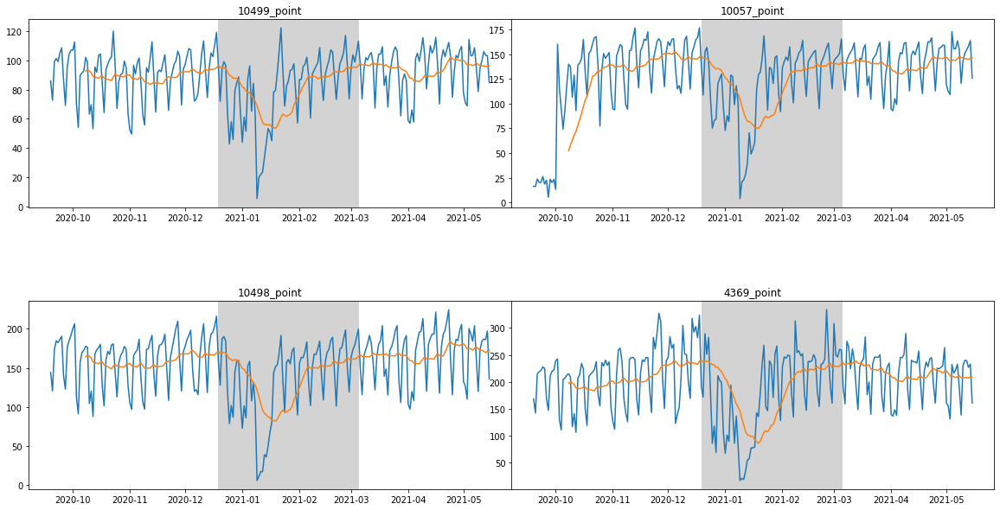

In [ ]:
id_points = [10499,10057,10498,4369]
fig, axs = plt.subplots(2,2, figsize=(20, 10), facecolor='w', edgecolor='k')
fig.subplots_adjust(hspace = .5, wspace=.001)

axs = axs.ravel()

for i in range(4):

    name = str(id_points[i]) + "_point"
    axs[i].plot(data_andres_mellado.index,data_andres_mellado[name])
    axs[i].plot(data_andres_mellado.index,data_andres_mellado[name].rolling(20).mean())
    axs[i].axvspan(datetime.strptime('19/12/2020', '%d/%m/%Y'),datetime.strptime('05/03/2021', '%d/%m/%Y'),color='lightgrey')
    axs[i].set_title(name)

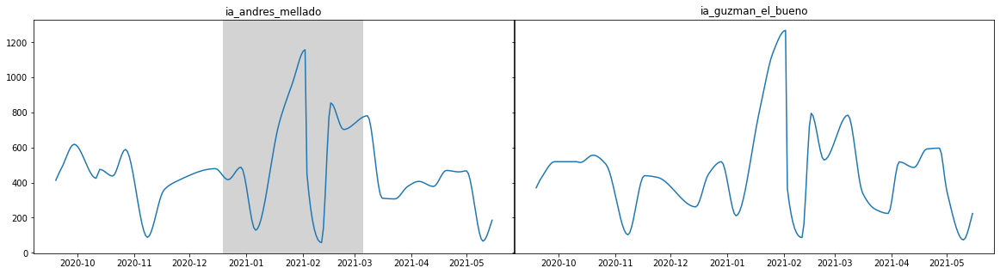

In [ ]:
name_ia = ['ia_andres_mellado','ia_guzman_el_bueno']
fig, axs = plt.subplots(1,2, figsize=(20, 5), sharey = 'row', facecolor='w', edgecolor='k')
fig.subplots_adjust(hspace = .5, wspace=.001)

axs = axs.ravel()

for i in range(2):

    axs[i].plot(data_andres_mellado.index,data_andres_mellado[name_ia[i]])
    if i == 0:
        axs[i].axvspan(datetime.strptime('19/12/2020', '%d/%m/%Y'),datetime.strptime('05/03/2021', '%d/%m/%Y'),color='lightgrey')
    axs[i].set_title(name_ia[i])

In [ ]:
#Define starting and ending dates for the restrictions

starting_date = datetime.strptime('19/12/2020', '%d/%m/%Y')
ending_date = datetime.strptime('05/03/2021', '%d/%m/%Y')

for i in range(4):
    name = str(id_points[i]) + "_point"
    point_data = data_andres_mellado[name]
    no_restrictions = point_data.loc[(point_data.index < starting_date) | (point_data.index > ending_date)]
    restrictions = point_data.loc[(point_data.index >= starting_date) & (point_data.index <= ending_date)]

    print(name, ':\n')
    print('Average traffic volume with restrictions: ', restrictions.mean())
    print('Average traffic volume without restrictions: ', no_restrictions.mean())
    print('\n\n')

10499_point :

Average traffic volume with restrictions:  80.34870102509551
Average traffic volume without restrictions:  92.32832323332242



10057_point :

Average traffic volume with restrictions:  118.82087459983374
Average traffic volume without restrictions:  130.6654686445874



10498_point :

Average traffic volume with restrictions:  135.8368040713294
Average traffic volume without restrictions:  164.20345680451692



4369_point :

Average traffic volume with restrictions:  183.38647054543307
Average traffic volume without restrictions:  212.43622510197383





In [ ]:
id_points = [10499,10057,10498,4369]

for i, point in enumerate(id_points):
    name = 'ma10_' + str(point)
    name_point = str(point) + '_point'
    data_andres_mellado[name] = data_andres_mellado.loc[:,name_point].rolling(10).mean()

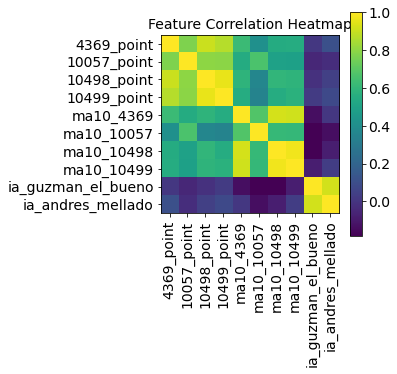

In [ ]:
cols = ['4369_point','10057_point','10498_point','10499_point','ma10_4369','ma10_10057','ma10_10498','ma10_10499',
       'ia_guzman_el_bueno','ia_andres_mellado']
show_heatmap(data_andres_mellado[cols].dropna().loc[:,data_andres_mellado[cols].columns != 'closing_andres_mellado'])

In [ ]:
data_andres_mellado[cols]

,4369_point,10057_point,10498_point,10499_point,ma10_4369,ma10_10057,ma10_10498,ma10_10499,ia_guzman_el_bueno,ia_andres_mellado
2020-09-19,168.500000,16.342857,144.208333,86.052632,NaN,NaN,NaN,NaN,370.994599,413.664656
2020-09-20,142.583333,16.112676,120.583333,72.652632,NaN,NaN,NaN,NaN,392.941551,436.753421
2020-09-21,214.557895,23.714286,172.968750,99.062500,NaN,NaN,NaN,NaN,413.270561,459.497777
2020-09-22,218.905263,20.322581,184.677083,101.343750,NaN,NaN,NaN,NaN,430.590000,479.900000
2020-09-23,221.168421,20.259740,182.312500,99.218750,NaN,NaN,NaN,NaN,446.794273,501.235051
...,...,...,...,...,...,...,...,...,...,...
2021-05-11,240.096774,150.906250,184.322917,99.791667,198.949467,143.779167,165.722917,93.806393,82.896445,74.001055
2021-05-12,239.694737,154.552083,186.968750,106.072917,207.406310,148.000000,171.726042,97.292851,107.853438,93.776562
2021-05-13,227.106383,158.145833,185.947917,103.677083,216.971114,152.898958,179.312500,100.768893,143.137461,121.735039
2021-05-14,233.104167,163.843750,197.250000,103.197917,217.028784,151.994792,179.023958,99.649101,183.585000,153.785000


#### Chopera

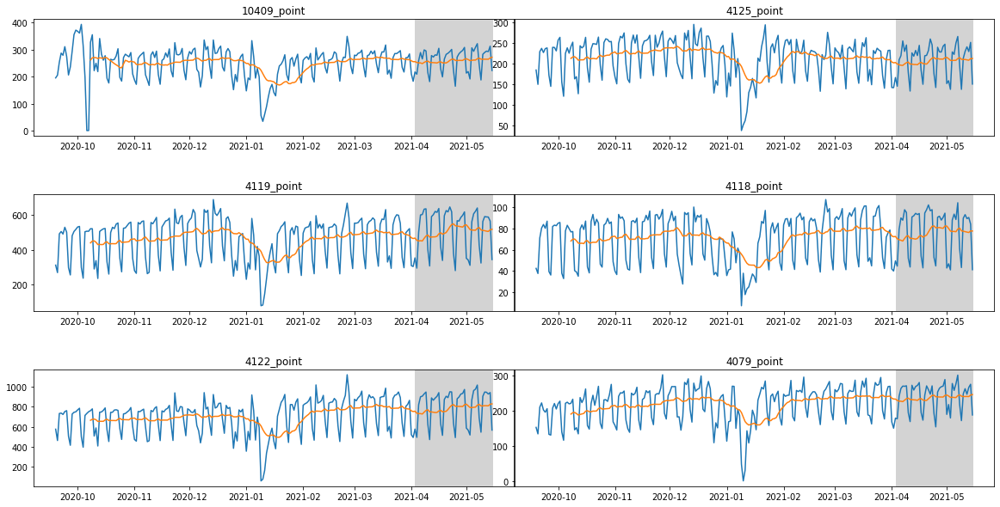

In [ ]:
id_points = [10409,4125,4119,4118,4122,4079]
fig, axs = plt.subplots(3,2, figsize=(20, 10), facecolor='w', edgecolor='k')
fig.subplots_adjust(hspace = .5, wspace=.001)

axs = axs.ravel()

for i in range(6):

    name = str(id_points[i]) + "_point"
    axs[i].plot(data_chopera.index,data_chopera[name])
    axs[i].plot(data_chopera.index,data_chopera[name].rolling(20).mean())
    axs[i].axvspan(datetime.strptime('03/04/2021', '%d/%m/%Y'),datetime.strptime('15/05/2021', '%d/%m/%Y'),color='lightgrey')
    axs[i].set_title(name)

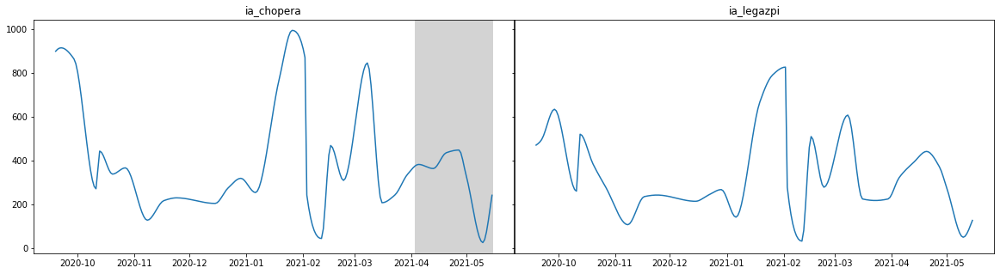

In [ ]:
name_ia = ['ia_chopera','ia_legazpi']
fig, axs = plt.subplots(1,2, figsize=(20, 5), sharey = 'row', facecolor='w', edgecolor='k')
fig.subplots_adjust(hspace = .5, wspace=.001)

axs = axs.ravel()

for i in range(2):

    axs[i].plot(data_chopera.index,data_chopera[name_ia[i]])
    if i == 0:
        axs[i].axvspan(datetime.strptime('03/04/2021', '%d/%m/%Y'),datetime.strptime('15/05/2021', '%d/%m/%Y'),color='lightgrey')
    axs[i].set_title(name_ia[i])

In [ ]:
#Define starting and ending dates for the restrictions
starting_date = datetime.strptime('03/04/2021', '%d/%m/%Y')
ending_date = datetime.strptime('15/05/2021', '%d/%m/%Y')

for i in range(5):
    name = str(id_points[i]) + "_point"
    point_data = data_chopera[name]
    no_restrictions = point_data.loc[(point_data.index < starting_date) | (point_data.index > ending_date)]
    restrictions = point_data.loc[(point_data.index >= starting_date) & (point_data.index <= ending_date)]

    print(name, ':\n')
    print('Average traffic volume with restrictions: ', restrictions.mean())
    print('Average traffic volume without restrictions: ', no_restrictions.mean())
    print('\n\n')

10409_point :

Average traffic volume with restrictions:  263.3835815558614
Average traffic volume without restrictions:  248.45480714873412



4125_point :

Average traffic volume with restrictions:  209.2606532330922
Average traffic volume without restrictions:  213.631480824921



4119_point :

Average traffic volume with restrictions:  518.4828366176091
Average traffic volume without restrictions:  457.78380397104985



4118_point :

Average traffic volume with restrictions:  77.68243981567252
Average traffic volume without restrictions:  69.9297325123897



4122_point :

Average traffic volume with restrictions:  804.3946424753586
Average traffic volume without restrictions:  698.8790878593621





In [ ]:
id_points = [10409,4125,4119,4118,4122,4079]

for i, point in enumerate(id_points):
    name = 'ma10_' + str(point)
    name_point = str(point) + '_point'
    data_chopera[name] = data_chopera.loc[:,name_point].rolling(10).mean()

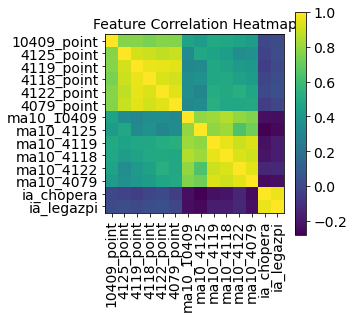

In [ ]:
cols = ['10409_point','4125_point','4119_point','4118_point','4122_point','4079_point','ma10_10409','ma10_4125',
        'ma10_4119','ma10_4118','ma10_4122','ma10_4079','ia_chopera','ia_legazpi']
show_heatmap(data_chopera[cols].dropna().loc[:,data_chopera[cols].columns != 'closing_chopera'])

#### Virgen de Begoña

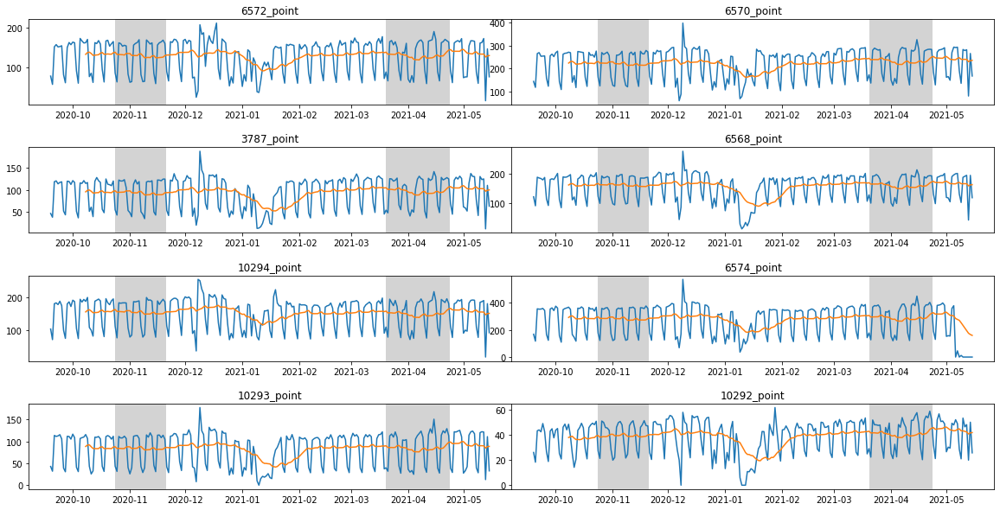

In [ ]:
id_points = [6572,6570,3787,6568,10294,6574,10293,10292]
fig, axs = plt.subplots(4,2, figsize=(20, 10), facecolor='w', edgecolor='k')
fig.subplots_adjust(hspace = .5, wspace=.001)

axs = axs.ravel()

for i in range(8):

    name = str(id_points[i]) + "_point"
    axs[i].plot(data_virgen_de_begoña.index,data_virgen_de_begoña[name])
    axs[i].plot(data_virgen_de_begoña.index,data_virgen_de_begoña[name].rolling(20).mean())
    axs[i].axvspan(datetime.strptime('24/10/2020', '%d/%m/%Y'),datetime.strptime('20/11/2020', '%d/%m/%Y'),color='lightgrey')
    axs[i].axvspan(datetime.strptime('20/03/2021', '%d/%m/%Y'),datetime.strptime('23/04/2021', '%d/%m/%Y'),color='lightgrey')
    axs[i].set_title(name)

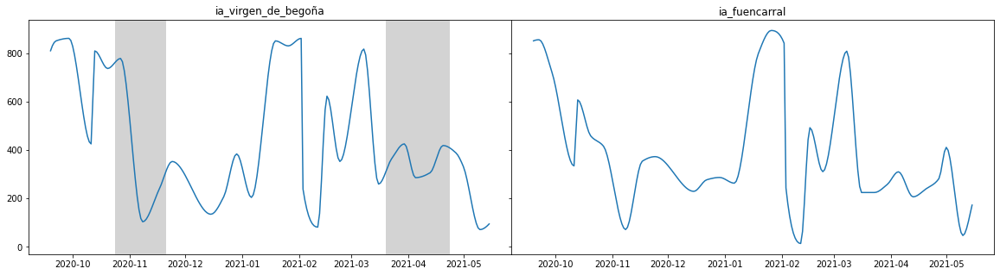

In [ ]:
name_ia = ['ia_virgen_de_begoña','ia_fuencarral']
fig, axs = plt.subplots(1,2, figsize=(20, 5), sharey = 'row', facecolor='w', edgecolor='k')
fig.subplots_adjust(hspace = .5, wspace=.001)

axs = axs.ravel()

for i in range(2):

    axs[i].plot(data_virgen_de_begoña.index,data_virgen_de_begoña[name_ia[i]])
    if i == 0:
        axs[i].axvspan(datetime.strptime('24/10/2020', '%d/%m/%Y'),datetime.strptime('20/11/2020', '%d/%m/%Y'),color='lightgrey')
        axs[i].axvspan(datetime.strptime('20/03/2021', '%d/%m/%Y'),datetime.strptime('23/04/2021', '%d/%m/%Y'),color='lightgrey')
    axs[i].set_title(name_ia[i])

In [ ]:
#Define starting and ending dates for the restrictions
starting_date_1 = datetime.strptime('24/10/2020', '%d/%m/%Y')
ending_date_1 = datetime.strptime('20/11/2020', '%d/%m/%Y')
starting_date_2 = datetime.strptime('20/03/2021', '%d/%m/%Y')
ending_date_2 = datetime.strptime('23/04/2021', '%d/%m/%Y')

for i in range(8):
    name = str(id_points[i]) + "_point"
    point_data = data_virgen_de_begoña[name]
    no_restrictions = point_data.loc[(point_data.index < starting_date_1) |
                                     ((point_data.index > ending_date_1) & (point_data.index < starting_date_2))
                                     |(point_data.index > ending_date_2)]
    restrictions = point_data.loc[(point_data.index >= starting_date_1) & (point_data.index <= ending_date_1)
                                                                        |
                                  (point_data.index >= starting_date_2) & (point_data.index <= ending_date_2)]

    print(name, ':\n')
    print('Average traffic volume with restrictions: ', restrictions.mean())
    print('Average traffic volume without restrictions: ', no_restrictions.mean())
    print('\n\n')

6572_point :

Average traffic volume with restrictions:  130.88891459848193
Average traffic volume without restrictions:  128.09794065456484



6570_point :

Average traffic volume with restrictions:  229.52904252498854
Average traffic volume without restrictions:  220.70090435384643



3787_point :

Average traffic volume with restrictions:  96.14123162405444
Average traffic volume without restrictions:  92.09950943779413



6568_point :

Average traffic volume with restrictions:  161.90103654922203
Average traffic volume without restrictions:  155.26145898562675



10294_point :

Average traffic volume with restrictions:  152.76893282721312
Average traffic volume without restrictions:  151.71067596600835



6574_point :

Average traffic volume with restrictions:  289.79420852303923
Average traffic volume without restrictions:  262.254734818109



10293_point :

Average traffic volume with restrictions:  86.73413575528953
Average traffic volume without restrictions:  82.00926500444187

In [ ]:
id_points = [6572,6570,3787,6568,10294,6574,10293,10292]
for i, point in enumerate(id_points):
    name = 'ma10_' + str(point)
    name_point = str(point) + '_point'
    data_virgen_de_begoña[name] = data_virgen_de_begoña.loc[:,name_point].rolling(10).mean()

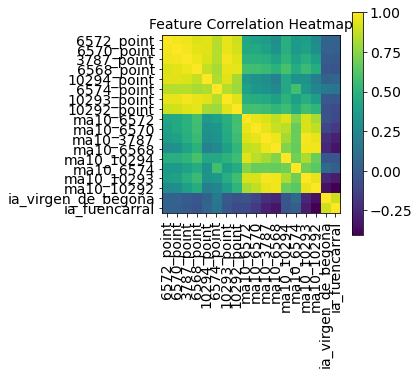

In [ ]:
cols = ['6572_point','6570_point','3787_point','6568_point','10294_point','6574_point','10293_point','10292_point',
        'ma10_6572','ma10_6570','ma10_3787','ma10_6568','ma10_10294','ma10_6574','ma10_10293','ma10_10292',
        'ia_virgen_de_begoña','ia_fuencarral']
show_heatmap(data_virgen_de_begoña[cols].dropna().loc[:,data_virgen_de_begoña[cols].columns != 'closing_virgen_de_begoña'])

## Neural Network approach

#### Auxilliary functions to normalize and split dataset

In [ ]:
def preprocess_dataset(data, train_size, val_size, test_size):
    #Definitions
    step = 1 #1 sample per day

    #Number of samples of the dataset
    n = len(data)

    #Splitting according to proportionalities
    train_df = data[:int(n*0.7)]
    val_df  = data[int(n*0.7):int(n*(train_size+val_size))]
    test_df = data[int(n*(train_size+val_size)):]

    #Scale the data
    train_mean = train_df.mean()
    train_std = train_df.std()

    train_df = (train_df - train_mean)/train_std
    val_df = (val_df - train_mean)/train_std
    test_df = (test_df - train_mean)/train_std

    return train_df, val_df, test_df

def reshape_dataset(data, input_length, offset, target_column):
    #Subset dataframe
    data_x = data.loc[:,data.columns != target_column].to_numpy()
    data_y = data[target_column].to_numpy()

    return data_x, data_y

def normalize(data, train_split):
    data_mean = data[:train_split].mean(axis=0)
    data_std = data[:train_split].std(axis=0)
    return (data - data_mean) / data_std

def visualize_loss(history, title):
    loss = history.history["loss"]
    val_loss = history.history["val_loss"]
    epochs = range(len(loss))
    plt.figure()
    plt.plot(epochs, loss, "b", label="Training loss")
    plt.plot(epochs, val_loss, "r", label="Validation loss")
    plt.title(title)
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.legend()
    plt.show()

def show_plot(plot_data, delta, title):
    labels = ["History", "True Future", "Model Prediction"]
    marker = [".-", "rx", "go"]
    time_steps = list(range(-(plot_data[0].shape[0]), 0))
    if delta:
        future = delta
    else:
        future = 0

    plt.title(title)
    for i, val in enumerate(plot_data):
        if i:
            plt.plot(future, plot_data[i], marker[i], markersize=10, label=labels[i])
        else:
            plt.plot(time_steps, plot_data[i].flatten(), marker[i], label=labels[i])
    plt.legend()
    plt.xlim([time_steps[0], (future + 5) * 2])
    plt.xlabel("Time-Step")
    plt.show()
    return

def window_data(X, Y, window=7):
    '''
    The dataset length will be reduced to guarante all samples have the window, so new length will be len(dataset)-window
    '''
    x = []
    y = []
    for i in range(window-1, len(X)):
        x.append(X[i-window+1:i+1])
        y.append(Y[i])
    return np.array(x), np.array(y)

#### Test for Andrés Mellado

In [ ]:
#Extract desired features
data_andres_mellado = data_andres_mellado.loc[:,data_andres_mellado.columns != 'closing_andres_mellado']

#Preprocess
train_df, val_df, test_df = preprocess_dataset(data_andres_mellado, train_size = 0.7, val_size = 0.2, test_size = 0.1)

#Generate corresponding datasets
x_train, y_train = reshape_dataset(train_df, input_length = 31, offset = 1, target_column = 'ia_andres_mellado')
x_val, y_val = reshape_dataset(val_df, input_length = 31, offset = 1, target_column = 'ia_andres_mellado')
x_test, y_test = reshape_dataset(test_df, input_length = 31, offset = 1, target_column = 'ia_andres_mellado')

In [ ]:
def evaluate_nn(split_fraction=0.7, step=1, past=30, future=5, learning_rate=0.01, batch_size=30, epochs=75):

    #Generate training partition
    train_split = int(split_fraction * int(data_andres_mellado.shape[0]))

    #Subset and normalize features
    features = data_andres_mellado
    features.index = data_andres_mellado.index
    features.head()

    features = normalize(features.values, train_split)
    features = pd.DataFrame(features)

    #Divide data according to split_fraction
    train_data = features.loc[0 : train_split - 1]
    val_data = features.loc[train_split:]

    #Define training and start and end
    start = past + future
    end = start + train_split

    #Select the target
    x_train = train_data[[i for i in range(5)]].values
    y_train = features.iloc[start:end][[5]]

    #Define sequence length
    sequence_length = int(past/step)

    #Create training data
    dataset_train = keras.preprocessing.timeseries_dataset_from_array(
        data = x_train,
        targets = y_train,
        sequence_length=sequence_length,
        sampling_rate=step,
        batch_size = batch_size
    )

    #Create training batches
    for batch in dataset_train.take(1):
        inputs_train, targets_train = batch

    #Last value of validation and starting point
    x_end = len(val_data) - past - future
    label_start = train_split + past + future

    #Define target and features
    x_val = val_data.iloc[:x_end][[i for i in range(5)]].values
    y_val = features.iloc[label_start:][[5]]

    #Create validation dataset
    dataset_val = keras.preprocessing.timeseries_dataset_from_array(
        data = x_val,
        targets = y_val,
        sequence_length=sequence_length,
        sampling_rate=step,
        batch_size = batch_size
    )

    #Create validation batches
    for batch in dataset_train.take(1):
        inputs_val, targets_val = batch

    #Define the model
    model = Sequential()
    model.add(LSTM(64, return_sequences = True, input_shape = (inputs_train.shape[1], inputs_train.shape[2])))
    model.add(LSTM(64, return_sequences = False))
    model.add(Dense(1))

    #Compile the model
    model.compile(optimizer=keras.optimizers.Adam(learning_rate=learning_rate), loss="mse")
    model.summary()

    #Fit the model
    history = model.fit(
        dataset_train,
        epochs=epochs,
        validation_data=dataset_val
    )

    #Graph with loss
    visualize_loss(history, "Training and Validation Loss")

    sum_mae = 0

    #Plot result
    for index, data in enumerate(dataset_val.take(1)):
        for i in range(data[0].shape[0]):
            y_show = pd.concat([y_train,y_val]).loc[y_train.index[-20]:(y_val.index[0]-future+i)]
            show_plot(
                [y_show.to_numpy(), data[1][i].numpy(), model.predict(data[0])[i]],
                future,
                "Single Step Prediction",
            )
        sum_mae = sum_mae + np.abs(data[1].numpy() - model.predict(data[0]))

    #Return error
    mae = sum_mae.mean()
    print('MAE model: ', mae)

    return mae

In [ ]:
path_checkpoint = "model_checkpoint.h5"
es_callback = keras.callbacks.EarlyStopping(monitor="val_loss", min_delta=0, patience=15)

modelckpt_callback = keras.callbacks.ModelCheckpoint(
    monitor="val_loss",
    filepath=path_checkpoint,
    verbose=1,
    save_weights_only=True,
    save_best_only=True,
)

history = model.fit(
    dataset_train,
    epochs=epochs,
    validation_data=dataset_val
)

In [ ]:
past = np.array([10,15,20,25])
future = np.array([1,2,5,7])
mae = np.zeros([len(past),len(future)])

for i,value_past in enumerate(past):
    for j,value_future in enumerate(future):
        print('DAYS PAST: ', value_past, ', DAYS AHEAD:', value_future, '\n')
        mae[i,j] = evaluate_nn(past = past[i], future = future[j])


In [ ]:
mae

In [ ]:
split_fraction=0.7
step=1
past=30
future=5
learning_rate=0.01
batch_size=30
epochs=100

In [ ]:
#Generate training partition
train_split = int(split_fraction * int(data_andres_mellado.shape[0]))

#Subset and normalize features
features = data_andres_mellado
features.index = data_andres_mellado.index
features.head()

In [ ]:
features = normalize(features.values, train_split)
features = pd.DataFrame(features)

#Divide data according to split_fraction
train_data = features.loc[0 : train_split - 1]
val_data = features.loc[train_split:]

#Define training and start and end
start = past + future
end = start + train_split

#Select the target
x_train = train_data[[i for i in range(5)]].values
y_train = features.iloc[start:end][[5]]

In [ ]:
#Define sequence length
sequence_length = int(past/step)

#Create training data
dataset_train = keras.preprocessing.timeseries_dataset_from_array(
    data = x_train,
    targets = y_train,
    sequence_length=sequence_length,
    sampling_rate=step,
    batch_size = batch_size
)

#Create training batches
for batch in dataset_train.take(1):
    inputs_train, targets_train = batch

#Last value of validation and starting point
x_end = len(val_data) - past - future
label_start = train_split + past + future

In [ ]:
#Define target and features
x_val = val_data.iloc[:x_end][[i for i in range(5)]].values
y_val = features.iloc[label_start:][[5]]

#Create validation dataset
dataset_val = keras.preprocessing.timeseries_dataset_from_array(
    data = x_val,
    targets = y_val,
    sequence_length=sequence_length,
    sampling_rate=step,
    batch_size = batch_size
)

#Create validation batches
for batch in dataset_val.take(1):
    inputs_val, targets_val = batch

In [ ]:
#Define the model
model = Sequential()
model.add(LSTM(32, return_sequences = True, input_shape = (inputs_train.shape[1], inputs_train.shape[2])))
model.add(LSTM(32, return_sequences = False))
model.add(Dense(1))

#Compile the model
model.compile(optimizer=keras.optimizers.Adam(learning_rate=learning_rate), loss="mse")
model.summary()

#Fit the model
history = model.fit(
    dataset_train,
    epochs=epochs,
    validation_data=dataset_val
)

#Graph with loss
visualize_loss(history, "Training and Validation Loss")

In [ ]:
sum_mae = 0

#Plot result
for index, data in enumerate(dataset_val.take(1)):
    for i in range(data[0].shape[0]):
        y_show = pd.concat([y_train,y_val]).loc[170:(202-future+i)]
        show_plot(
            [y_show.to_numpy(), data[1][i].numpy(), model.predict(data[0])[i]],
            future,
            "Single Step Prediction",
        )
    sum_mae = sum_mae + np.abs(data[1].numpy() - model.predict(data[0]))

#Return error
mae = sum_mae.mean()
print('MAE model: ', mae)

## Machine Learning approach

In [ ]:
#Imports for this section
from xgboost import XGBRegressor
from lightgbm import LGBMRegressor
from catboost import CatBoostRegressor

from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import make_pipeline
from sklearn.svm import SVR
from sklearn.neural_network import MLPRegressor

from skforecast.ForecasterAutoreg import ForecasterAutoreg
from skforecast.ForecasterAutoregMultiOutput import ForecasterAutoregMultiOutput
from skforecast.model_selection import grid_search_forecaster
from skforecast.model_selection import backtesting_forecaster

In [ ]:
data_andres_mellado = data_andres_mellado.dropna()

In [ ]:
#Split in train/validation/test
end_train = '2021-02-15'
end_validation = '2021-03-15'

#Normalize data
data_andres_mellado_norm = normalize(data_andres_mellado, 178)

#Subset data
data_train = data_andres_mellado_norm.loc[: end_train, :]
data_val   = data_andres_mellado_norm.loc[end_train:end_validation, :]
data_test  = data_andres_mellado_norm.loc[end_validation:, :]

print(f"Dates train      : {data_train.index.min()} --- {data_train.index.max()}  (n={len(data_train)})")
print(f"Dates validacion : {data_val.index.min()} --- {data_val.index.max()}  (n={len(data_val)})")
print(f"Dates test       : {data_test.index.min()} --- {data_test.index.max()}  (n={len(data_test)})")

Dates train      : 2020-09-28 00:00:00 --- 2021-02-15 00:00:00  (n=141)
Dates validacion : 2021-02-15 00:00:00 --- 2021-03-15 00:00:00  (n=29)
Dates test       : 2021-03-15 00:00:00 --- 2021-05-15 00:00:00  (n=62)


In [ ]:
forecaster = ForecasterAutoreg(
                regressor = XGBRegressor(random_state=123),
                lags = 24
             )

param_grid = {
    'n_estimators': [100, 500, 1000],
    'max_depth': [2,3,4,5],
    'learning_rate': [0.001,0.01, 0.1]
    }

# Lags used as predictors
lags_grid = [5, 10, 15, [1, 2, 5, 10], [1, 5, 10, 20, 30], [1, 5, 10, 15, 20, 25, 30]]


results_grid = grid_search_forecaster(
        forecaster         = forecaster,
        y                  = data_andres_mellado_norm.loc[:end_validation, 'ia_andres_mellado'], # Train and validation data
        param_grid         = param_grid,
        lags_grid          = lags_grid,
        steps              = 5,
        refit              = True,
        metric             = 'mean_absolute_error',
        initial_train_size = int(len(data_train)), # Model is trained with trainign data
        fixed_train_size   = False,
        return_best        = True,
        verbose            = False
        )

Number of models compared: 216


loop param_grid:  56%|████████████████████                | 20/36 [00:26<00:20,  1.27s/it]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [04:45<00:00, 47.52s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  5 10 20 30] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 2, 'n_estimators': 1000}
  Backtesting metric: 0.21336175494769694



In [ ]:
results_grid.head(10)

,lags,params,metric,learning_rate,max_depth,n_estimators
170,"[1, 5, 10, 20, 30]","{'learning_rate': 0.1, 'max_depth': 2, 'n_esti...",0.213362,0.10,2.0,1000.0
139,"[1, 2, 5, 10]","{'learning_rate': 0.1, 'max_depth': 4, 'n_esti...",0.215587,0.10,4.0,500.0
140,"[1, 2, 5, 10]","{'learning_rate': 0.1, 'max_depth': 4, 'n_esti...",0.215587,0.10,4.0,1000.0
128,"[1, 2, 5, 10]","{'learning_rate': 0.01, 'max_depth': 4, 'n_est...",0.217148,0.01,4.0,1000.0
143,"[1, 2, 5, 10]","{'learning_rate': 0.1, 'max_depth': 5, 'n_esti...",0.218453,0.10,5.0,1000.0
142,"[1, 2, 5, 10]","{'learning_rate': 0.1, 'max_depth': 5, 'n_esti...",0.218453,0.10,5.0,500.0
141,"[1, 2, 5, 10]","{'learning_rate': 0.1, 'max_depth': 5, 'n_esti...",0.218782,0.10,5.0,100.0
138,"[1, 2, 5, 10]","{'learning_rate': 0.1, 'max_depth': 4, 'n_esti...",0.220191,0.10,4.0,100.0
131,"[1, 2, 5, 10]","{'learning_rate': 0.01, 'max_depth': 5, 'n_est...",0.223446,0.01,5.0,1000.0
169,"[1, 5, 10, 20, 30]","{'learning_rate': 0.1, 'max_depth': 2, 'n_esti...",0.235834,0.10,2.0,500.0


Backtest error: 0.21559274466207978


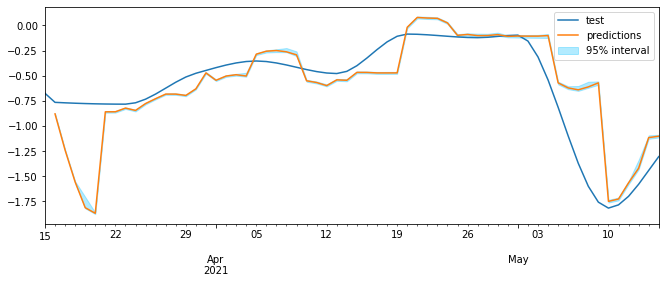

In [ ]:
metric, predictions = backtesting_forecaster(
    forecaster = forecaster,
    y          = data_andres_mellado_norm['ia_andres_mellado'],
    initial_train_size = len(data_andres_mellado_norm.loc[:end_validation]),
    fixed_train_size   = False,
    steps      = 5,
    refit      = True,
    interval   = [5, 95],
    n_boot     = 1000,
    metric     = 'mean_absolute_error',
    verbose    = False # Change to True to see detailed information
    )

print(f"Backtest error: {metric}")

fig, ax = plt.subplots(figsize=(11, 4))
data_test['ia_andres_mellado'].plot(ax=ax, label='test')
predictions['pred'].plot(ax=ax, label='predictions')
ax.fill_between(
    predictions.index,
    predictions['lower_bound'],
    predictions['upper_bound'],
    color = 'deepskyblue',
    alpha = 0.3,
    label = '95% interval'
)
ax.legend();

In [ ]:
exogenous_var = data_andres_mellado_norm.columns[:-1]

results_grid = grid_search_forecaster(
                        forecaster         = forecaster,
                        y                  = data_andres_mellado_norm.loc[:end_validation, 'ia_andres_mellado'],
                        exog               = data_andres_mellado_norm.loc[:end_validation, exogenous_var],
                        param_grid         = param_grid,
                        lags_grid          = lags_grid,
                        steps              = 10,
                        refit              = True,
                        metric             = 'mean_absolute_error',
                        initial_train_size = int(len(data_train)),
                        fixed_train_size   = False,
                        return_best        = True,
                        verbose            = False
                        )

Number of models compared: 216


loop param_grid:  56%|████████████████████                | 20/36 [00:15<00:11,  1.35it/s]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [02:40<00:00, 26.74s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 2, 'n_estimators': 1000}
  Backtesting metric: 0.12292080255733916



In [ ]:
metric, predictions = backtesting_forecaster(
    forecaster         = forecaster,
    y                  = data_andres_mellado_norm['ia_andres_mellado'],
    exog               = data_andres_mellado_norm[exogenous_var],
    initial_train_size = len(data_andres_mellado_norm.loc[:end_validation]),
    fixed_train_size   = False,
    steps              = 10,
    refit              = True,
    interval           = [5, 95],
    n_boot             = 1000,
    metric             = 'mean_absolute_error',
    verbose            = False
    )


Backtest error: 0.011758777212368404


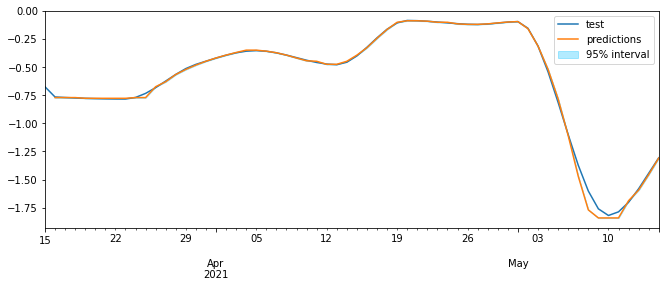

In [ ]:
print(f"Backtest error: {metric}")

fig, ax = plt.subplots(figsize=(11, 4))
data_test['ia_andres_mellado'].plot(ax=ax, label='test')
predictions['pred'].plot(ax=ax, label='predictions')
ax.fill_between(
    predictions.index,
    predictions['lower_bound'],
    predictions['upper_bound'],
    color = 'deepskyblue',
    alpha = 0.3,
    label = '95% interval'
)
ax.legend();

#### Automatization of the process

In [ ]:
def evaluate_forecasting(data, data_test, forecaster, univariate, target, exogenous_var,
                             steps, lags_grid, param_grid, refit, end_train):
        if univariate:

            #Train model\n",
            results_grid = grid_search_forecaster(
                forecaster         = forecaster,
                y                  = data.loc[:end_train, target], # Train and validation data",
                param_grid         = param_grid,
                lags_grid          = lags_grid,
                steps              = steps,
                refit              = refit,
                metric             = 'mean_absolute_error',
                initial_train_size = int(len(data_train)), # Model is trained with trainign data",
                fixed_train_size   = False,
                return_best        = True,
                verbose            = False
                )

            #Evaluate model",
            metric, predictions = backtesting_forecaster(
                forecaster = forecaster,
                y          = data[target],
                initial_train_size = len(data.loc[:end_train]),
                fixed_train_size   = False,
                steps      = steps,
                refit      = refit,
                interval   = [5, 95],
                n_boot     = 1000,
                metric     = 'mean_absolute_error',
                verbose    = False # Change to True to see detailed information"
                )
        else:
            #Train model
            results_grid = grid_search_forecaster(
                            forecaster         = forecaster,
                            y                  = data.loc[:end_train, target],
                            exog               = data.loc[:end_train, exogenous_var],
                            param_grid         = param_grid,
                            lags_grid          = lags_grid,
                            steps              = steps,
                            refit              = refit,
                            metric             = 'mean_absolute_error',
                            initial_train_size = int(len(data_train)),
                            fixed_train_size   = False,
                            return_best        = True,
                            verbose            = False
                            )

            #Test model\n",
            metric, predictions = backtesting_forecaster(
                forecaster         = forecaster,
                y                  = data[target],
                exog               = data[exogenous_var],
                initial_train_size = len(data.loc[:end_train]),
                fixed_train_size   = False,
                steps              = steps,
                refit              = refit,
                interval           = [5, 95],
                n_boot             = 1000,
                metric             = 'mean_absolute_error',
                verbose            = False,
                )

        #Show results\n",
        print(f"Backtest error: {metric}")

        #Plot results\n",
        fig, ax = plt.subplots(figsize=(11, 4))
        data_test[target].plot(ax=ax, label='test')
        predictions['pred'].plot(ax=ax, label='predictions')
        ax.fill_between(
            predictions.index,
            predictions['lower_bound'],
            predictions['upper_bound'],
            color = 'deepskyblue',
            alpha = 0.3,
            label = '95% interval'
        )
        ax.legend();

        return metric

### Andrés Mellado

In [ ]:
data_andres_mellado_norm = data_andres_mellado_norm.loc[:,data_andres_mellado.columns != 'closing_andres_mellado']
exogenous_var = data_andres_mellado_norm.loc[:, data_andres_mellado_norm.columns != 'ia_andres_mellado'].columns
target = 'ia_andres_mellado'
steps = [1,5,7,14]

#### XGBRegressor with contiguous CI

In [ ]:
forecaster = ForecasterAutoreg(
                regressor = XGBRegressor(random_state=123),
                lags = 24
             )

param_grid = {
    'n_estimators': [100, 500, 1000],
    'max_depth': [2,3,4,5],
    'learning_rate': [0.001,0.01, 0.1]
    }

# Lags used as predictors
lags_grid = [5, 10, 15, [5, 10], [5, 10, 20, 30], [5, 10, 15, 20, 25, 30]]

Number of models compared: 216


loop param_grid:  56%|████████████████████                | 20/36 [00:05<00:04,  3.86it/s]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [01:02<00:00, 10.33s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 500}
  Backtesting metric: 0.12680712910484232

Backtest error: 0.09761849849794603
Number of models compared: 216


loop param_grid:  56%|████████████████████                | 20/36 [00:05<00:04,  3.75it/s]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [01:01<00:00, 10.27s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 2, 'n_estimators': 100}
  Backtesting metric: 0.276507016404434

Backtest error: 0.620925269278613
Number of models compared: 216


loop param_grid:  56%|████████████████████                | 20/36 [00:05<00:04,  3.59it/s]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [01:03<00:00, 10.60s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 2, 'n_estimators': 100}
  Backtesting metric: 0.348598179179593

Backtest error: 0.6414543128797976
Number of models compared: 216


loop param_grid:  56%|████████████████████                | 20/36 [00:05<00:04,  3.53it/s]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [01:04<00:00, 10.77s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 2, 'n_estimators': 100}
  Backtesting metric: 0.35437219550038346

Backtest error: 0.6484370767730893


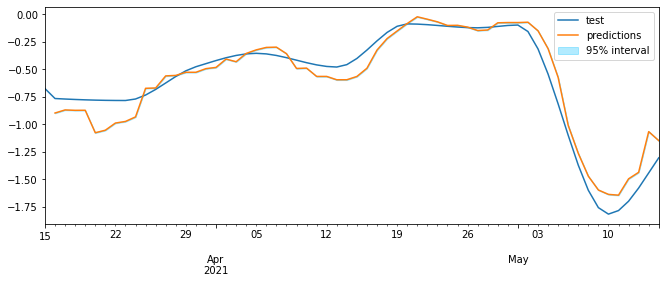

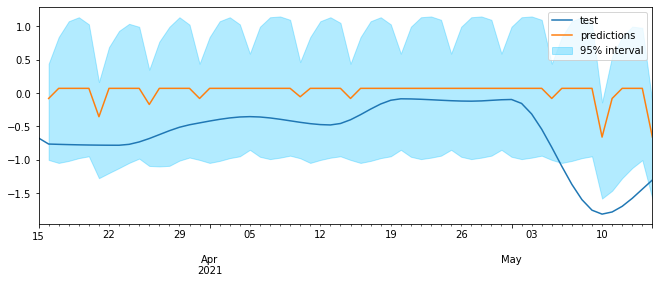

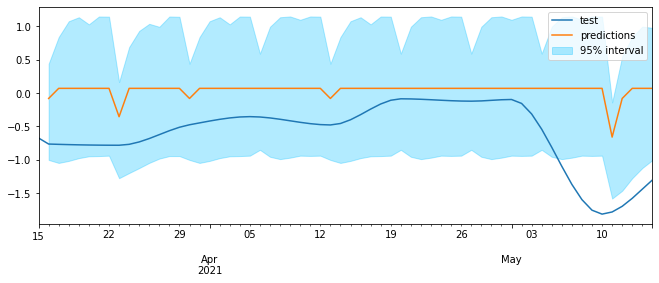

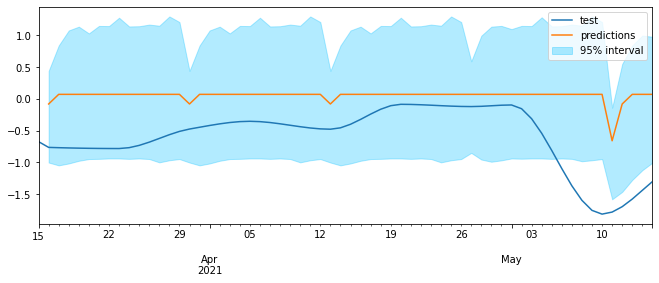

In [ ]:
#Array to store results
mae_xgb_bench = np.zeros(len(steps))

# Univariate without refit
for i, step in enumerate(steps):
    mae_xgb_bench[i] = evaluate_forecasting(data_andres_mellado_norm,data_test,forecaster,True,target,exogenous_var,step,
                                           lags_grid,param_grid,False,end_validation)

Number of models compared: 216


loop param_grid:  56%|████████████████████                | 20/36 [00:06<00:04,  3.23it/s]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [01:14<00:00, 12.47s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 2, 'n_estimators': 500}
  Backtesting metric: 0.26626491696427423

Backtest error: 0.17210335615184963
Number of models compared: 216


loop param_grid:  56%|████████████████████                | 20/36 [00:05<00:04,  3.38it/s]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [01:06<00:00, 11.04s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 5 10 20 30] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 2, 'n_estimators': 1000}
  Backtesting metric: 0.3029817903828846

Backtest error: 0.4252292988267617
Number of models compared: 216


loop param_grid:  56%|████████████████████                | 20/36 [00:06<00:04,  3.33it/s]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [01:07<00:00, 11.23s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 5 10 20 30] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 2, 'n_estimators': 1000}
  Backtesting metric: 0.3284638465606009

Backtest error: 0.426623480739832
Number of models compared: 216


loop param_grid:  56%|████████████████████                | 20/36 [00:05<00:04,  3.34it/s]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [01:07<00:00, 11.27s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 2, 'n_estimators': 500}
  Backtesting metric: 0.3419094197832642

Backtest error: 0.376289363557672


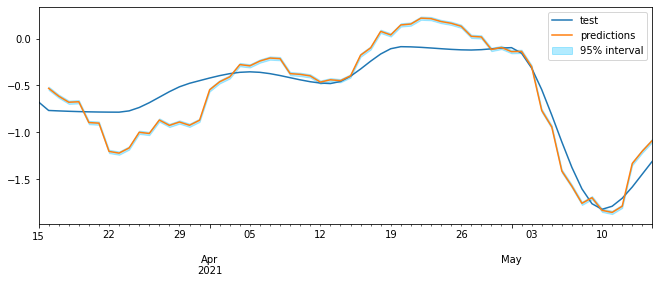

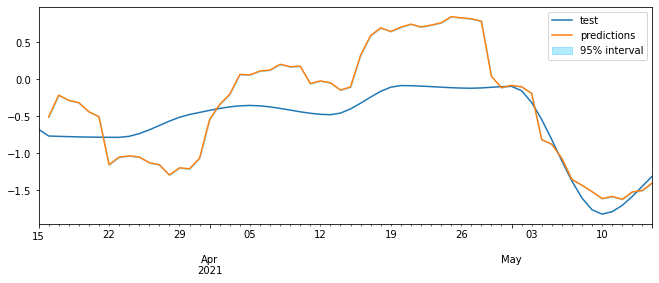

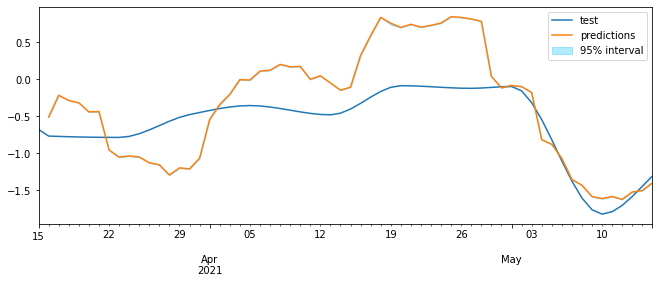

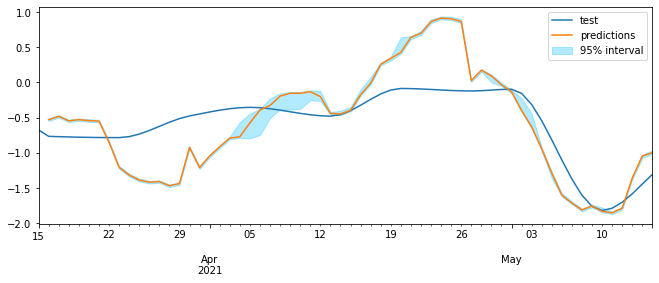

In [ ]:
mae_xgb = np.zeros(len(steps))

# Multivariate without refit
for i, step in enumerate(steps):
    mae_xgb[i] = evaluate_forecasting(data_andres_mellado_norm,data_test,forecaster,False,target,exogenous_var,step,
                                           lags_grid,param_grid,False,end_validation)

In [ ]:
mae_xgb_bench

array([0.0976185 , 0.62092527, 0.64145431, 0.64843708])

In [ ]:
mae_xgb

array([0.17210336, 0.4252293 , 0.42662348, 0.37628936])

Number of models compared: 216


loop param_grid:  56%|████████████████████                | 20/36 [02:02<01:38,  6.14s/it]


loop lags_grid: 100%|██████████████████████████████████████| 6/6 [23:46<00:00, 237.77s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 4, 'n_estimators': 1000}
  Backtesting metric: 0.14460213127097954

Forecaster will be fit 61 times. This can take substantial amounts of time. If not feasible, try with `refit = False`. 

Backtest error: 0.043836957366605415
Number of models compared: 216


loop param_grid:  56%|████████████████████                | 20/36 [00:27<00:22,  1.41s/it]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [05:23<00:00, 53.93s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 4, 'n_estimators': 100}
  Backtesting metric: 0.25999991434688613

Backtest error: 0.1591512595102453
Number of models compared: 216


loop param_grid:  56%|████████████████████                | 20/36 [00:18<00:15,  1.06it/s]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [03:42<00:00, 37.01s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 5, 'n_estimators': 1000}
  Backtesting metric: 0.33094688907928216

Backtest error: 0.2871142939257305
Number of models compared: 216


loop param_grid:  56%|████████████████████                | 20/36 [00:10<00:08,  1.96it/s]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [01:58<00:00, 19.80s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 2, 'n_estimators': 100}
  Backtesting metric: 0.3625984794766087

Backtest error: 0.6545935206508762


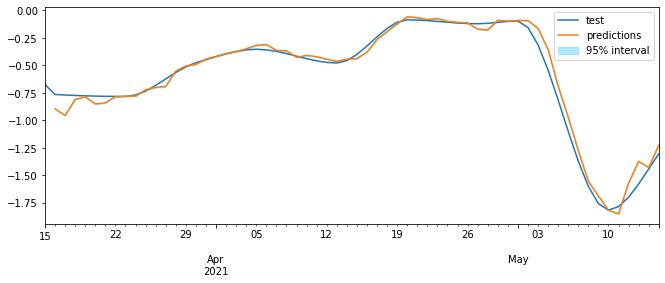

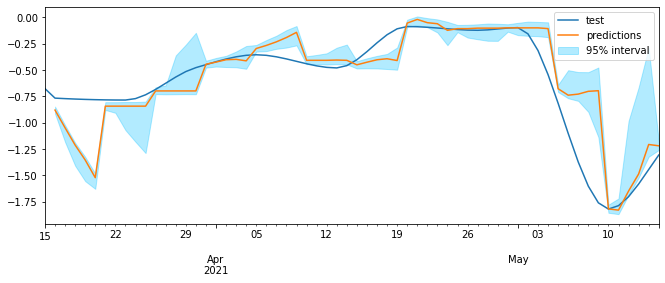

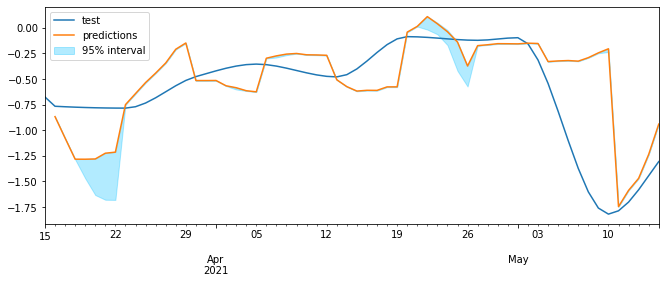

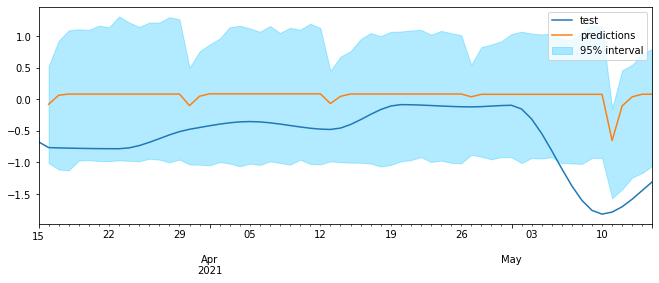

In [ ]:
#Array to store results
mae_xgb_bench_refit = np.zeros(len(steps))

# Univariate without refit
for i, step in enumerate(steps):
    mae_xgb_bench_refit[i] = evaluate_forecasting(data_andres_mellado_norm,data_test,forecaster,True,target,exogenous_var,step,
                                           lags_grid,param_grid,True,end_validation)

Number of models compared: 216


loop param_grid:  56%|████████████████████                | 20/36 [02:17<01:49,  6.82s/it]


loop lags_grid: 100%|██████████████████████████████████████| 6/6 [26:17<00:00, 262.95s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 5 10 15 20 25 30] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 1000}
  Backtesting metric: 0.15970521368464685

Forecaster will be fit 61 times. This can take substantial amounts of time. If not feasible, try with `refit = False`. 

Backtest error: 0.1810335313120533
Number of models compared: 216


loop param_grid:  56%|████████████████████                | 20/36 [00:30<00:24,  1.51s/it]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [05:52<00:00, 58.73s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 5 10 20 30] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 2, 'n_estimators': 1000}
  Backtesting metric: 0.22745570779974056

Backtest error: 0.3138566082526509
Number of models compared: 216


loop param_grid:  56%|████████████████████                | 20/36 [00:20<00:16,  1.03s/it]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [03:57<00:00, 39.60s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 1000}
  Backtesting metric: 0.2810773915579755

Backtest error: 0.2724544488384095
Number of models compared: 216


loop param_grid:  56%|████████████████████                | 20/36 [00:11<00:08,  1.82it/s]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [02:06<00:00, 21.11s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 5 10 20 30] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 100}
  Backtesting metric: 0.20493905067036028

Backtest error: 0.38178685299997167


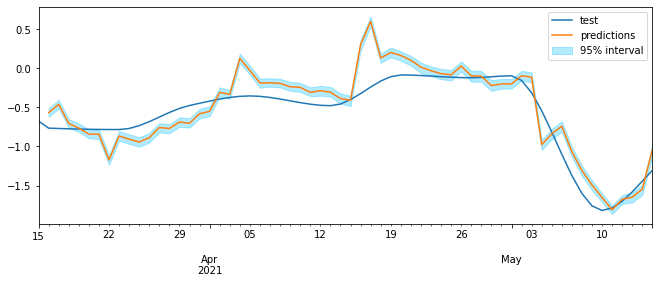

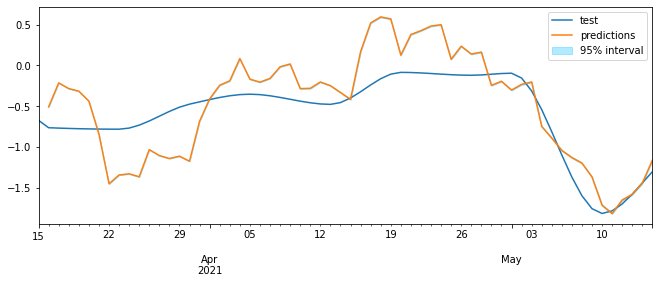

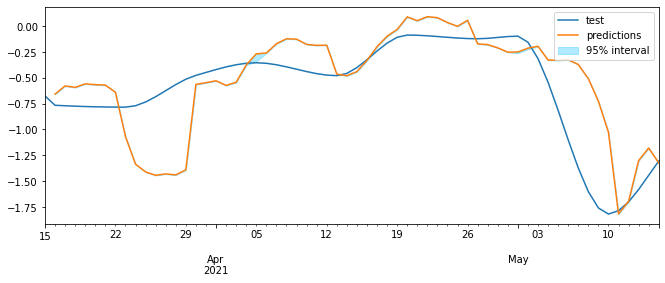

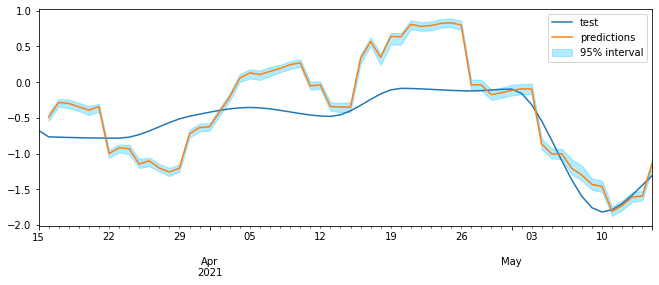

In [ ]:
mae_xgb_refit = np.zeros(len(steps))

# Multivariate without refit
for i, step in enumerate(steps):
    mae_xgb_refit[i] = evaluate_forecasting(data_andres_mellado_norm,data_test,forecaster,False,target,exogenous_var,step,
                                           lags_grid,param_grid,True,end_validation)

In [ ]:
mae_xgb_bench_refit

array([0.04383696, 0.15915126, 0.28711429, 0.65459352])

In [ ]:
mae_xgb_refit

array([0.18103353, 0.31385661, 0.27245445, 0.38178685])

#### LGBMegressor with contiguous CI

In [ ]:
forecaster = ForecasterAutoreg(
                regressor = LGBMRegressor(random_state=123),
                lags = 24
             )

param_grid = {
    'n_estimators': [100, 500, 1000],
    'max_depth': [2,3,4,5],
    'learning_rate': [0.001,0.01, 0.1]
    }

# Lags used as predictors
lags_grid = [5, 10, 15, [1, 2, 5, 10], [1, 5, 10, 20, 30], [1, 5, 10, 15, 20, 25, 30]]

Number of models compared: 216


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:23<00:00,  3.90s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  5 10 20 30] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 100}
  Backtesting metric: 0.21733512799522484

Backtest error: 0.26610199879662516
Number of models compared: 216


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:17<00:00,  2.94s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  5 10 20 30] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 4, 'n_estimators': 100}
  Backtesting metric: 0.21754448009815805

Backtest error: 0.44600152055323733
Number of models compared: 216


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:17<00:00,  2.86s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  5 10 20 30] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 4, 'n_estimators': 100}
  Backtesting metric: 0.3455349201178834

Backtest error: 0.45843137640628406
Number of models compared: 216


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:16<00:00,  2.80s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  5 10 20 30] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 4, 'n_estimators': 100}
  Backtesting metric: 0.3455349201178834

Backtest error: 0.45950067191104543


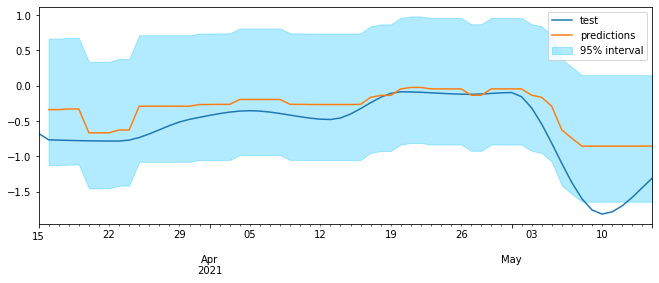

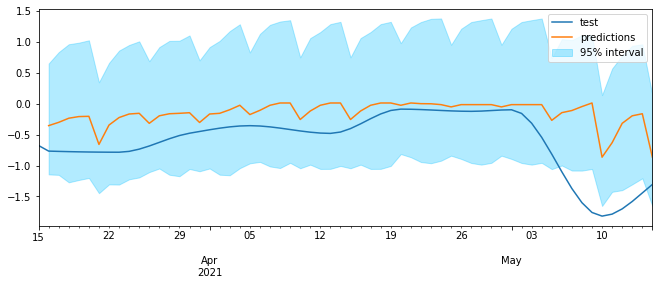

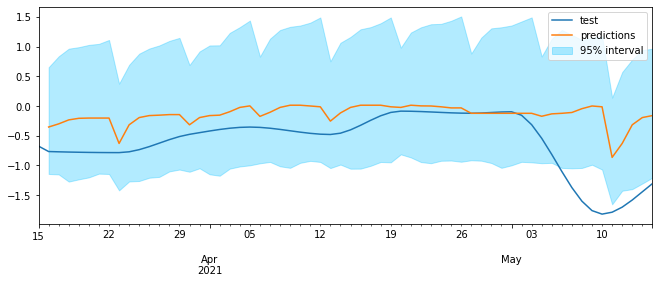

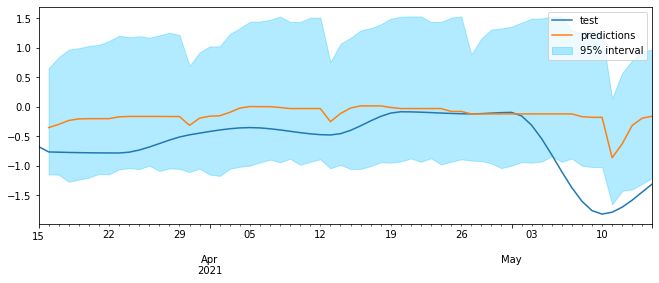

In [ ]:
#Array to store results
mae_lgbm_bench = np.zeros(len(steps))

# Univariate without refit
for i, step in enumerate(steps):
    mae_lgbm_bench[i] = evaluate_forecasting(data_andres_mellado_norm,data_test,forecaster,True,target,exogenous_var,step,
                                           lags_grid,param_grid,False,end_validation)

Number of models compared: 216


loop param_grid:  58%|█████████████████████               | 21/36 [00:03<00:02,  5.49it/s]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:36<00:00,  6.16s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  5 10] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 100}
  Backtesting metric: 0.27826197724812346

Backtest error: 0.25667404977320424
Number of models compared: 216


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:21<00:00,  3.53s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  5 10] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 100}
  Backtesting metric: 0.28551495341891747

Backtest error: 0.3588857631554744
Number of models compared: 216


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:20<00:00,  3.38s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  5 10 20 30] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 100}
  Backtesting metric: 0.31444286515589187

Backtest error: 0.46671489369657065
Number of models compared: 216


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:18<00:00,  3.12s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  5 10 15 20 25 30] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 100}
  Backtesting metric: 0.31444286515589187

Backtest error: 0.5001788126424062


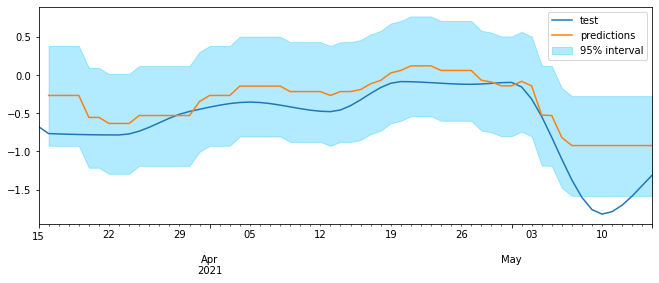

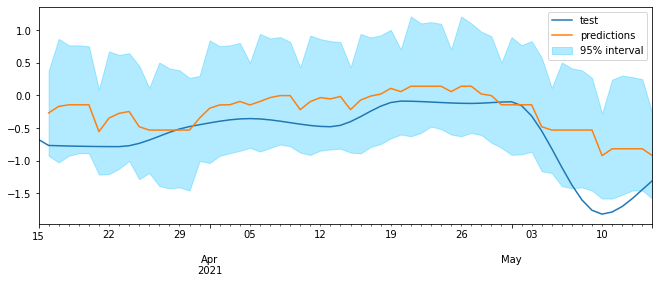

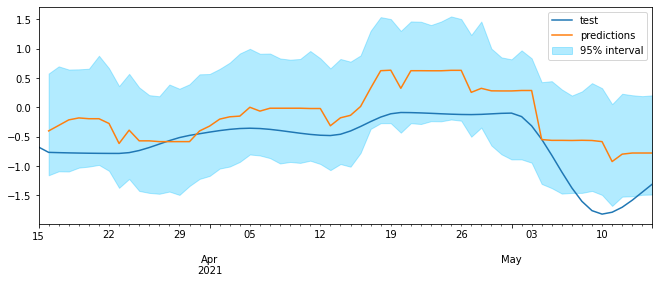

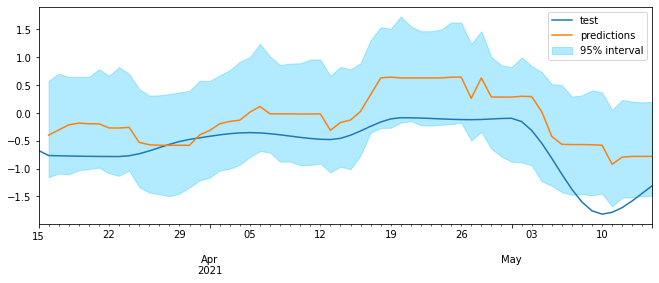

In [ ]:
mae_lgbm = np.zeros(len(steps))

# Multivariate without refit
for i, step in enumerate(steps):
    mae_lgbm[i] = evaluate_forecasting(data_andres_mellado_norm,data_test,forecaster,False,target,exogenous_var,step,
                                           lags_grid,param_grid,False,end_validation)

In [ ]:
mae_lgbm_bench

array([0.266102  , 0.44600152, 0.45843138, 0.45950067])

In [ ]:
mae_lgbm

array([0.25667405, 0.35888576, 0.46671489, 0.50017881])

Number of models compared: 216


loop param_grid:  56%|████████████████████                | 20/36 [00:32<00:25,  1.62s/it]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [06:27<00:00, 64.54s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 100}
  Backtesting metric: 0.23684531705993953

Forecaster will be fit 61 times. This can take substantial amounts of time. If not feasible, try with `refit = False`. 

Backtest error: 0.22140748925033366
Number of models compared: 216


loop param_grid:  56%|████████████████████                | 20/36 [00:07<00:05,  2.78it/s]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [01:26<00:00, 14.46s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  5 10 15 20 25 30] 
  Parameters: {'learning_rate': 0.001, 'max_depth': 4, 'n_estimators': 1000}
  Backtesting metric: 0.33916419866703584

Backtest error: 0.3576691458462498
Number of models compared: 216


loop param_grid:  42%|███████████████                     | 15/36 [00:03<00:05,  3.65it/s]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:58<00:00,  9.83s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  5 10 15 20 25 30] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 100}
  Backtesting metric: 0.44567080372267437

Backtest error: 0.38917031459556123
Number of models compared: 216


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:30<00:00,  5.10s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  5 10 20 30] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 100}
  Backtesting metric: 0.38437008232683906

Backtest error: 0.41700444154568495


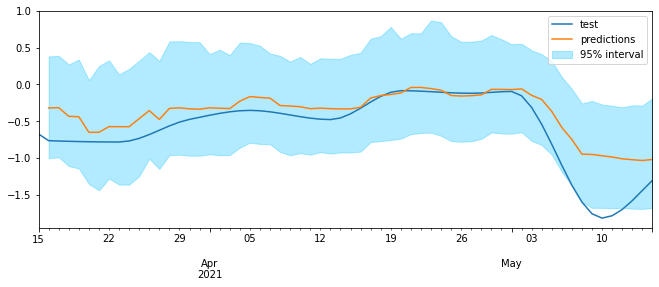

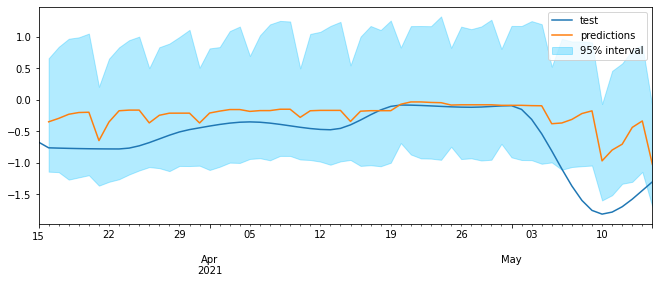

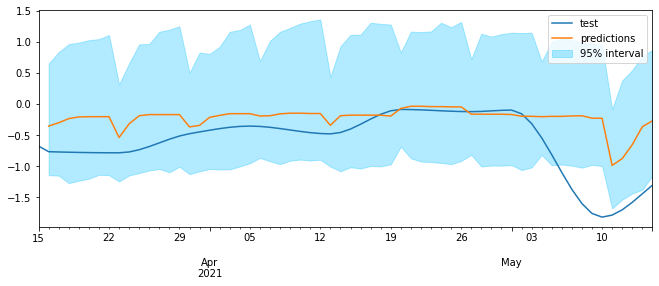

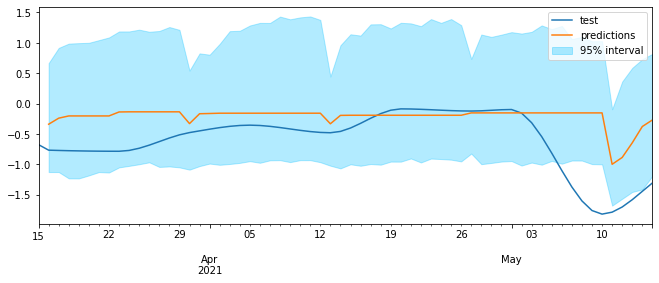

In [ ]:
#Array to store results
mae_lgbm_bench_refit = np.zeros(len(steps))

# Univariate without refit
for i, step in enumerate(steps):
    mae_lgbm_bench_refit[i] = evaluate_forecasting(data_andres_mellado_norm,data_test,forecaster,True,target,exogenous_var,step,
                                           lags_grid,param_grid,True,end_validation)

Number of models compared: 216


loop param_grid:  56%|████████████████████                | 20/36 [00:35<00:28,  1.76s/it]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [07:07<00:00, 71.20s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  5 10 15 20 25 30] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 1000}
  Backtesting metric: 0.2346600482342009

Forecaster will be fit 61 times. This can take substantial amounts of time. If not feasible, try with `refit = False`. 

Backtest error: 0.09050355774325668
Number of models compared: 216


loop param_grid:  56%|████████████████████                | 20/36 [00:08<00:06,  2.50it/s]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [01:35<00:00, 15.90s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  5 10 15 20 25 30] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 4, 'n_estimators': 500}
  Backtesting metric: 0.340197064105551

Backtest error: 0.21135181256666782
Number of models compared: 216


loop param_grid:  58%|█████████████████████               | 21/36 [00:06<00:05,  2.92it/s]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [01:05<00:00, 10.85s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  5 10 15 20 25 30] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 500}
  Backtesting metric: 0.3471257992351311

Backtest error: 0.26876975505251766
Number of models compared: 216


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:34<00:00,  5.68s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  5 10] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 100}
  Backtesting metric: 0.3024011637860586

Backtest error: 0.3570042268983767


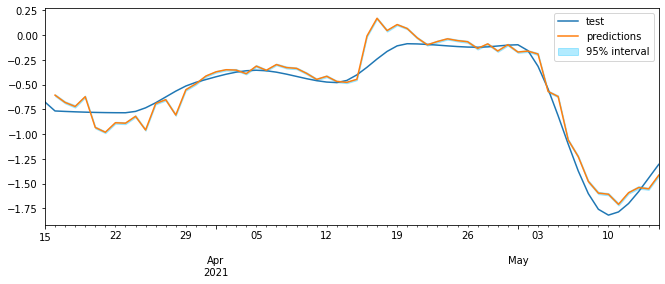

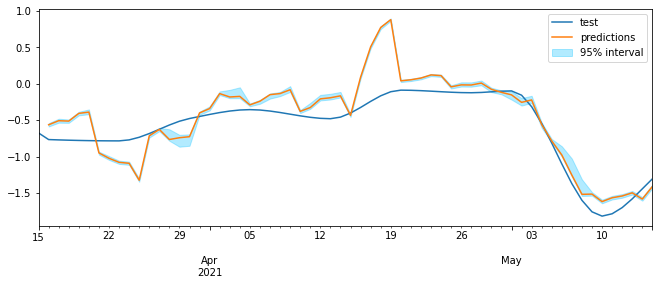

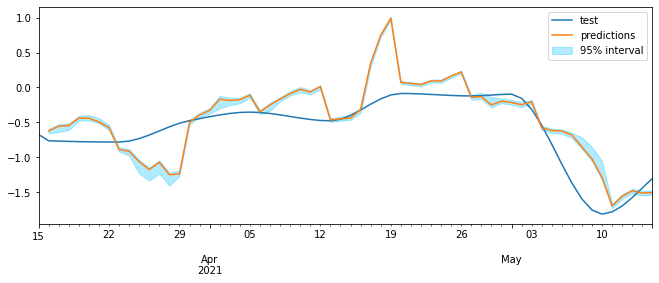

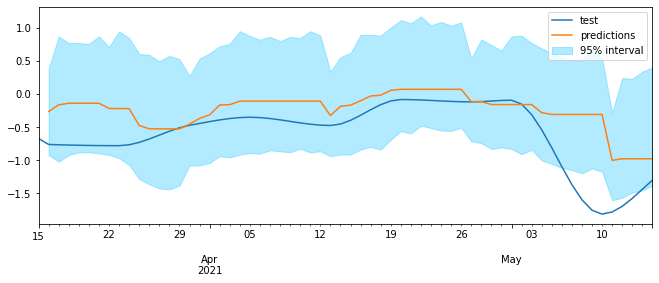

In [ ]:
mae_lgbm_refit = np.zeros(len(steps))

# Multivariate without refit
for i, step in enumerate(steps):
    mae_lgbm_refit[i] = evaluate_forecasting(data_andres_mellado_norm,data_test,forecaster,False,target,exogenous_var,step,
                                           lags_grid,param_grid,True,end_validation)

In [ ]:
mae_lgbm_bench_refit

array([0.22140749, 0.35766915, 0.38917031, 0.41700444])

In [ ]:
mae_lgbm_refit

array([0.09050356, 0.21135181, 0.26876976, 0.35700423])

#### SVR with contiguous CI

In [ ]:
forecaster = ForecasterAutoreg(
                regressor = SVR(),
                lags = 24
             )

param_grid = {
        'kernel': ('linear','poly'),
        'C':[1e-4,1e-2,1e-1],
        'gamma': [1e-4,1e-2,1e-1],
        'epsilon':[0.001,0.01,0.1]
        }

# Lags used as predictors
lags_grid = [5, 10, 15, [5, 10, 15], [5, 10, 20, 30], [5, 10, 15, 20, 25, 30]]

Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:08<00:00,  1.42s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'C': 0.1, 'epsilon': 0.001, 'gamma': 0.0001, 'kernel': 'linear'}
  Backtesting metric: 0.10610874113347975

Backtest error: 0.03851194306130454
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:04<00:00,  1.47it/s]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'C': 0.1, 'epsilon': 0.1, 'gamma': 0.0001, 'kernel': 'linear'}
  Backtesting metric: 0.30227608878171824

Backtest error: 0.14900869869230618
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:03<00:00,  1.65it/s]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'C': 0.01, 'epsilon': 0.1, 'gamma': 0.01, 'kernel': 'linear'}
  Backtesting metric: 0.5027198036043041

Backtest error: 0.25648363884130887
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:03<00:00,  1.85it/s]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'C': 0.01, 'epsilon': 0.001, 'gamma': 0.0001, 'kernel': 'linear'}
  Backtesting metric: 0.463002604500295

Backtest error: 0.2714099854366446


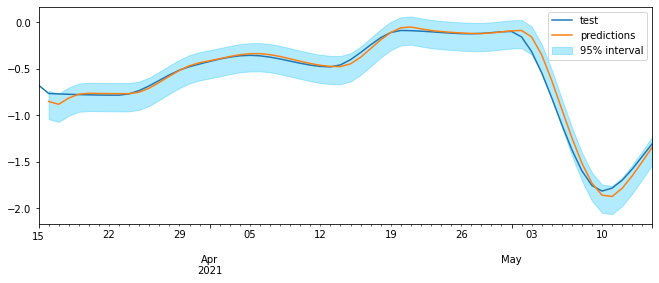

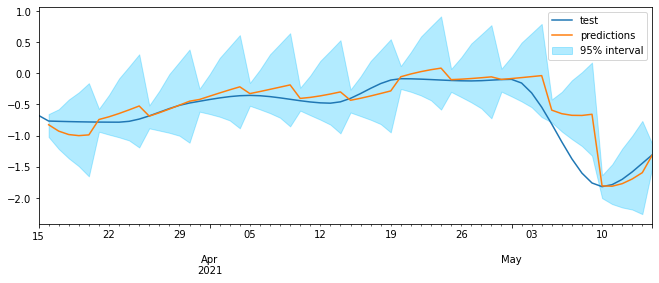

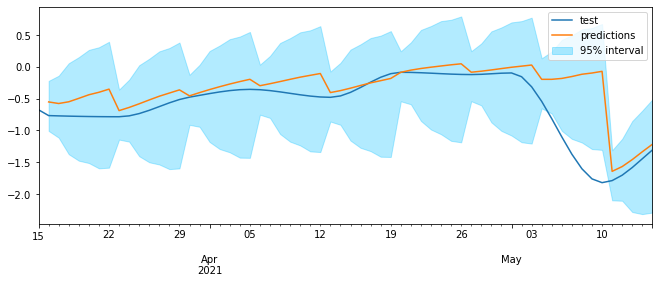

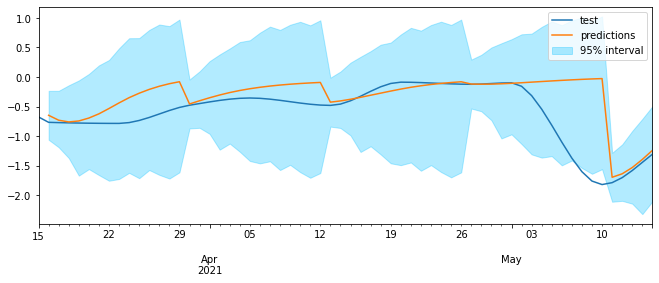

In [ ]:
#Array to store results
mae_svr_bench = np.zeros(len(steps))

# Univariate without refit
for i, step in enumerate(steps):
    mae_svr_bench[i] = evaluate_forecasting(data_andres_mellado_norm,data_test,forecaster,True,target,exogenous_var,step,
                                           lags_grid,param_grid,False,end_validation)

Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:20<00:00,  3.50s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'C': 0.1, 'epsilon': 0.001, 'gamma': 0.1, 'kernel': 'linear'}
  Backtesting metric: 0.11415251127311825

Backtest error: 0.047101203549415376
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:07<00:00,  1.23s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'C': 0.1, 'epsilon': 0.1, 'gamma': 0.01, 'kernel': 'linear'}
  Backtesting metric: 0.26747019137773226

Backtest error: 0.1985989310387544
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:06<00:00,  1.00s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 5 10 15] 
  Parameters: {'C': 0.1, 'epsilon': 0.1, 'gamma': 0.01, 'kernel': 'linear'}
  Backtesting metric: 0.29204821667657566

Backtest error: 0.27327193693674845
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:04<00:00,  1.26it/s]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 5 10 15] 
  Parameters: {'C': 0.1, 'epsilon': 0.1, 'gamma': 0.1, 'kernel': 'linear'}
  Backtesting metric: 0.2921252936789293

Backtest error: 0.28811467824929704


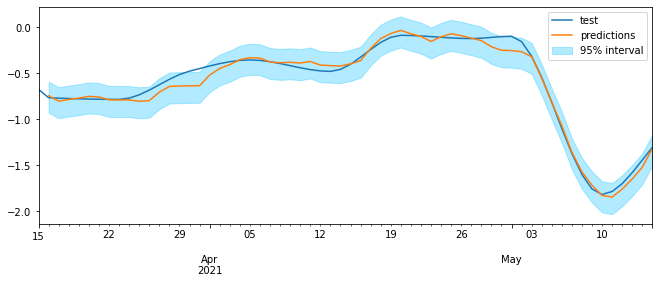

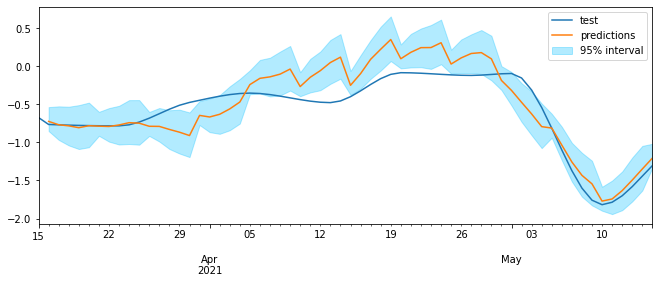

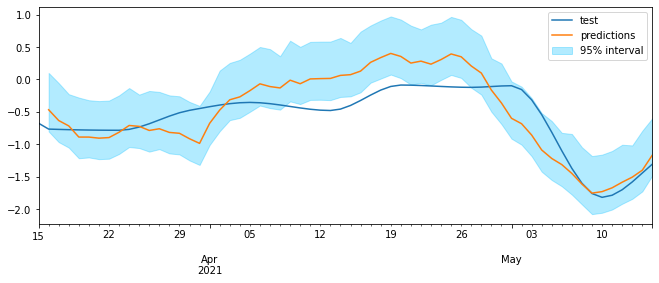

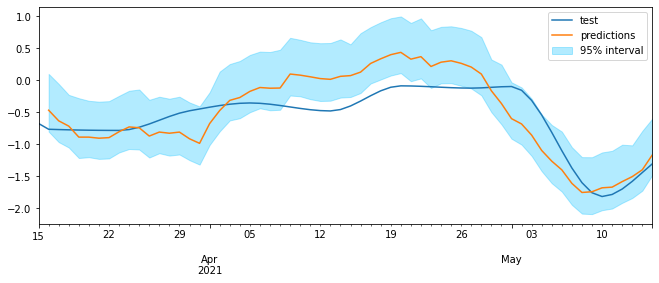

In [ ]:
mae_svr = np.zeros(len(steps))

# Multivariate without refit
for i, step in enumerate(steps):
    mae_svr[i] = evaluate_forecasting(data_andres_mellado_norm,data_test,forecaster,False,target,exogenous_var,step,
                                           lags_grid,param_grid,False,end_validation)

In [ ]:
mae_svr_bench

array([0.03851194, 0.1490087 , 0.25648364, 0.27140999])

In [ ]:
mae_svr

array([0.0471012 , 0.19859893, 0.27327194, 0.28811468])

Number of models compared: 324


loop param_grid:   7%|██▋                                  | 4/54 [00:00<00:07,  6.80it/s]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:49<00:00,  8.28s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'C': 0.1, 'epsilon': 0.001, 'gamma': 0.0001, 'kernel': 'linear'}
  Backtesting metric: 0.1040833990232011

Forecaster will be fit 61 times. This can take substantial amounts of time. If not feasible, try with `refit = False`. 

Backtest error: 0.03803466625099158
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:11<00:00,  1.93s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'C': 0.1, 'epsilon': 0.1, 'gamma': 0.1, 'kernel': 'linear'}
  Backtesting metric: 0.3016080289438854

Backtest error: 0.15541579107159628
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:08<00:00,  1.35s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'C': 0.01, 'epsilon': 0.1, 'gamma': 0.0001, 'kernel': 'linear'}
  Backtesting metric: 0.5192641113323485

Backtest error: 0.24877679971917452
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:04<00:00,  1.29it/s]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10] 
  Parameters: {'C': 0.01, 'epsilon': 0.1, 'gamma': 0.0001, 'kernel': 'linear'}
  Backtesting metric: 0.43200326237531245

Backtest error: 0.32274835825685116


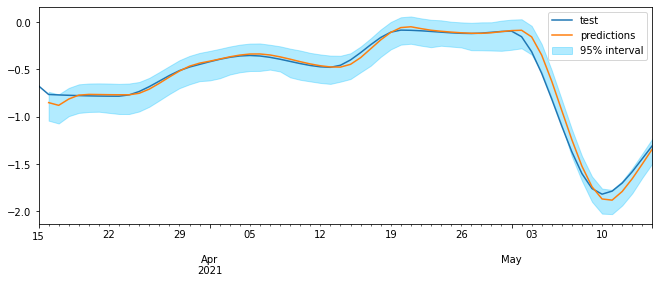

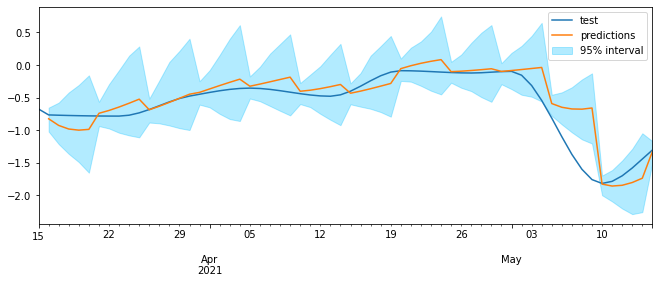

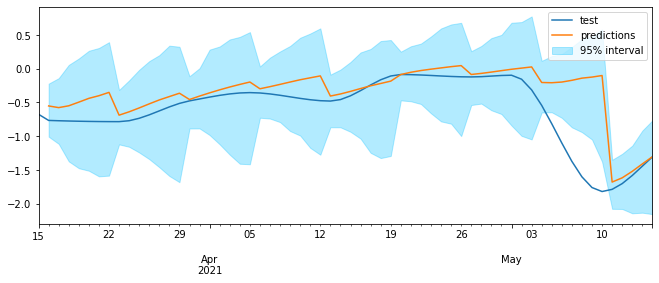

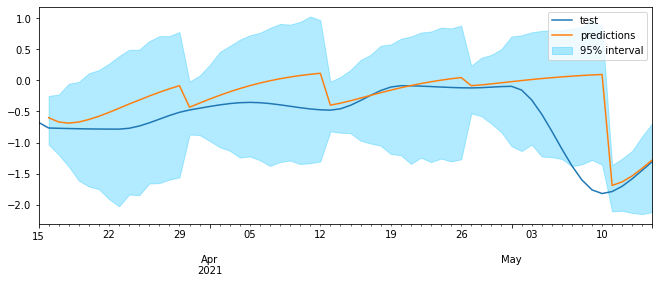

In [ ]:
#Array to store results
mae_svr_bench_v2 = np.zeros(len(steps))

# Univariate without refit
for i, step in enumerate(steps):
    mae_svr_bench_v2[i] = evaluate_forecasting(data_andres_mellado_norm,data_test,forecaster,True,target,exogenous_var,step,
                                           lags_grid,param_grid,True,end_validation)

Number of models compared: 324


loop param_grid:   7%|██▋                                  | 4/54 [00:00<00:10,  4.95it/s]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [01:10<00:00, 11.83s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'C': 0.1, 'epsilon': 0.001, 'gamma': 0.01, 'kernel': 'linear'}
  Backtesting metric: 0.11176006996164693

Forecaster will be fit 61 times. This can take substantial amounts of time. If not feasible, try with `refit = False`. 

Backtest error: 0.045095409224375264
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:16<00:00,  2.72s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'C': 0.1, 'epsilon': 0.1, 'gamma': 0.01, 'kernel': 'linear'}
  Backtesting metric: 0.2615813164835685

Backtest error: 0.1730626683343575
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:11<00:00,  1.92s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 5 10 15] 
  Parameters: {'C': 0.1, 'epsilon': 0.1, 'gamma': 0.1, 'kernel': 'linear'}
  Backtesting metric: 0.31944268757834765

Backtest error: 0.2659511133570252
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:06<00:00,  1.05s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 5 10 15] 
  Parameters: {'C': 0.1, 'epsilon': 0.1, 'gamma': 0.1, 'kernel': 'linear'}
  Backtesting metric: 0.2953928196028682

Backtest error: 0.3013282875396622


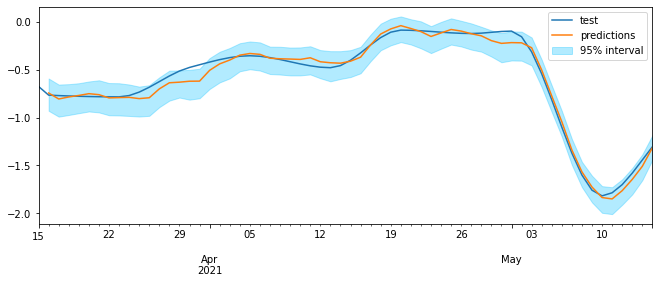

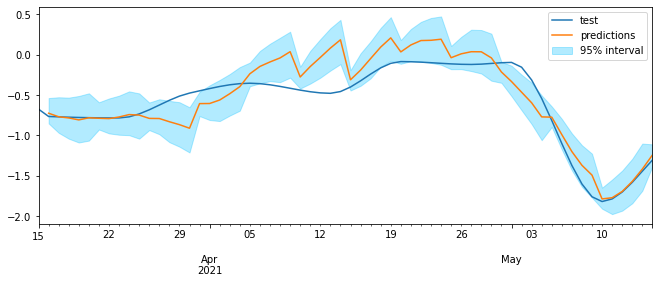

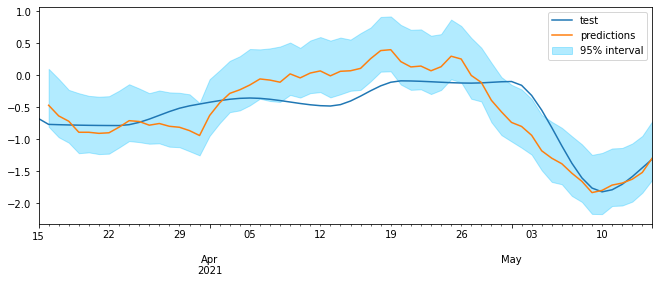

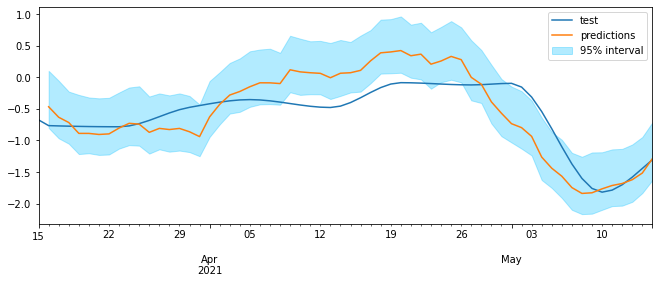

In [ ]:
mae_svr_v2 = np.zeros(len(steps))

# Multivariate without refit
for i, step in enumerate(steps):
    mae_svr_v2[i] = evaluate_forecasting(data_andres_mellado_norm,data_test,forecaster,False,target,exogenous_var,step,
                                           lags_grid,param_grid,True,end_validation)

In [ ]:
mae_svr_bench_v2

array([0.03803467, 0.15541579, 0.2487768 , 0.32274836])

In [ ]:
mae_svr_v2

array([0.04509541, 0.17306267, 0.26595111, 0.30132829])

#### XGBRegressor without contiguous CI

In [ ]:
data_andres_mellado_norm = data_andres_mellado_norm.drop('ia_guzman_el_bueno',axis=1)

In [ ]:
exogenous_var = data_andres_mellado_norm.loc[:,data_andres_mellado_norm.columns != 'ia_andres_mellado'].columns

Number of models compared: 216


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:23<00:00,  3.86s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  5 10 20 30] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 100}
  Backtesting metric: 0.21733512799522484

Backtest error: 0.26610199879662516
Number of models compared: 216


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:17<00:00,  2.94s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  5 10 20 30] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 4, 'n_estimators': 100}
  Backtesting metric: 0.21754448009815805

Backtest error: 0.44600152055323733
Number of models compared: 216


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:17<00:00,  2.88s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  5 10 20 30] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 4, 'n_estimators': 100}
  Backtesting metric: 0.3455349201178834

Backtest error: 0.45843137640628406
Number of models compared: 216


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:16<00:00,  2.81s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  5 10 20 30] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 4, 'n_estimators': 100}
  Backtesting metric: 0.3455349201178834

Backtest error: 0.45950067191104543


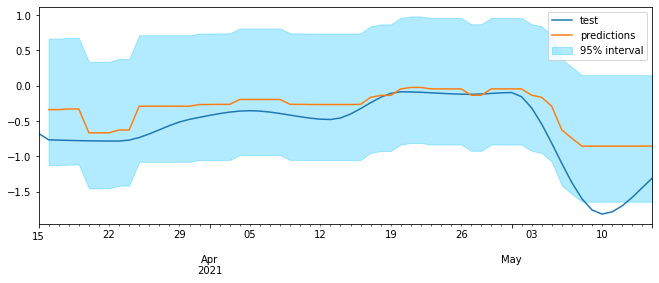

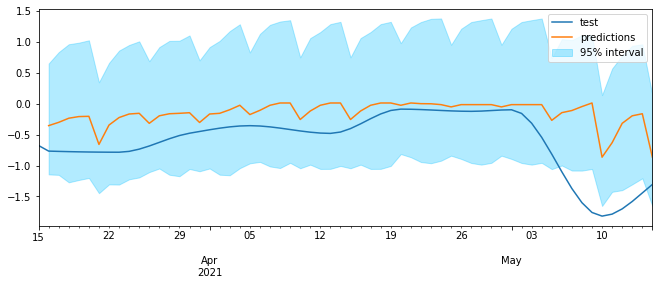

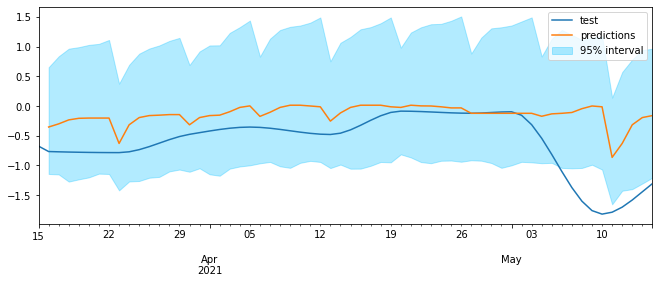

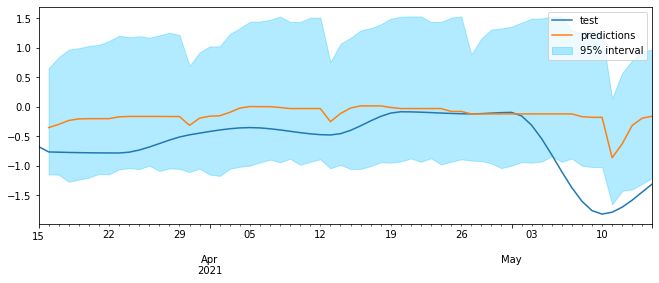

In [ ]:
#Array to store results
mae_xgb_bench_v2 = np.zeros(len(steps))

# Univariate without refit
for i, step in enumerate(steps):
    mae_xgb_bench_v2[i] = evaluate_forecasting(data_andres_mellado_norm,data_test,forecaster,True,target,exogenous_var,step,
                                           lags_grid,param_grid,False,end_validation)

Number of models compared: 216


loop param_grid:  58%|█████████████████████               | 21/36 [00:03<00:02,  5.65it/s]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:36<00:00,  6.15s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  5 10 15 20 25 30] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 100}
  Backtesting metric: 0.21733512799522484

Backtest error: 0.26568230715551794
Number of models compared: 216


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:21<00:00,  3.51s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  5 10 15 20 25 30] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 100}
  Backtesting metric: 0.2175448375446421

Backtest error: 0.4269307801667397
Number of models compared: 216


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:20<00:00,  3.37s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  5 10 20 30] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 100}
  Backtesting metric: 0.34553498897493284

Backtest error: 0.4428535315734171
Number of models compared: 216


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:18<00:00,  3.09s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  5 10 20 30] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 100}
  Backtesting metric: 0.34553498897493284

Backtest error: 0.458899937767242


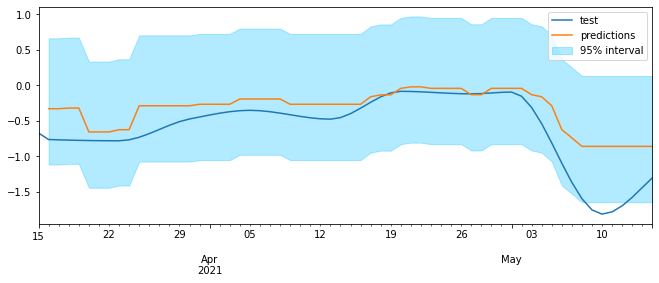

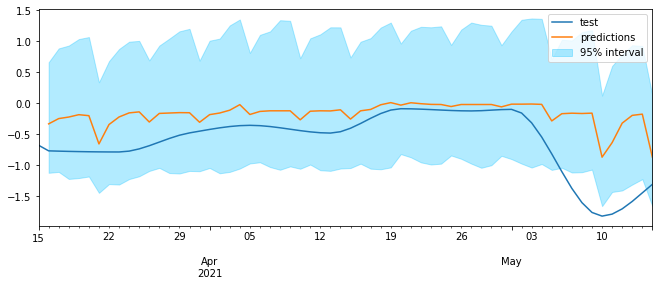

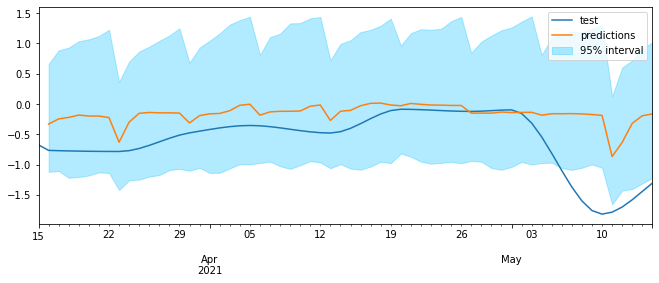

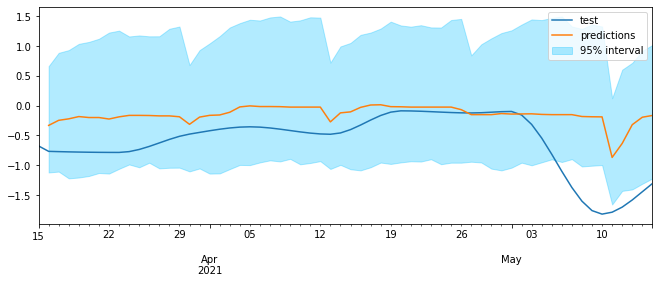

In [ ]:
mae_xgb_v2 = np.zeros(len(steps))

# Multivariate without refit
for i, step in enumerate(steps):
    mae_xgb_v2[i] = evaluate_forecasting(data_andres_mellado_norm,data_test,forecaster,False,target,exogenous_var,step,
                                           lags_grid,param_grid,False,end_validation)

In [ ]:
mae_xgb_bench_v2

array([0.266102  , 0.44600152, 0.45843138, 0.45950067])

In [ ]:
mae_xgb_v2

array([0.26568231, 0.42693078, 0.44285353, 0.45889994])

Number of models compared: 216


loop param_grid:  56%|████████████████████                | 20/36 [00:32<00:25,  1.58s/it]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [06:27<00:00, 64.62s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 100}
  Backtesting metric: 0.23684531705993953

Forecaster will be fit 61 times. This can take substantial amounts of time. If not feasible, try with `refit = False`. 

Backtest error: 0.22140748925033366
Number of models compared: 216


loop param_grid:  56%|████████████████████                | 20/36 [00:07<00:05,  2.76it/s]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [01:27<00:00, 14.56s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  5 10 15 20 25 30] 
  Parameters: {'learning_rate': 0.001, 'max_depth': 4, 'n_estimators': 1000}
  Backtesting metric: 0.33916419866703584

Backtest error: 0.3576691458462498
Number of models compared: 216


loop param_grid:  47%|█████████████████                   | 17/36 [00:04<00:04,  4.13it/s]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:59<00:00,  9.87s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  5 10 15 20 25 30] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 100}
  Backtesting metric: 0.44567080372267437

Backtest error: 0.38917031459556123
Number of models compared: 216


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:31<00:00,  5.19s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  5 10 20 30] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 100}
  Backtesting metric: 0.38437008232683906

Backtest error: 0.41700444154568495


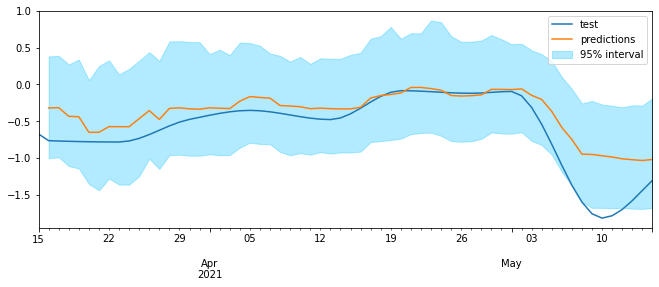

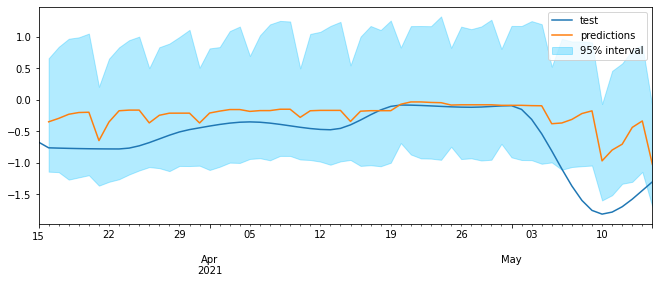

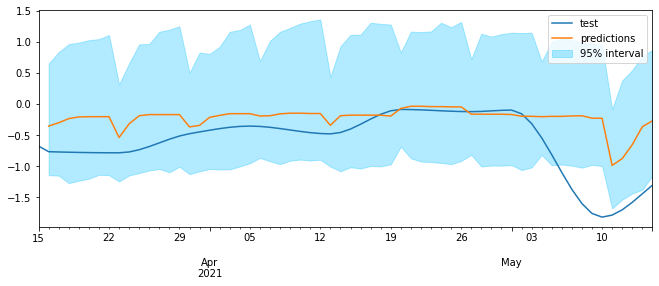

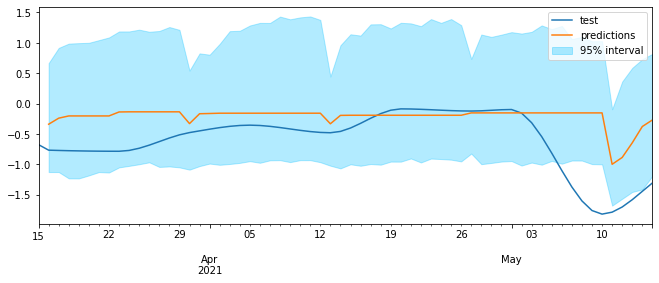

In [ ]:
#Array to store results
mae_xgb_bench_refit_v2 = np.zeros(len(steps))

# Univariate without refit
for i, step in enumerate(steps):
    mae_xgb_bench_refit_v2[i] = evaluate_forecasting(data_andres_mellado_norm,data_test,forecaster,True,target,exogenous_var,step,
                                           lags_grid,param_grid,True,end_validation)

Number of models compared: 216


loop param_grid:  56%|████████████████████                | 20/36 [00:35<00:27,  1.74s/it]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [07:02<00:00, 70.50s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  5 10 15 20 25 30] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 4, 'n_estimators': 500}
  Backtesting metric: 0.2406562756279625

Forecaster will be fit 61 times. This can take substantial amounts of time. If not feasible, try with `refit = False`. 

Backtest error: 0.10225527973332083
Number of models compared: 216


loop param_grid:  56%|████████████████████                | 20/36 [00:07<00:06,  2.56it/s]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [01:34<00:00, 15.77s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  5 10 15 20 25 30] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 100}
  Backtesting metric: 0.33884727505226964

Backtest error: 0.36387571859894674
Number of models compared: 216


loop param_grid:  58%|█████████████████████               | 21/36 [00:05<00:05,  2.99it/s]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [01:04<00:00, 10.79s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  5 10 20 30] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 100}
  Backtesting metric: 0.39038936586845246

Backtest error: 0.28701069572924814
Number of models compared: 216


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:33<00:00,  5.54s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  5 10 15 20 25 30] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 100}
  Backtesting metric: 0.38437008232683906

Backtest error: 0.41880599351865444


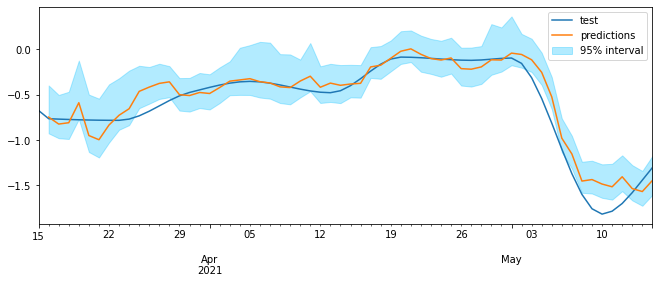

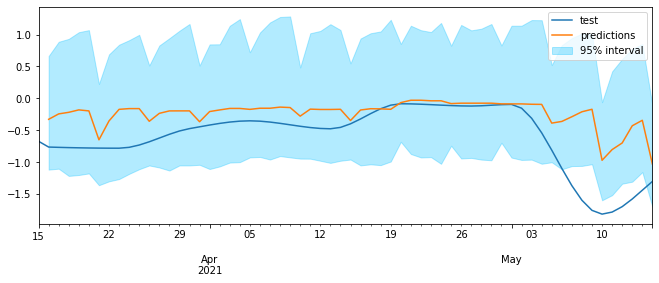

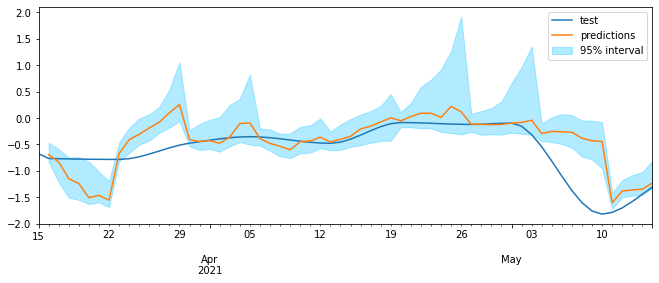

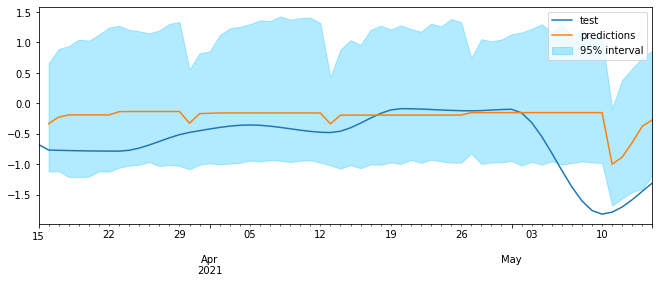

In [ ]:
mae_xgb_refit_v2 = np.zeros(len(steps))

# Multivariate without refit
for i, step in enumerate(steps):
    mae_xgb_refit_v2[i] = evaluate_forecasting(data_andres_mellado_norm,data_test,forecaster,False,target,exogenous_var,step,
                                           lags_grid,param_grid,True,end_validation)

In [ ]:
mae_xgb_bench_refit

array([0.04383696, 0.15915126, 0.28711429, 0.65459352])

In [ ]:
mae_xgb_refit

array([0.18103353, 0.31385661, 0.27245445, 0.38178685])

#### LGBMRegressor without contiguous CI

In [ ]:
forecaster = ForecasterAutoreg(
                regressor = LGBMRegressor(random_state=123),
                lags = 24
             )

param_grid = {
    'n_estimators': [100, 500, 1000],
    'max_depth': [2,3,4,5],
    'learning_rate': [0.001,0.01, 0.1]
    }

# Lags used as predictors
lags_grid = [5, 10, 15, [1, 2, 5, 10], [1, 5, 10, 20, 30], [1, 5, 10, 15, 20, 25, 30]]

Number of models compared: 216


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:23<00:00,  3.84s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  5 10 20 30] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 100}
  Backtesting metric: 0.21733512799522484

Backtest error: 0.26610199879662516
Number of models compared: 216


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:17<00:00,  2.98s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  5 10 20 30] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 4, 'n_estimators': 100}
  Backtesting metric: 0.21754448009815805

Backtest error: 0.44600152055323733
Number of models compared: 216


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:18<00:00,  3.12s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  5 10 20 30] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 4, 'n_estimators': 100}
  Backtesting metric: 0.3455349201178834

Backtest error: 0.45843137640628406
Number of models compared: 216


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:16<00:00,  2.82s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  5 10 20 30] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 4, 'n_estimators': 100}
  Backtesting metric: 0.3455349201178834

Backtest error: 0.45950067191104543


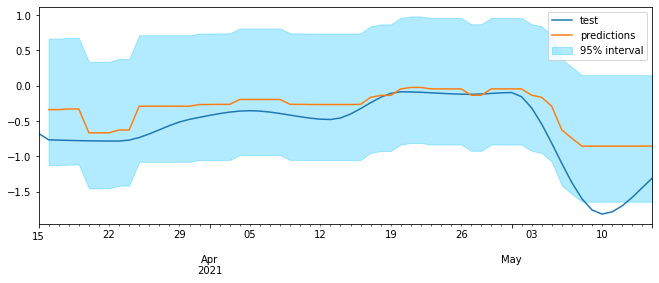

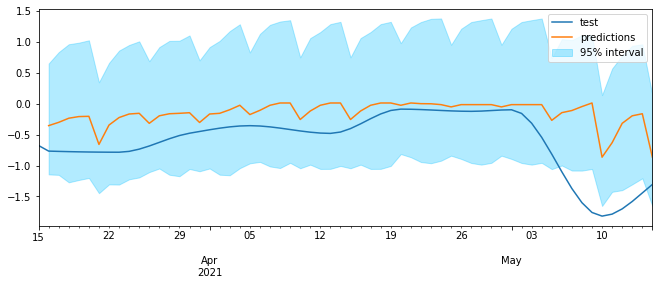

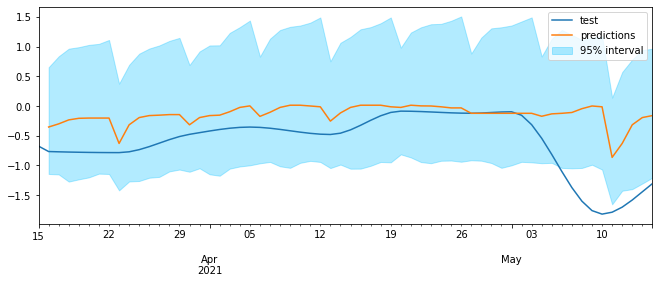

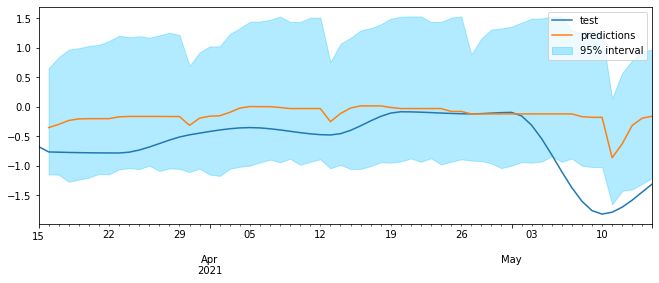

In [ ]:
#Array to store results
mae_lgbm_bench_v2 = np.zeros(len(steps))

# Univariate without refit
for i, step in enumerate(steps):
    mae_lgbm_bench_v2[i] = evaluate_forecasting(data_andres_mellado_norm,data_test,forecaster,True,target,exogenous_var,step,
                                           lags_grid,param_grid,False,end_validation)

Number of models compared: 216


loop param_grid:  58%|█████████████████████               | 21/36 [00:03<00:02,  5.65it/s]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:37<00:00,  6.25s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  5 10 15 20 25 30] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 100}
  Backtesting metric: 0.21733512799522484

Backtest error: 0.26568230715551794
Number of models compared: 216


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:21<00:00,  3.52s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  5 10 15 20 25 30] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 100}
  Backtesting metric: 0.2175448375446421

Backtest error: 0.4269307801667397
Number of models compared: 216


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:20<00:00,  3.34s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  5 10 20 30] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 100}
  Backtesting metric: 0.34553498897493284

Backtest error: 0.4428535315734171
Number of models compared: 216


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:18<00:00,  3.10s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  5 10 20 30] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 100}
  Backtesting metric: 0.34553498897493284

Backtest error: 0.458899937767242


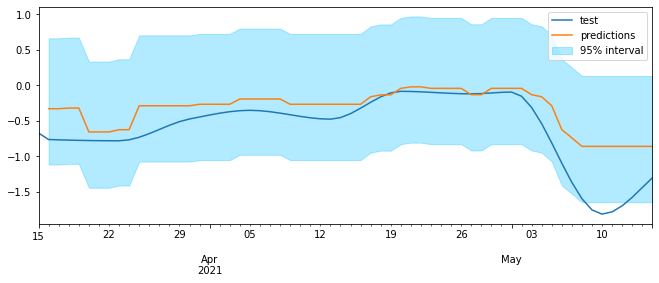

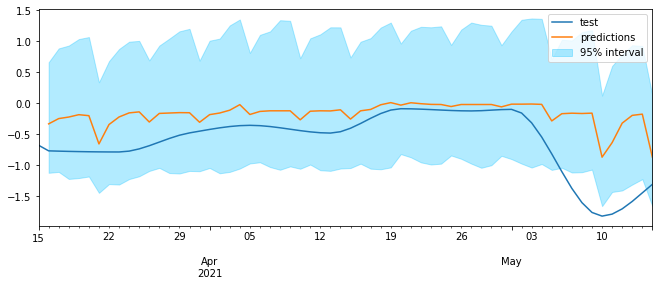

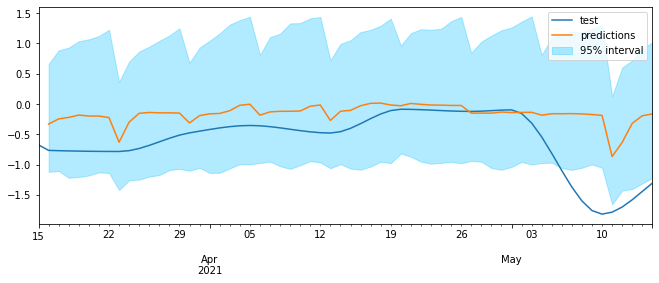

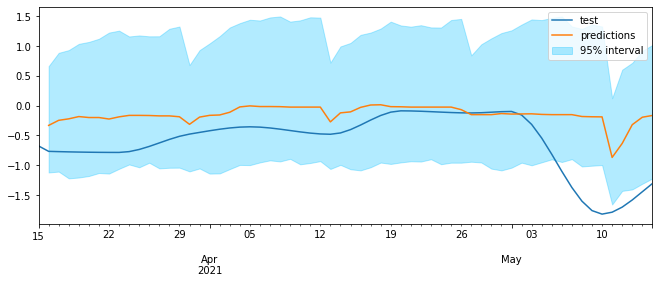

In [ ]:
mae_lgbm_v2 = np.zeros(len(steps))

# Multivariate without refit
for i, step in enumerate(steps):
    mae_lgbm_v2[i] = evaluate_forecasting(data_andres_mellado_norm,data_test,forecaster,False,target,exogenous_var,step,
                                           lags_grid,param_grid,False,end_validation)

In [ ]:
mae_lgbm_bench_v2

array([0.266102  , 0.44600152, 0.45843138, 0.45950067])

In [ ]:
mae_lgbm_v2

array([0.26568231, 0.42693078, 0.44285353, 0.45889994])

Number of models compared: 216


loop param_grid:  56%|████████████████████                | 20/36 [00:32<00:25,  1.58s/it]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [06:28<00:00, 64.75s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 100}
  Backtesting metric: 0.23684531705993953

Forecaster will be fit 61 times. This can take substantial amounts of time. If not feasible, try with `refit = False`. 

Backtest error: 0.22140748925033366
Number of models compared: 216


loop param_grid:  56%|████████████████████                | 20/36 [00:07<00:05,  2.71it/s]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [01:30<00:00, 15.12s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  5 10 15 20 25 30] 
  Parameters: {'learning_rate': 0.001, 'max_depth': 4, 'n_estimators': 1000}
  Backtesting metric: 0.33916419866703584

Backtest error: 0.3576691458462498
Number of models compared: 216


loop param_grid:  14%|█████▏                               | 5/36 [00:01<00:06,  4.60it/s]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:59<00:00,  9.99s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  5 10 15 20 25 30] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 100}
  Backtesting metric: 0.44567080372267437

Backtest error: 0.38917031459556123
Number of models compared: 216


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:31<00:00,  5.25s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  5 10 20 30] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 100}
  Backtesting metric: 0.38437008232683906

Backtest error: 0.41700444154568495


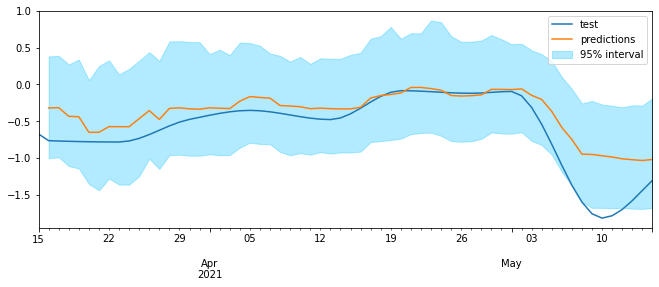

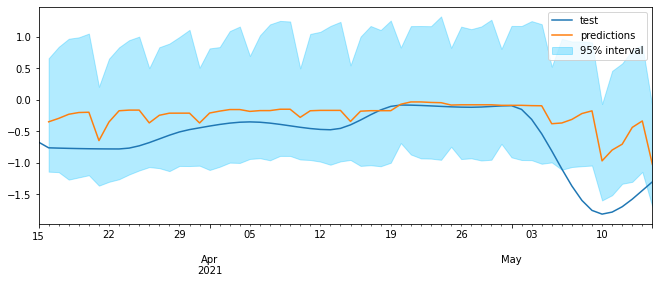

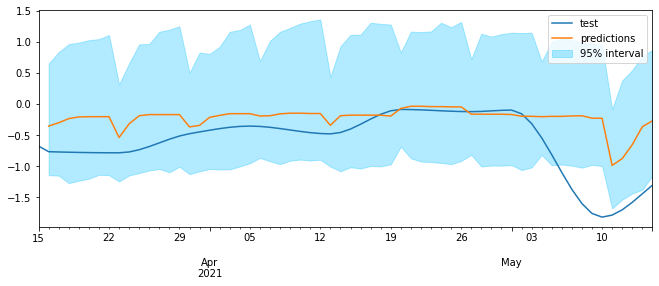

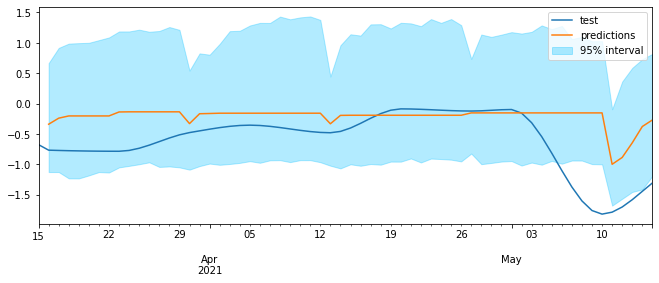

In [ ]:
#Array to store results
mae_lgbm_bench_refit_v2 = np.zeros(len(steps))

# Univariate without refit
for i, step in enumerate(steps):
    mae_lgbm_bench_refit_v2[i] = evaluate_forecasting(data_andres_mellado_norm,data_test,forecaster,True,target,exogenous_var,step,
                                           lags_grid,param_grid,True,end_validation)

Number of models compared: 216


loop param_grid:  56%|████████████████████                | 20/36 [00:35<00:27,  1.75s/it]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [07:15<00:00, 72.54s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  5 10 15 20 25 30] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 4, 'n_estimators': 500}
  Backtesting metric: 0.2406562756279625

Forecaster will be fit 61 times. This can take substantial amounts of time. If not feasible, try with `refit = False`. 

Backtest error: 0.10225527973332083
Number of models compared: 216


loop param_grid:  56%|████████████████████                | 20/36 [00:08<00:06,  2.54it/s]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [01:35<00:00, 15.94s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  5 10 15 20 25 30] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 100}
  Backtesting metric: 0.33884727505226964

Backtest error: 0.36387571859894674
Number of models compared: 216


loop param_grid:  58%|█████████████████████               | 21/36 [00:06<00:05,  2.95it/s]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [01:05<00:00, 10.93s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  5 10 20 30] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 100}
  Backtesting metric: 0.39038936586845246

Backtest error: 0.28701069572924814
Number of models compared: 216


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:33<00:00,  5.64s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  5 10 15 20 25 30] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 100}
  Backtesting metric: 0.38437008232683906

Backtest error: 0.41880599351865444


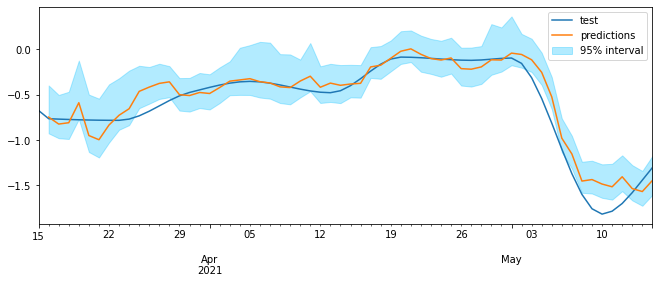

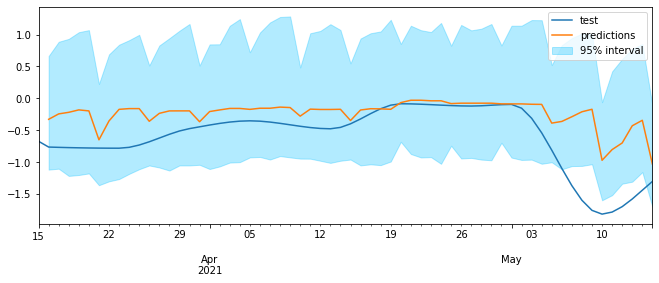

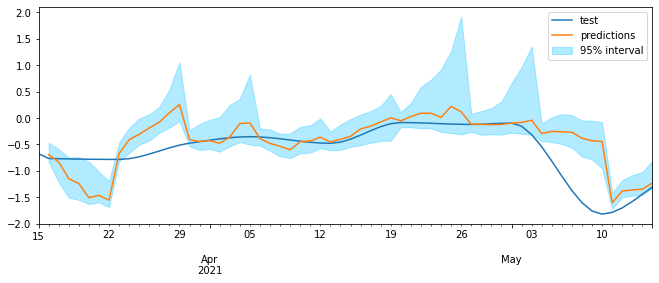

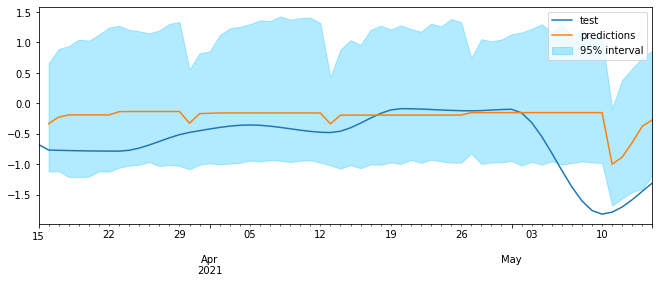

In [ ]:
mae_lgbm_refit_v2 = np.zeros(len(steps))

# Multivariate without refit
for i, step in enumerate(steps):
    mae_lgbm_refit_v2[i] = evaluate_forecasting(data_andres_mellado_norm,data_test,forecaster,False,target,exogenous_var,step,
                                           lags_grid,param_grid,True,end_validation)

In [ ]:
mae_lgbm_bench_refit_v2

array([0.22140749, 0.35766915, 0.38917031, 0.41700444])

In [ ]:
mae_lgbm_refit_v2

array([0.10225528, 0.36387572, 0.2870107 , 0.41880599])

#### SVR

In [ ]:
forecaster = ForecasterAutoreg(
                regressor = SVR(),
                lags = 24
             )

param_grid = {
        'kernel': ('linear','poly'),
        'C':[1e-4,1e-2,1e-1],
        'gamma': [1e-4,1e-2,1e-1],
        'epsilon':[0.001,0.01,0.1]
        }

# Lags used as predictors
lags_grid = [5, 10, 15, [5, 10, 15], [5, 10, 20, 30], [5, 10, 15, 20, 25, 30]]

Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:07<00:00,  1.20s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'C': 0.1, 'epsilon': 0.001, 'gamma': 0.0001, 'kernel': 'linear'}
  Backtesting metric: 0.10610874113347975

Backtest error: 0.03851194306130454
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:03<00:00,  1.67it/s]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'C': 0.1, 'epsilon': 0.1, 'gamma': 0.0001, 'kernel': 'linear'}
  Backtesting metric: 0.30227608878171824

Backtest error: 0.14900869869230618
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:03<00:00,  1.76it/s]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'C': 0.01, 'epsilon': 0.1, 'gamma': 0.01, 'kernel': 'linear'}
  Backtesting metric: 0.5027198036043041

Backtest error: 0.25648363884130887
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:02<00:00,  2.08it/s]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'C': 0.01, 'epsilon': 0.001, 'gamma': 0.0001, 'kernel': 'linear'}
  Backtesting metric: 0.463002604500295

Backtest error: 0.2714099854366446


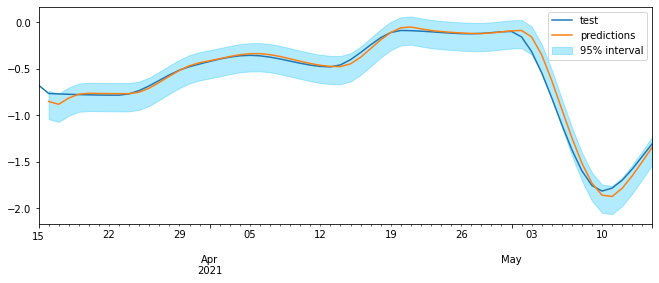

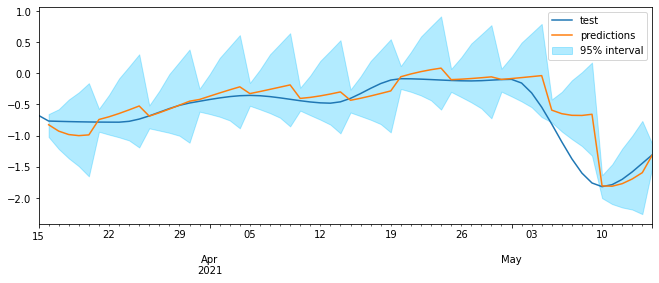

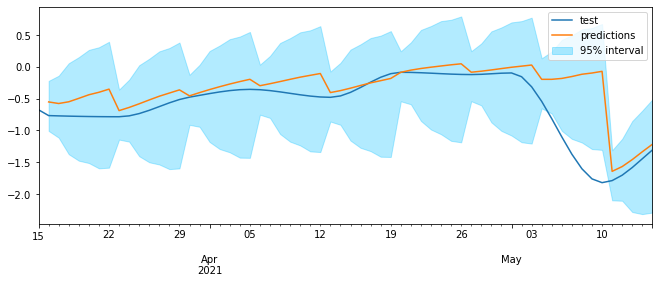

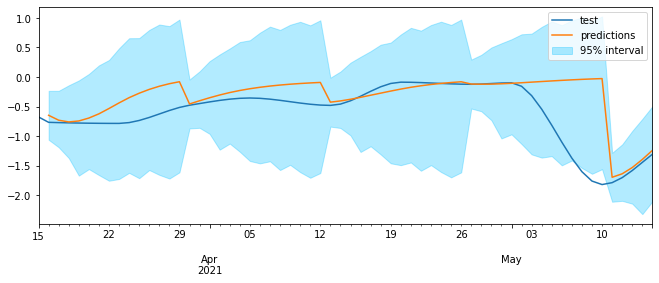

In [ ]:
#Array to store results
mae_svm_bench = np.zeros(len(steps))

# Univariate without refit
for i, step in enumerate(steps):
    mae_svm_bench[i] = evaluate_forecasting(data_andres_mellado_norm,data_test,forecaster,True,target,exogenous_var,step,
                                           lags_grid,param_grid,False,end_validation)

Number of models compared: 324


loop param_grid: 100%|████████████████████████████████████| 54/54 [00:02<00:00, 18.90it/s]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:18<00:00,  3.05s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'C': 0.1, 'epsilon': 0.001, 'gamma': 0.1, 'kernel': 'linear'}
  Backtesting metric: 0.11415251127311825

Backtest error: 0.047101203549415376
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:06<00:00,  1.02s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'C': 0.1, 'epsilon': 0.1, 'gamma': 0.01, 'kernel': 'linear'}
  Backtesting metric: 0.26747019137773226

Backtest error: 0.1985989310387544
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:04<00:00,  1.20it/s]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 5 10 15] 
  Parameters: {'C': 0.1, 'epsilon': 0.1, 'gamma': 0.01, 'kernel': 'linear'}
  Backtesting metric: 0.29204821667657566

Backtest error: 0.27327193693674845
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:03<00:00,  1.52it/s]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 5 10 15] 
  Parameters: {'C': 0.1, 'epsilon': 0.1, 'gamma': 0.1, 'kernel': 'linear'}
  Backtesting metric: 0.2921252936789293

Backtest error: 0.28811467824929704


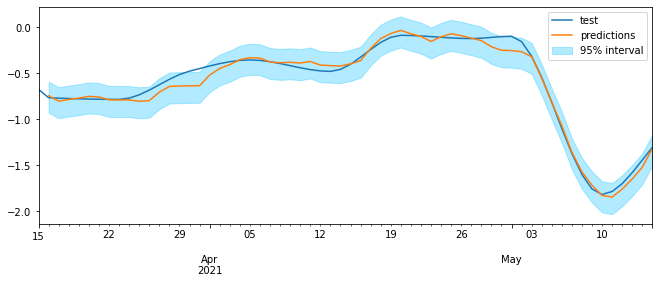

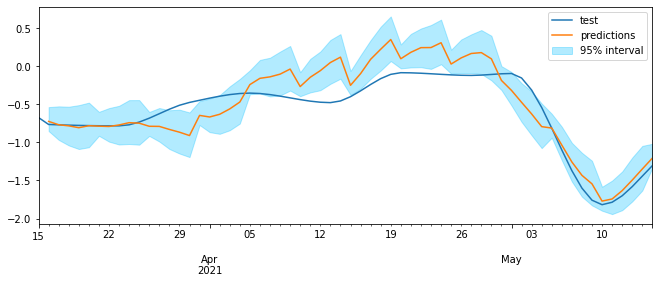

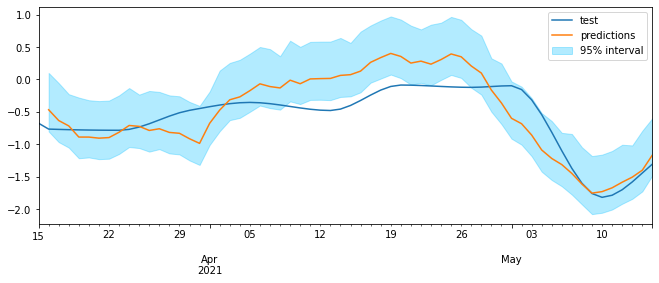

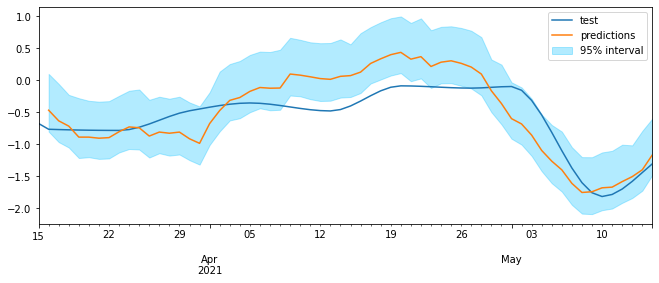

In [ ]:
#Array to store results
mae_svm = np.zeros(len(steps))

for i, step in enumerate(steps):
    mae_svm[i] = evaluate_forecasting(data_andres_mellado_norm,data_test,forecaster,False,target,exogenous_var,step,
                                           lags_grid,param_grid,False,end_validation)

In [ ]:
mae_svm_bench

array([0.03851194, 0.1490087 , 0.25648364, 0.27140999])

In [ ]:
mae_svm

array([0.0471012 , 0.19859893, 0.27327194, 0.28811468])

Number of models compared: 324


loop param_grid:   7%|██▋                                  | 4/54 [00:00<00:06,  7.72it/s]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:42<00:00,  7.15s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'C': 0.1, 'epsilon': 0.001, 'gamma': 0.0001, 'kernel': 'linear'}
  Backtesting metric: 0.1040833990232011

Forecaster will be fit 61 times. This can take substantial amounts of time. If not feasible, try with `refit = False`. 

Backtest error: 0.03803466625099158
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:10<00:00,  1.67s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'C': 0.1, 'epsilon': 0.1, 'gamma': 0.1, 'kernel': 'linear'}
  Backtesting metric: 0.3016080289438854

Backtest error: 0.15541579107159628
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:07<00:00,  1.18s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'C': 0.01, 'epsilon': 0.1, 'gamma': 0.0001, 'kernel': 'linear'}
  Backtesting metric: 0.5192641113323485

Backtest error: 0.24877679971917452
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:04<00:00,  1.48it/s]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10] 
  Parameters: {'C': 0.01, 'epsilon': 0.1, 'gamma': 0.0001, 'kernel': 'linear'}
  Backtesting metric: 0.43200326237531245

Backtest error: 0.32274835825685116


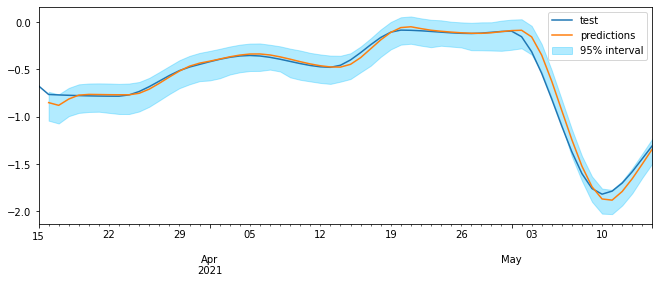

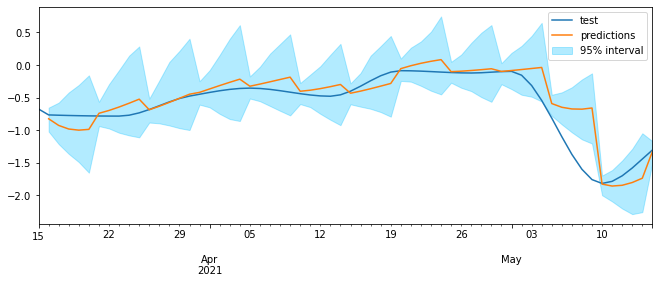

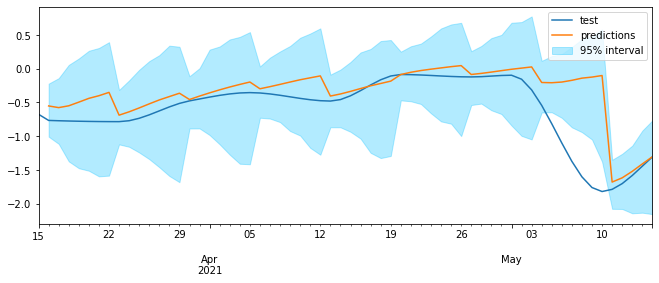

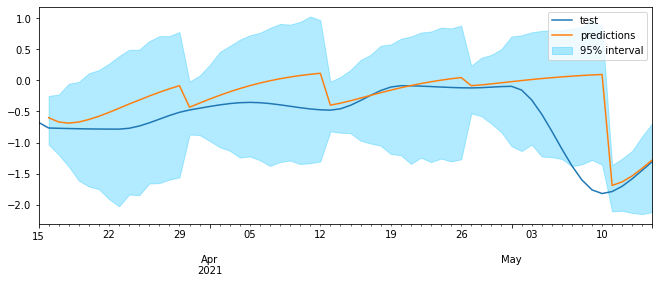

In [ ]:
#Array to store results
mae_svm_bench_refit = np.zeros(len(steps))

# Univariate without refit
for i, step in enumerate(steps):
    mae_svm_bench_refit[i] = evaluate_forecasting(data_andres_mellado_norm,data_test,forecaster,True,target,exogenous_var,step,
                                           lags_grid,param_grid,True,end_validation)

Number of models compared: 324


loop param_grid:   7%|██▋                                  | 4/54 [00:00<00:08,  5.66it/s]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [01:00<00:00, 10.12s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'C': 0.1, 'epsilon': 0.001, 'gamma': 0.01, 'kernel': 'linear'}
  Backtesting metric: 0.11176006996164693

Forecaster will be fit 61 times. This can take substantial amounts of time. If not feasible, try with `refit = False`. 

Backtest error: 0.045095409224375264
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:14<00:00,  2.37s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'C': 0.1, 'epsilon': 0.1, 'gamma': 0.01, 'kernel': 'linear'}
  Backtesting metric: 0.2615813164835685

Backtest error: 0.1730626683343575
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:09<00:00,  1.63s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 5 10 15] 
  Parameters: {'C': 0.1, 'epsilon': 0.1, 'gamma': 0.1, 'kernel': 'linear'}
  Backtesting metric: 0.31944268757834765

Backtest error: 0.2659511133570252
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:05<00:00,  1.09it/s]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 5 10 15] 
  Parameters: {'C': 0.1, 'epsilon': 0.1, 'gamma': 0.1, 'kernel': 'linear'}
  Backtesting metric: 0.2953928196028682

Backtest error: 0.3013282875396622


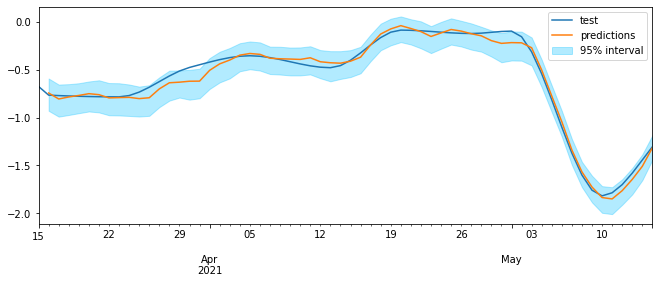

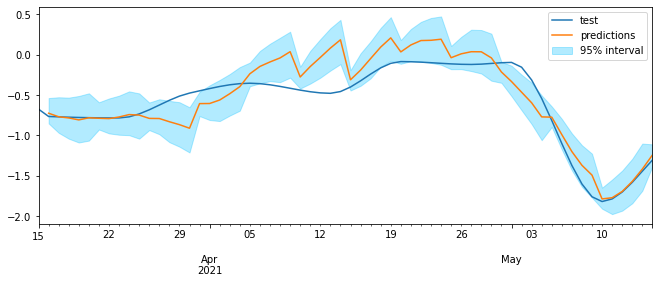

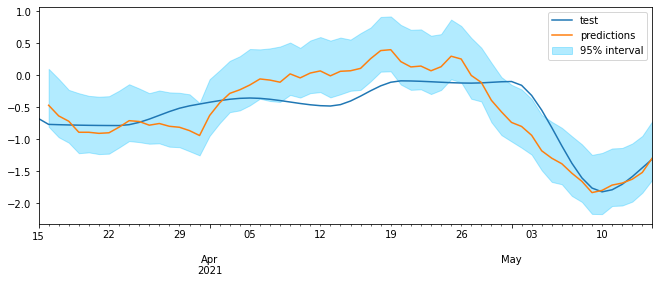

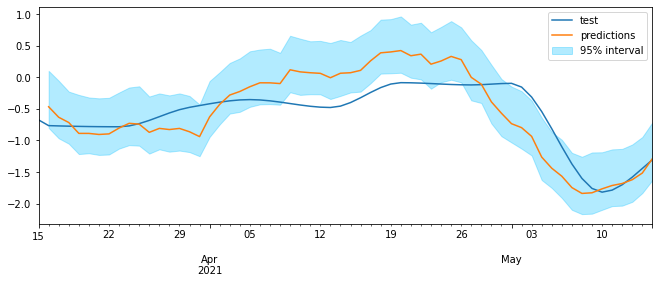

In [ ]:
#Array to store results
mae_svm_refit = np.zeros(len(steps))

for i, step in enumerate(steps):
    mae_svm_refit[i] = evaluate_forecasting(data_andres_mellado_norm,data_test,forecaster,False,target,exogenous_var,step,
                                           lags_grid,param_grid,True,end_validation)

In [ ]:
mae_svm_bench_refit

array([0.03803467, 0.15541579, 0.2487768 , 0.32274836])

In [ ]:
mae_svm_refit

array([0.04509541, 0.17306267, 0.26595111, 0.30132829])

### Chopera

In [ ]:
#Drop NA values
data_chopera = data_chopera.dropna()

In [ ]:
#Split in train/validation/test
end_train = '2021-02-15'
end_validation = '2021-03-15'

#Normalize data
data_chopera_norm = normalize(data_chopera, 178)

#Subset data
data_train = data_chopera_norm.loc[: end_train, :]
data_val   = data_chopera_norm.loc[end_train:end_validation, :]
data_test  = data_chopera_norm.loc[end_validation:, :]

print(f"Dates train      : {data_train.index.min()} --- {data_train.index.max()}  (n={len(data_train)})")
print(f"Dates validacion : {data_val.index.min()} --- {data_val.index.max()}  (n={len(data_val)})")
print(f"Dates test       : {data_test.index.min()} --- {data_test.index.max()}  (n={len(data_test)})")

Dates train      : 2020-09-28 00:00:00 --- 2021-02-15 00:00:00  (n=141)
Dates validacion : 2021-02-15 00:00:00 --- 2021-03-15 00:00:00  (n=29)
Dates test       : 2021-03-15 00:00:00 --- 2021-05-15 00:00:00  (n=62)


In [ ]:
data_chopera_norm = data_chopera_norm.drop('closing_chopera',axis=1)
exogenous_var = data_chopera_norm.loc[:, data_chopera_norm.columns != 'ia_chopera'].columns
target = 'ia_chopera'
steps = [1,5,7,14]

#### XGBRegressor with contiguous CI

In [ ]:
forecaster = ForecasterAutoreg(
                regressor = XGBRegressor(random_state=123),
                lags = 24
             )

param_grid = {
    'n_estimators': [100, 500, 1000],
    'max_depth': [2,3,4,5],
    'learning_rate': [0.001,0.01, 0.1]
    }

# Lags used as predictors
lags_grid = [1, 5, 10, 15,[5, 10], [5, 10, 20, 30], [5, 10, 15, 20, 25, 30]]

Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:05<00:04,  3.55it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [01:12<00:00, 10.34s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 500}
  Backtesting metric: 0.10683304486990838

Backtest error: 0.0829636744365108
Number of models compared: 252


loop param_grid:  58%|█████████████████████               | 21/36 [00:06<00:05,  2.89it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [01:13<00:00, 10.44s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 1000}
  Backtesting metric: 0.25021329321589053

Backtest error: 0.19121563714978226
Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:05<00:04,  3.58it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [01:13<00:00, 10.55s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 4, 'n_estimators': 100}
  Backtesting metric: 0.27171060423670185

Backtest error: 0.27378876483422665
Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:05<00:04,  3.56it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [01:13<00:00, 10.53s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 100}
  Backtesting metric: 0.2843648471724506

Backtest error: 0.3127595229514742


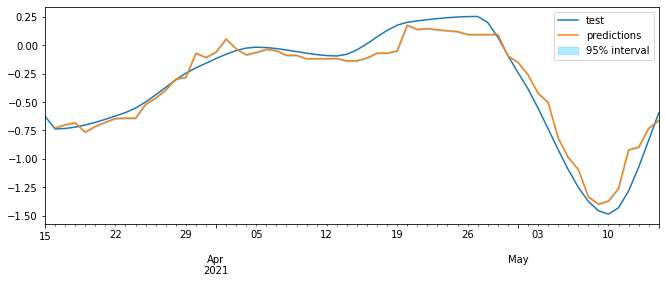

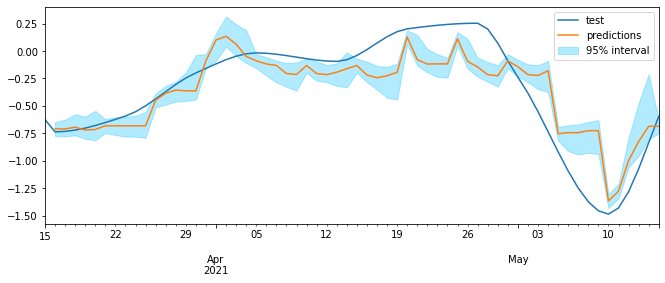

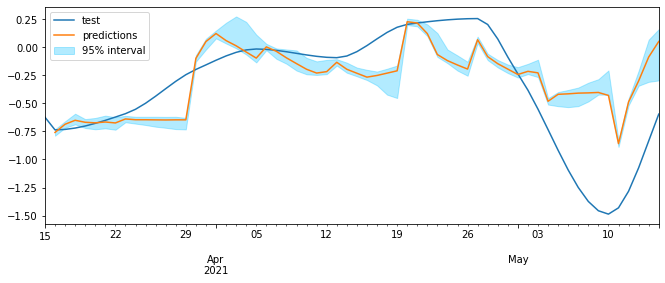

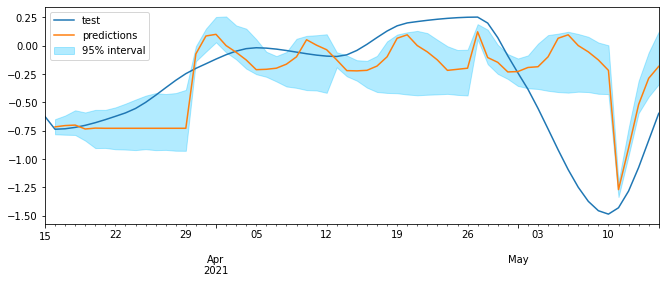

In [ ]:
#Array to store results
mae_xgb_bench = np.zeros(len(steps))

# Univariate without refit
for i, step in enumerate(steps):
    mae_xgb_bench[i] = evaluate_forecasting(data_chopera_norm,data_test,forecaster,True,target,exogenous_var,step,
                                           lags_grid,param_grid,False,end_validation)

Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:07<00:06,  2.64it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [01:37<00:00, 13.98s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 1000}
  Backtesting metric: 0.17901352409406376

Backtest error: 0.08910595803392507
Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:06<00:05,  3.00it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [01:23<00:00, 11.89s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 5 10 15 20 25 30] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 2, 'n_estimators': 100}
  Backtesting metric: 0.2050024172431772

Backtest error: 0.2732655608832739
Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:06<00:05,  3.13it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [01:22<00:00, 11.74s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 5 10 15 20 25 30] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 2, 'n_estimators': 1000}
  Backtesting metric: 0.22134339634957792

Backtest error: 0.2944866220621655
Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:06<00:05,  3.19it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [01:20<00:00, 11.53s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 5 10 20 30] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 2, 'n_estimators': 1000}
  Backtesting metric: 0.22191207586718736

Backtest error: 0.2820185233034189


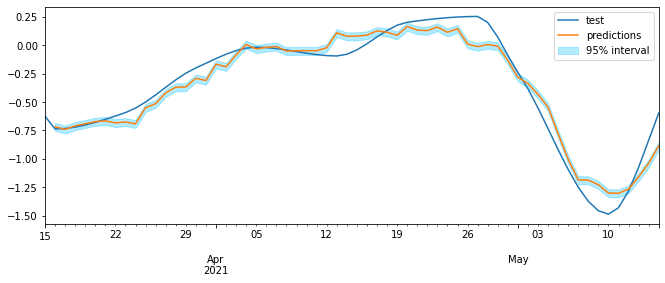

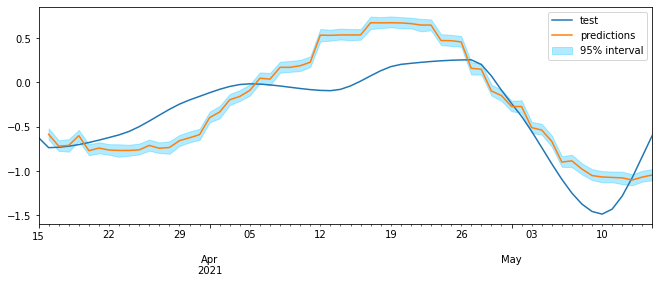

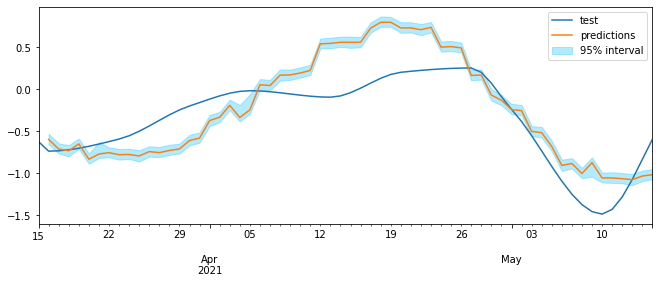

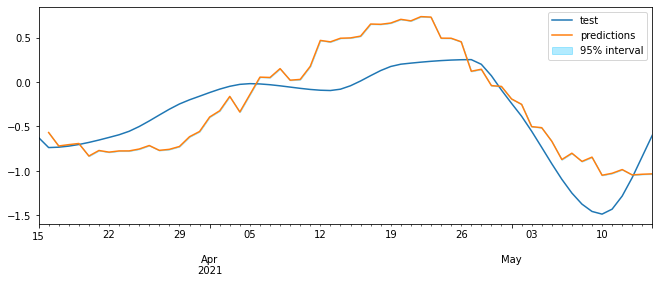

In [ ]:
mae_xgb = np.zeros(len(steps))

# Multivariate without refit
for i, step in enumerate(steps):
    mae_xgb[i] = evaluate_forecasting(data_chopera_norm,data_test,forecaster,False,target,exogenous_var,step,
                                           lags_grid,param_grid,False,end_validation)

In [ ]:
mae_xgb_bench

array([0.08296367, 0.19121564, 0.27378876, 0.31275952])

In [ ]:
mae_xgb

array([0.08910596, 0.27326556, 0.29448662, 0.28201852])

Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [01:58<01:33,  5.82s/it]


loop lags_grid: 100%|██████████████████████████████████████| 7/7 [26:33<00:00, 227.67s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 1000}
  Backtesting metric: 0.10409123974634817

Forecaster will be fit 61 times. This can take substantial amounts of time. If not feasible, try with `refit = False`. 

Backtest error: 0.0699131935525333
Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:26<00:20,  1.31s/it]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [05:55<00:00, 50.84s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500}
  Backtesting metric: 0.30783157143141443

Backtest error: 0.12764407888835433
Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:18<00:14,  1.11it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [04:03<00:00, 34.73s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 4, 'n_estimators': 1000}
  Backtesting metric: 0.2974590525073751

Backtest error: 0.234324011968875
Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:09<00:07,  2.04it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [02:11<00:00, 18.74s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 1000}
  Backtesting metric: 0.2775864999002008

Backtest error: 0.35848337532925123


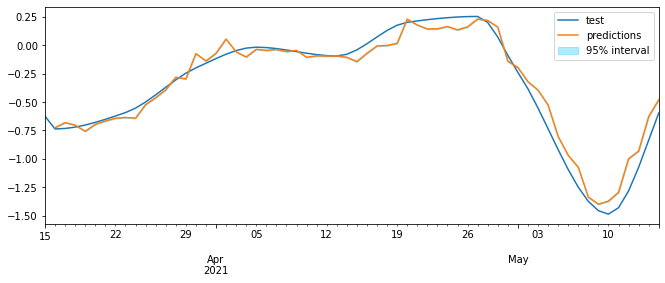

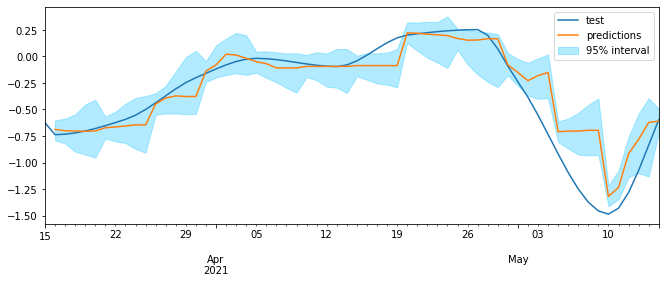

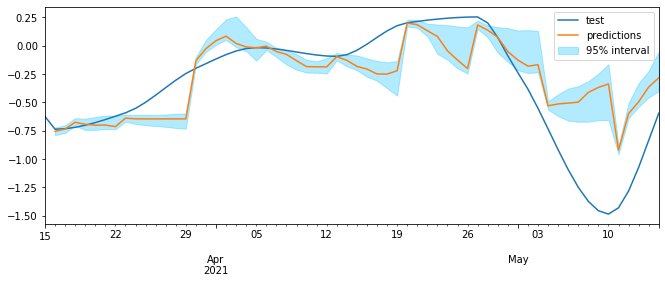

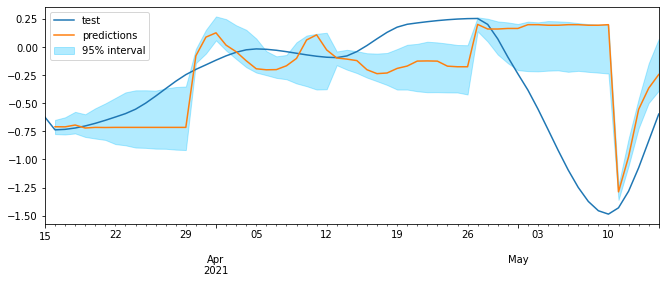

In [ ]:
#Array to store results
mae_xgb_bench_refit = np.zeros(len(steps))

# Univariate without refit
for i, step in enumerate(steps):
    mae_xgb_bench_refit[i] = evaluate_forecasting(data_chopera_norm,data_test,forecaster,True,target,exogenous_var,step,
                                           lags_grid,param_grid,True,end_validation)

Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [02:16<01:50,  6.90s/it]


loop lags_grid: 100%|██████████████████████████████████████| 7/7 [30:03<00:00, 257.59s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 2, 'n_estimators': 500}
  Backtesting metric: 0.122432830429874

Forecaster will be fit 61 times. This can take substantial amounts of time. If not feasible, try with `refit = False`. 

Backtest error: 0.07494585323617567
Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:30<00:24,  1.54s/it]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [06:43<00:00, 57.68s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 5 10 15 20 25 30] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 2, 'n_estimators': 100}
  Backtesting metric: 0.185502001314875

Backtest error: 0.21785073397851276
Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:21<00:17,  1.06s/it]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [04:36<00:00, 39.48s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 5 10 15 20 25 30] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 2, 'n_estimators': 500}
  Backtesting metric: 0.19294395669323125

Backtest error: 0.24104597540529632
Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:11<00:09,  1.77it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [02:26<00:00, 20.96s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 5 10 15 20 25 30] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 2, 'n_estimators': 100}
  Backtesting metric: 0.212972115520429

Backtest error: 0.27880820535661827


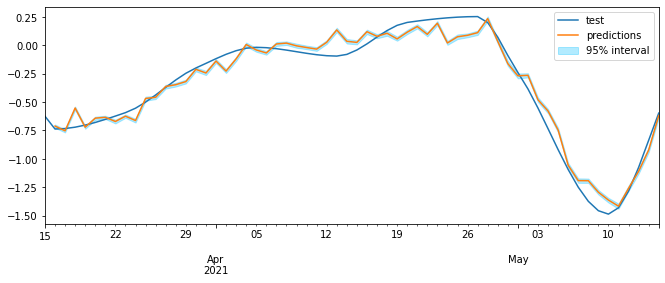

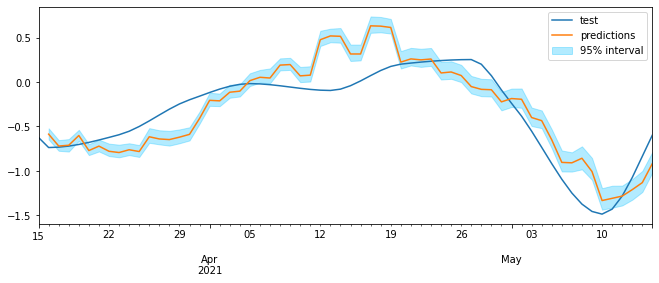

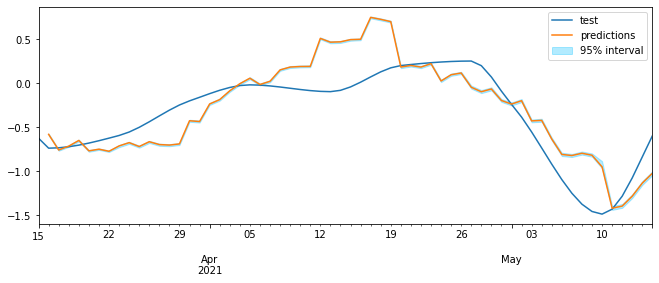

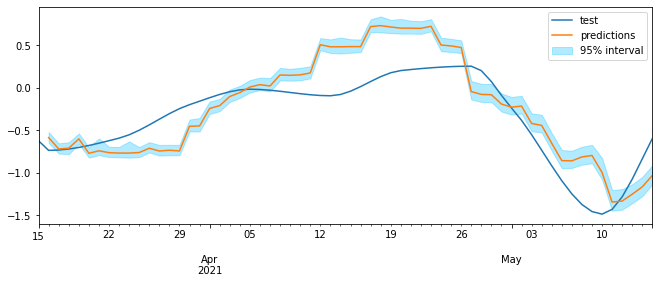

In [ ]:
mae_xgb_refit = np.zeros(len(steps))

# Multivariate without refit
for i, step in enumerate(steps):
    mae_xgb_refit[i] = evaluate_forecasting(data_chopera_norm,data_test,forecaster,False,target,exogenous_var,step,
                                           lags_grid,param_grid,True,end_validation)

In [ ]:
mae_xgb_bench_refit

array([0.06991319, 0.12764408, 0.23432401, 0.35848338])

In [ ]:
mae_xgb_refit

array([0.07494585, 0.21785073, 0.24104598, 0.27880821])

#### LGBMegressor with contiguous CI

In [ ]:
forecaster = ForecasterAutoreg(
                regressor = LGBMRegressor(random_state=123),
                lags = 24
             )

param_grid = {
    'n_estimators': [100, 500, 1000],
    'max_depth': [2,3,4,5],
    'learning_rate': [0.001,0.01, 0.1]
    }

# Lags used as predictors
lags_grid = [1, 5, 10, 15,[5, 10], [5, 10, 20, 30], [5, 10, 15, 20, 25, 30]]

Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:25<00:00,  3.59s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 4, 'n_estimators': 100}
  Backtesting metric: 0.21819118429187354

Backtest error: 0.09974418363346284
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:19<00:00,  2.82s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 100}
  Backtesting metric: 0.4809250906222866

Backtest error: 0.23900303608521611
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:19<00:00,  2.75s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 100}
  Backtesting metric: 0.44983169978934967

Backtest error: 0.24590306194318254
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:18<00:00,  2.68s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 100}
  Backtesting metric: 0.4517884746225104

Backtest error: 0.32158444536122255


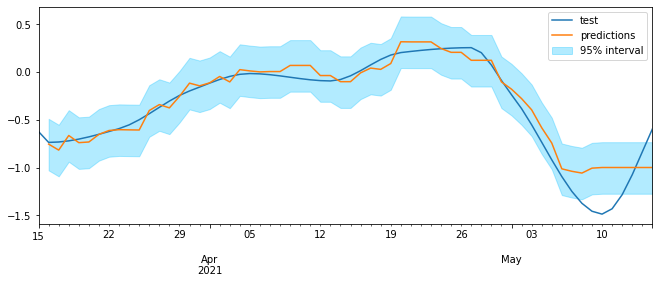

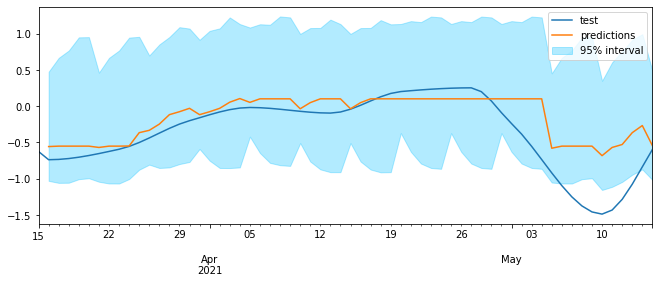

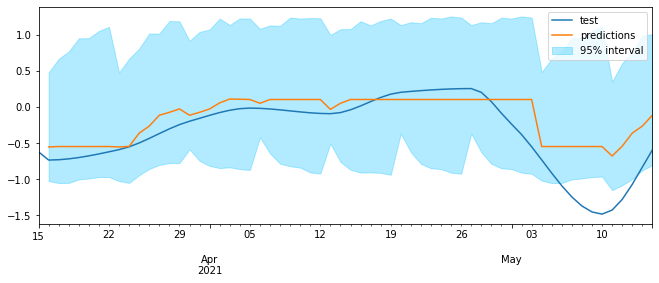

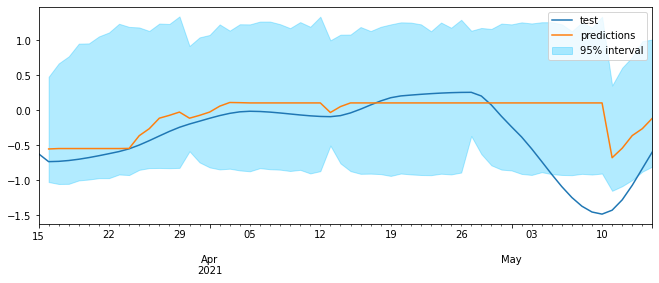

In [ ]:
#Array to store results
mae_lgbm_bench = np.zeros(len(steps))

# Univariate without refit
for i, step in enumerate(steps):
    mae_lgbm_bench[i] = evaluate_forecasting(data_chopera_norm,data_test,forecaster,True,target,exogenous_var,step,
                                           lags_grid,param_grid,False,end_validation)

Number of models compared: 252


loop param_grid:  58%|█████████████████████               | 21/36 [00:03<00:02,  5.63it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:41<00:00,  5.99s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 2, 'n_estimators': 100}
  Backtesting metric: 0.18935156559576222

Backtest error: 0.1349554111378535
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:24<00:00,  3.48s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 4, 'n_estimators': 500}
  Backtesting metric: 0.2534167556153852

Backtest error: 0.16126018616855337
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:23<00:00,  3.30s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 4, 'n_estimators': 500}
  Backtesting metric: 0.24816066055862804

Backtest error: 0.17724194802351947
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:21<00:00,  3.08s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 4, 'n_estimators': 500}
  Backtesting metric: 0.23782195049347563

Backtest error: 0.192953074573534


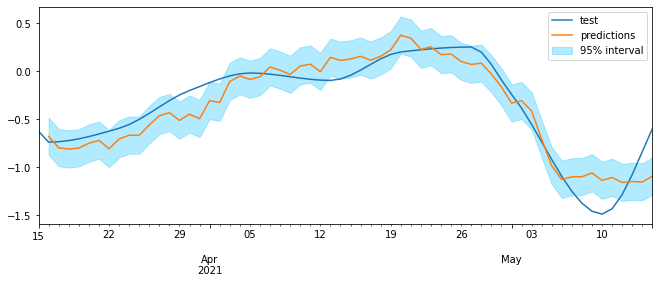

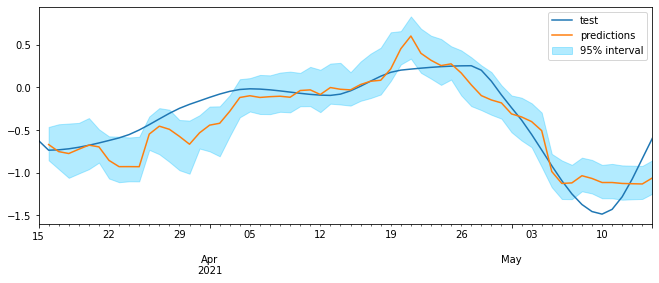

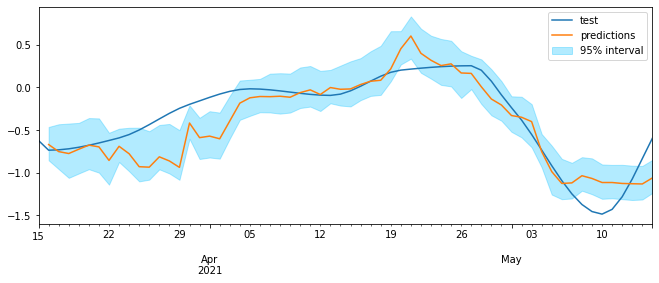

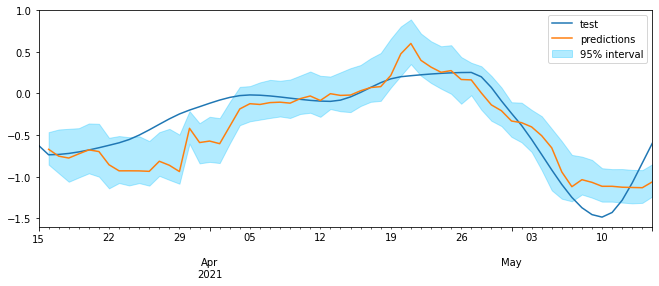

In [ ]:
mae_lgbm = np.zeros(len(steps))

# Multivariate without refit
for i, step in enumerate(steps):
    mae_lgbm[i] = evaluate_forecasting(data_chopera_norm,data_test,forecaster,False,target,exogenous_var,step,
                                           lags_grid,param_grid,False,end_validation)

In [ ]:
mae_lgbm_bench

array([0.09974418, 0.23900304, 0.24590306, 0.32158445])

In [ ]:
mae_lgbm

array([0.13495541, 0.16126019, 0.17724195, 0.19295307])

Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:24<00:00,  3.56s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 4, 'n_estimators': 100}
  Backtesting metric: 0.21819118429187354

Backtest error: 0.09974418363346284
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:19<00:00,  2.82s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 100}
  Backtesting metric: 0.4809250906222866

Backtest error: 0.23900303608521611
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:19<00:00,  2.76s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 100}
  Backtesting metric: 0.44983169978934967

Backtest error: 0.24590306194318254
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:18<00:00,  2.70s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 100}
  Backtesting metric: 0.4517884746225104

Backtest error: 0.32158444536122255


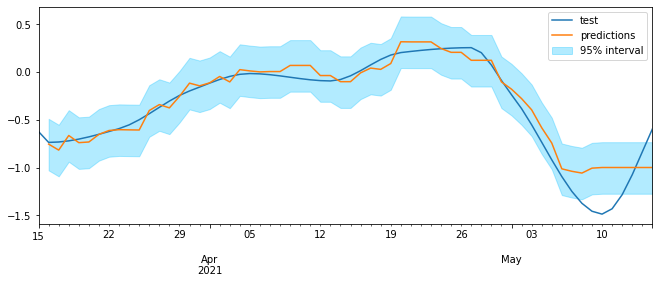

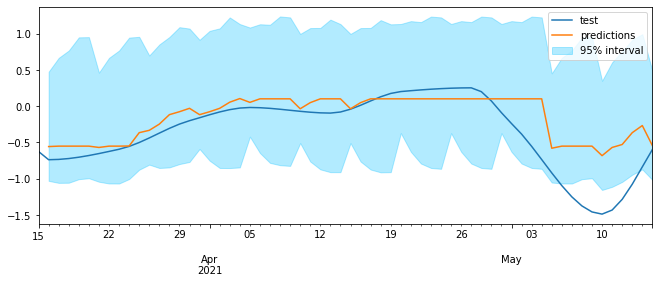

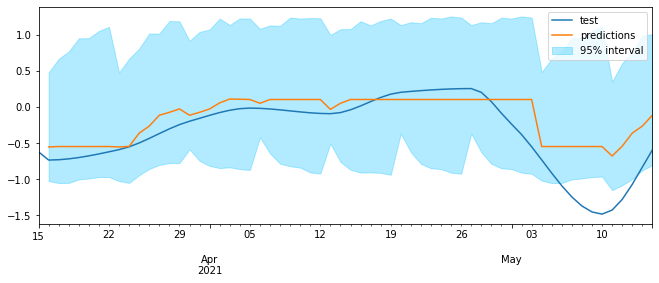

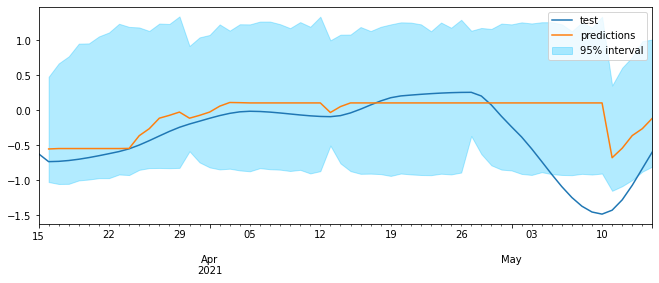

In [ ]:
#Array to store results
mae_lgbm_bench_refit = np.zeros(len(steps))

# Univariate without refit
for i, step in enumerate(steps):
    mae_lgbm_bench_refit[i] = evaluate_forecasting(data_chopera_norm,data_test,forecaster,True,target,exogenous_var,step,
                                           lags_grid,param_grid,False,end_validation)

Number of models compared: 252


loop param_grid:  58%|█████████████████████               | 21/36 [00:03<00:02,  5.60it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:42<00:00,  6.00s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 2, 'n_estimators': 100}
  Backtesting metric: 0.18935156559576222

Backtest error: 0.1349554111378535
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:24<00:00,  3.55s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 4, 'n_estimators': 500}
  Backtesting metric: 0.2534167556153852

Backtest error: 0.16126018616855337
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:23<00:00,  3.33s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 4, 'n_estimators': 500}
  Backtesting metric: 0.24816066055862804

Backtest error: 0.17724194802351947
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:21<00:00,  3.10s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 4, 'n_estimators': 500}
  Backtesting metric: 0.23782195049347563

Backtest error: 0.192953074573534


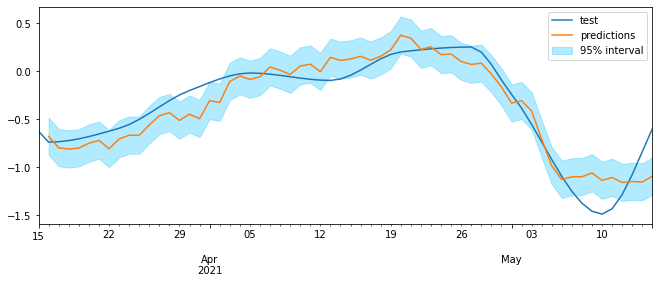

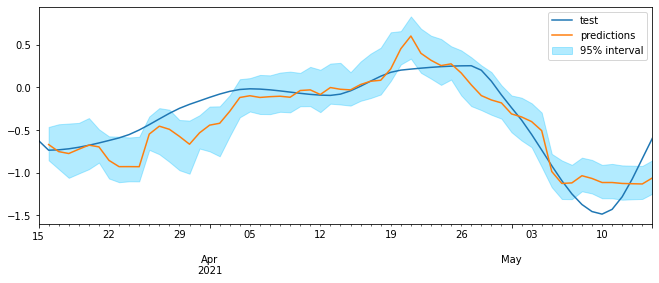

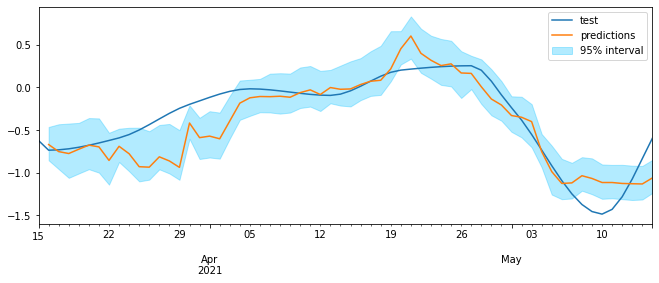

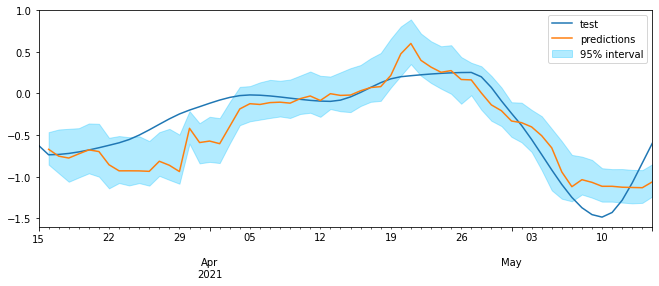

In [ ]:
mae_lgbm_refit = np.zeros(len(steps))

# Multivariate without refit
for i, step in enumerate(steps):
    mae_lgbm_refit[i] = evaluate_forecasting(data_chopera_norm,data_test,forecaster,False,target,exogenous_var,step,
                                           lags_grid,param_grid,False,end_validation)

In [ ]:
mae_lgbm_bench_refit

array([0.09974418, 0.23900304, 0.24590306, 0.32158445])

In [ ]:
mae_lgbm_refit

array([0.13495541, 0.16126019, 0.17724195, 0.19295307])

#### SVR with contiguous CI

In [ ]:
forecaster = ForecasterAutoreg(
                regressor = SVR(),
                lags = 24
             )

param_grid = {
        'kernel': ('linear','poly'),
        'C':[1e-4,1e-2,1e-1],
        'gamma': [1e-4,1e-2,1e-1],
        'epsilon':[0.001,0.01,0.1]
        }

# Lags used as predictors
lags_grid = [5, 10, 15, [5, 10, 15], [5, 10, 20, 30], [5, 10, 15, 20, 25, 30]]

Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:07<00:00,  1.19s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'C': 0.1, 'epsilon': 0.001, 'gamma': 0.1, 'kernel': 'linear'}
  Backtesting metric: 0.14281989074166815

Backtest error: 0.042925040038891284
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:03<00:00,  1.67it/s]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'C': 0.1, 'epsilon': 0.001, 'gamma': 0.0001, 'kernel': 'linear'}
  Backtesting metric: 0.4095365379420241

Backtest error: 0.18027404234871675
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:03<00:00,  1.89it/s]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'C': 0.01, 'epsilon': 0.1, 'gamma': 0.0001, 'kernel': 'linear'}
  Backtesting metric: 0.6640776090294648

Backtest error: 0.21675569415281665
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:02<00:00,  2.11it/s]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'C': 0.1, 'epsilon': 0.01, 'gamma': 0.01, 'kernel': 'linear'}
  Backtesting metric: 0.5542675785558594

Backtest error: 0.36201776992710716


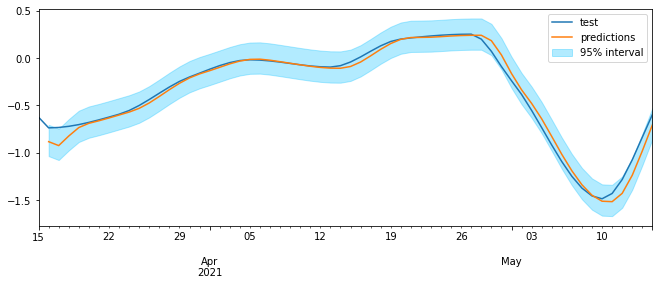

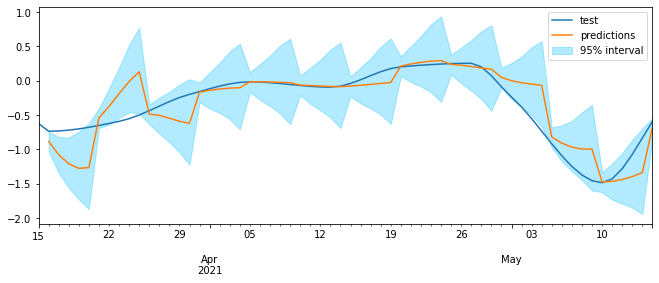

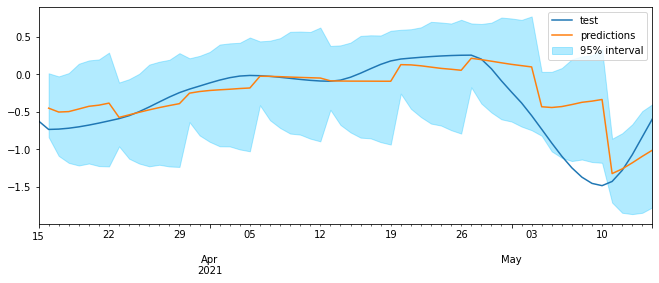

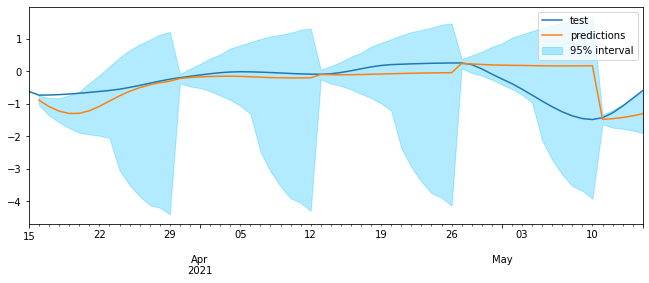

In [ ]:
#Array to store results
mae_svm_bench = np.zeros(len(steps))

# Univariate without refit
for i, step in enumerate(steps):
    mae_svm_bench[i] = evaluate_forecasting(data_chopera_norm,data_test,forecaster,True,target,exogenous_var,step,
                                           lags_grid,param_grid,False,end_validation)

Number of models compared: 324


loop param_grid: 100%|████████████████████████████████████| 54/54 [00:02<00:00, 18.60it/s]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:17<00:00,  2.99s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'C': 0.1, 'epsilon': 0.01, 'gamma': 0.0001, 'kernel': 'linear'}
  Backtesting metric: 0.19938974473378504

Backtest error: 0.12293503752766576
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:06<00:00,  1.02s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'C': 0.1, 'epsilon': 0.1, 'gamma': 0.0001, 'kernel': 'linear'}
  Backtesting metric: 0.34244607471742966

Backtest error: 0.21968265300125617
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:05<00:00,  1.19it/s]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 5 10 15] 
  Parameters: {'C': 0.1, 'epsilon': 0.01, 'gamma': 0.0001, 'kernel': 'linear'}
  Backtesting metric: 0.3650384297429551

Backtest error: 0.21078561750225108
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:03<00:00,  1.52it/s]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 5 10 15] 
  Parameters: {'C': 0.1, 'epsilon': 0.001, 'gamma': 0.0001, 'kernel': 'linear'}
  Backtesting metric: 0.3710228044657416

Backtest error: 0.2174463897013766


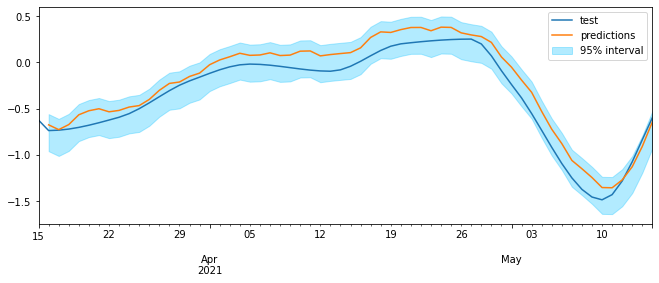

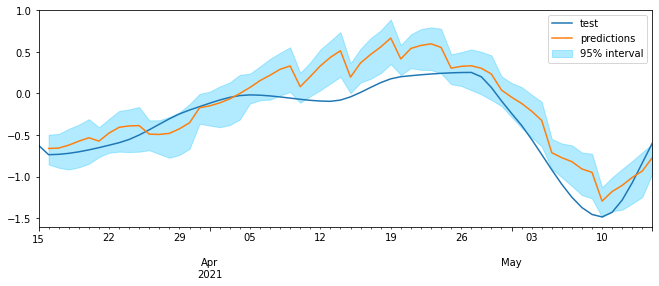

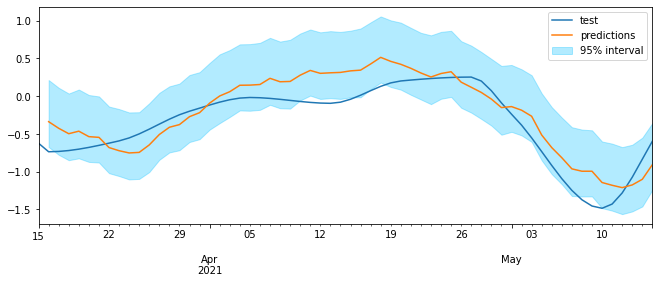

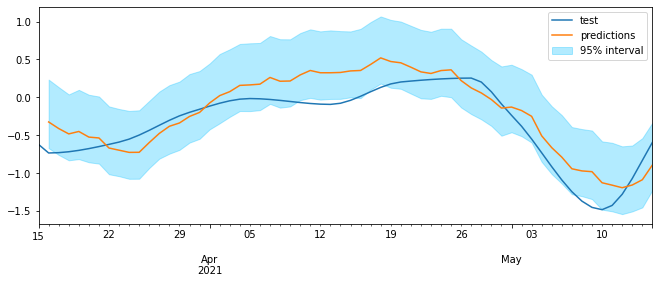

In [ ]:
#Array to store results
mae_svm = np.zeros(len(steps))

# Univariate without refit
for i, step in enumerate(steps):
    mae_svm[i] = evaluate_forecasting(data_chopera_norm,data_test,forecaster,False,target,exogenous_var,step,
                                           lags_grid,param_grid,False,end_validation)

In [ ]:
mae_svm_bench

array([0.04292504, 0.18027404, 0.21675569, 0.36201777])

In [ ]:
mae_svm

array([0.12293504, 0.21968265, 0.21078562, 0.21744639])

Number of models compared: 324


loop param_grid:   7%|██▋                                  | 4/54 [00:00<00:06,  7.81it/s]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:43<00:00,  7.19s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'C': 0.1, 'epsilon': 0.001, 'gamma': 0.1, 'kernel': 'linear'}
  Backtesting metric: 0.139989353854147

Forecaster will be fit 61 times. This can take substantial amounts of time. If not feasible, try with `refit = False`. 

Backtest error: 0.039828934398427454
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:10<00:00,  1.68s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'C': 0.1, 'epsilon': 0.01, 'gamma': 0.1, 'kernel': 'linear'}
  Backtesting metric: 0.3802710629925516

Backtest error: 0.18551914658531518
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:07<00:00,  1.18s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10] 
  Parameters: {'C': 0.01, 'epsilon': 0.1, 'gamma': 0.1, 'kernel': 'linear'}
  Backtesting metric: 0.6958676578052074

Backtest error: 0.18693752142939013
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:04<00:00,  1.47it/s]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'C': 0.1, 'epsilon': 0.01, 'gamma': 0.0001, 'kernel': 'linear'}
  Backtesting metric: 0.569186969870895

Backtest error: 0.3664672539634546


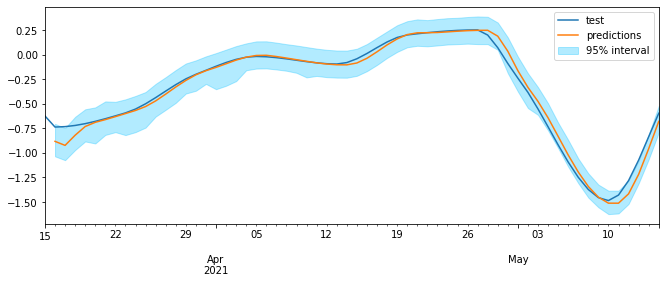

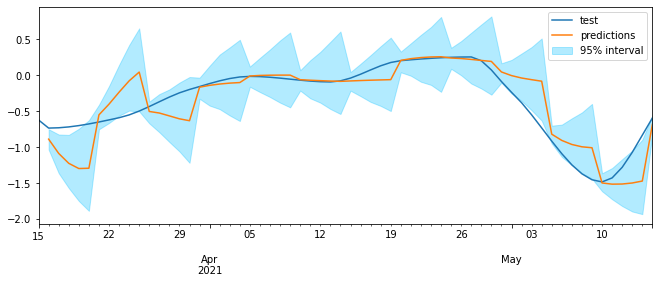

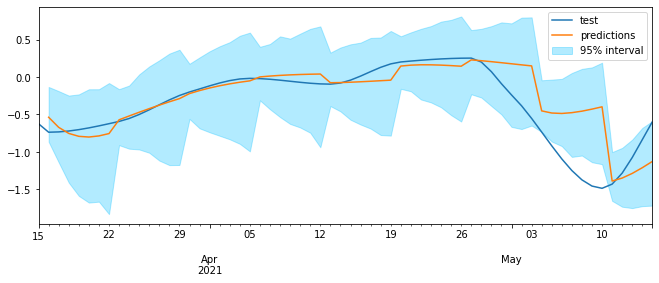

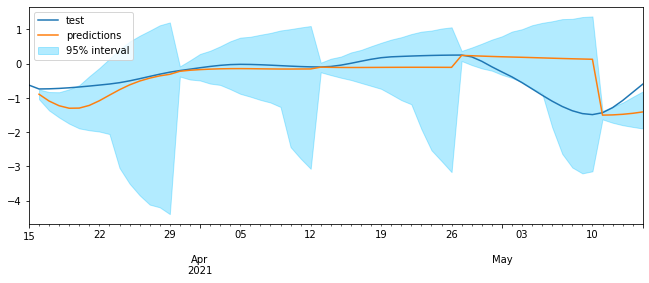

In [ ]:
#Array to store results
mae_svm_bench_refit = np.zeros(len(steps))

# Univariate without refit
for i, step in enumerate(steps):
    mae_svm_bench_refit[i] = evaluate_forecasting(data_chopera_norm,data_test,forecaster,True,target,exogenous_var,step,
                                           lags_grid,param_grid,True,end_validation)

Number of models compared: 324


loop param_grid:   7%|██▋                                  | 4/54 [00:00<00:09,  5.23it/s]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [01:02<00:00, 10.41s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'C': 0.1, 'epsilon': 0.001, 'gamma': 0.0001, 'kernel': 'linear'}
  Backtesting metric: 0.17990415048422662

Forecaster will be fit 61 times. This can take substantial amounts of time. If not feasible, try with `refit = False`. 

Backtest error: 0.07113740851205759
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:14<00:00,  2.42s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'C': 0.1, 'epsilon': 0.1, 'gamma': 0.1, 'kernel': 'linear'}
  Backtesting metric: 0.3727956673205045

Backtest error: 0.14675754886026232
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:10<00:00,  1.68s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 5 10 15 20 25 30] 
  Parameters: {'C': 0.01, 'epsilon': 0.001, 'gamma': 0.0001, 'kernel': 'linear'}
  Backtesting metric: 0.35931827226606655

Backtest error: 0.25070825636712557
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:05<00:00,  1.07it/s]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 5 10 15 20 25 30] 
  Parameters: {'C': 0.01, 'epsilon': 0.001, 'gamma': 0.1, 'kernel': 'linear'}
  Backtesting metric: 0.3935271624838962

Backtest error: 0.25352264898988386


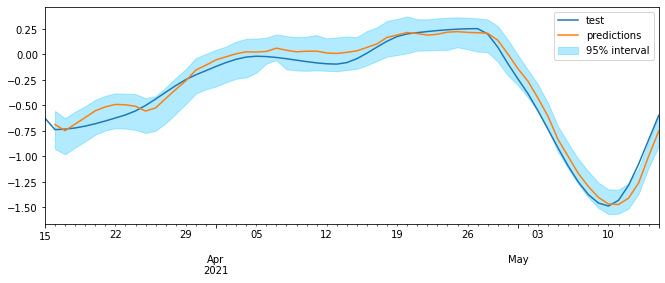

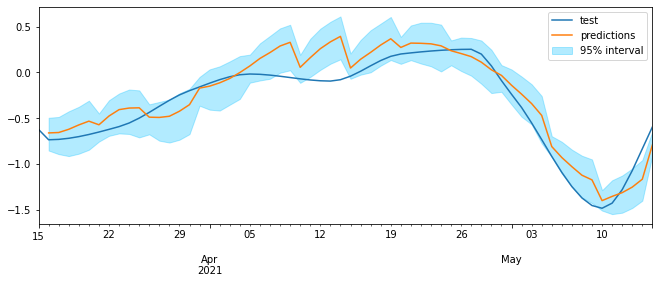

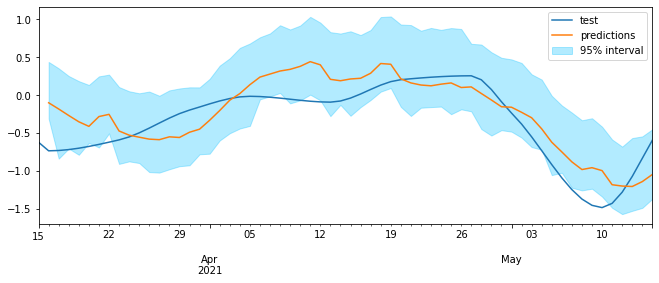

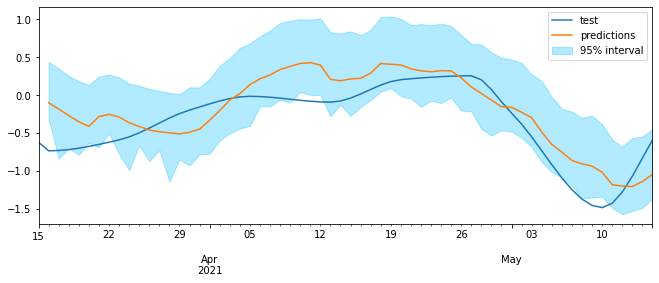

In [ ]:
#Array to store results
mae_svm_refit = np.zeros(len(steps))

# Univariate without refit
for i, step in enumerate(steps):
    mae_svm_refit[i] = evaluate_forecasting(data_chopera_norm,data_test,forecaster,False,target,exogenous_var,step,
                                           lags_grid,param_grid,True,end_validation)

In [ ]:
mae_svm_bench_refit

array([0.03982893, 0.18551915, 0.18693752, 0.36646725])

In [ ]:
mae_svm_refit

array([0.07113741, 0.14675755, 0.25070826, 0.25352265])

#### XGBRegressor without contiguous CI

In [ ]:
data_chopera_norm = data_chopera_norm.drop('ia_legazpi',axis=1)

In [ ]:
exogenous_var = data_chopera_norm.loc[:,data_chopera_norm.columns != 'ia_chopera'].columns

In [ ]:
forecaster = ForecasterAutoreg(
                regressor = XGBRegressor(random_state=123),
                lags = 24
             )

param_grid = {
    'n_estimators': [100, 500, 1000],
    'max_depth': [2,3,4,5],
    'learning_rate': [0.001,0.01, 0.1]
    }

# Lags used as predictors
lags_grid = [1, 5, 10, 15,[5, 10], [5, 10, 20, 30], [5, 10, 15, 20, 25, 30]]

Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:06<00:05,  3.16it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [01:23<00:00, 11.94s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 500}
  Backtesting metric: 0.10683304486990838

Backtest error: 0.0829636744365108
Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:06<00:05,  3.08it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [01:19<00:00, 11.42s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 1000}
  Backtesting metric: 0.25021329321589053

Backtest error: 0.19121563714978226
Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:06<00:04,  3.33it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [01:19<00:00, 11.34s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 4, 'n_estimators': 100}
  Backtesting metric: 0.27171060423670185

Backtest error: 0.27378876483422665
Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:06<00:04,  3.34it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [01:19<00:00, 11.31s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 100}
  Backtesting metric: 0.2843648471724506

Backtest error: 0.3127595229514742


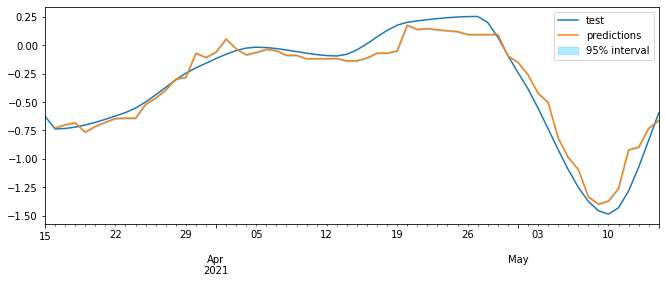

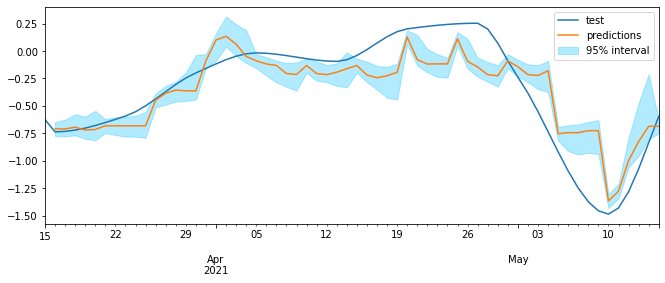

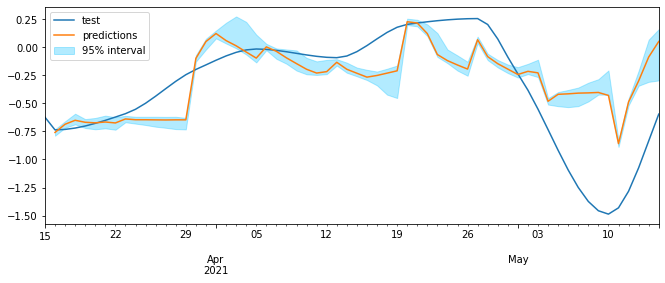

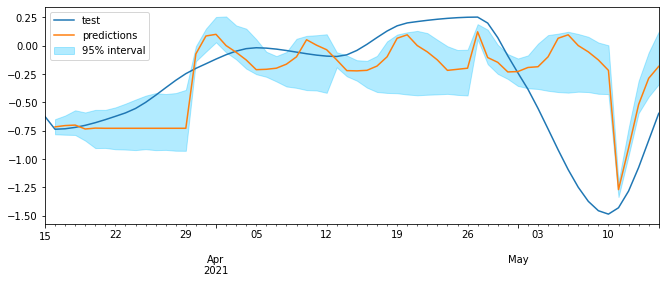

In [ ]:
#Array to store results
mae_xgb_bench_v2 = np.zeros(len(steps))

# Univariate without refit
for i, step in enumerate(steps):
    mae_xgb_bench_v2[i] = evaluate_forecasting(data_chopera_norm,data_test,forecaster,True,target,exogenous_var,step,
                                           lags_grid,param_grid,False,end_validation)

Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:08<00:06,  2.44it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [01:45<00:00, 15.08s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 5, 'n_estimators': 500}
  Backtesting metric: 0.17796675774821763

Backtest error: 0.14438007778503326
Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:06<00:05,  2.91it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [01:28<00:00, 12.71s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 4, 'n_estimators': 100}
  Backtesting metric: 0.432007542187905

Backtest error: 0.21702275432452678
Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:06<00:05,  2.95it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [01:27<00:00, 12.48s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 2, 'n_estimators': 100}
  Backtesting metric: 0.4409633553040475

Backtest error: 0.477819453932001
Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:06<00:05,  3.02it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [01:25<00:00, 12.27s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 2, 'n_estimators': 100}
  Backtesting metric: 0.44392667539009245

Backtest error: 0.5137763092473957


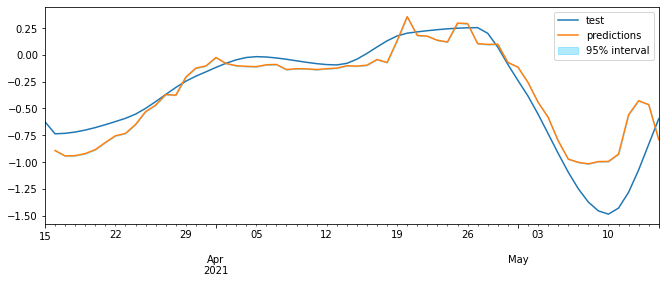

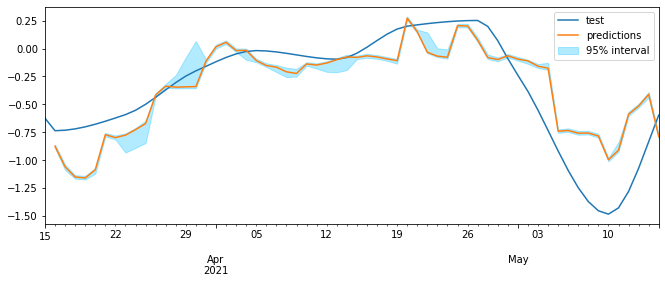

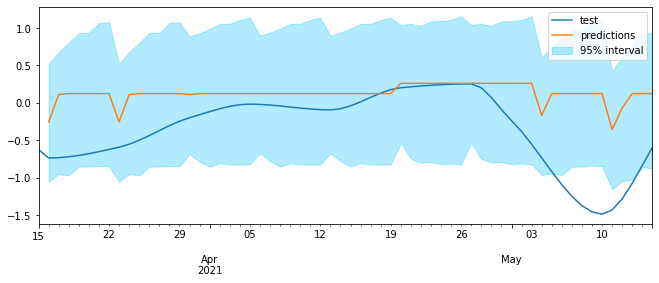

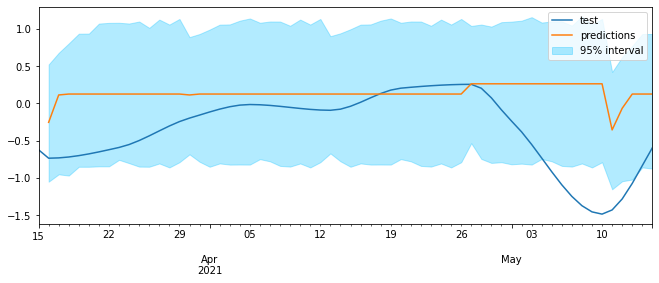

In [ ]:
mae_xgb_v2 = np.zeros(len(steps))

# Multivariate without refit
for i, step in enumerate(steps):
    mae_xgb_v2[i] = evaluate_forecasting(data_chopera_norm,data_test,forecaster,False,target,exogenous_var,step,
                                           lags_grid,param_grid,False,end_validation)

In [ ]:
mae_xgb_bench_v2

array([0.08296367, 0.19121564, 0.27378876, 0.31275952])

In [ ]:
mae_xgb_v2

array([0.14438008, 0.21702275, 0.47781945, 0.51377631])

Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [02:05<01:40,  6.26s/it]


loop lags_grid: 100%|██████████████████████████████████████| 7/7 [28:09<00:00, 241.35s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 1000}
  Backtesting metric: 0.10409123974634817

Forecaster will be fit 61 times. This can take substantial amounts of time. If not feasible, try with `refit = False`. 

Backtest error: 0.0699131935525333
Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:28<00:22,  1.40s/it]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [06:19<00:00, 54.21s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500}
  Backtesting metric: 0.30783157143141443

Backtest error: 0.12764407888835433
Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:19<00:15,  1.05it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [04:18<00:00, 36.88s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 4, 'n_estimators': 1000}
  Backtesting metric: 0.2974590525073751

Backtest error: 0.234324011968875
Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:10<00:08,  1.94it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [02:19<00:00, 19.88s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 1000}
  Backtesting metric: 0.2775864999002008

Backtest error: 0.35848337532925123


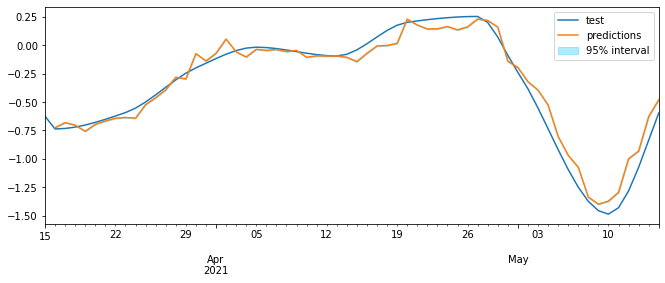

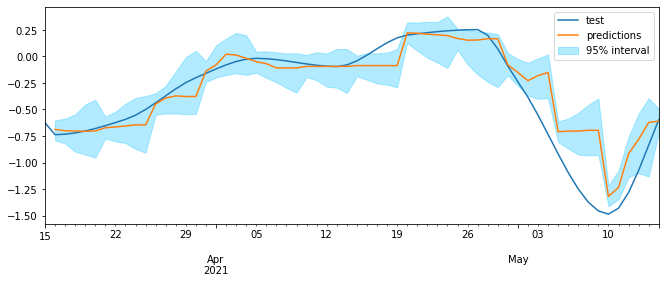

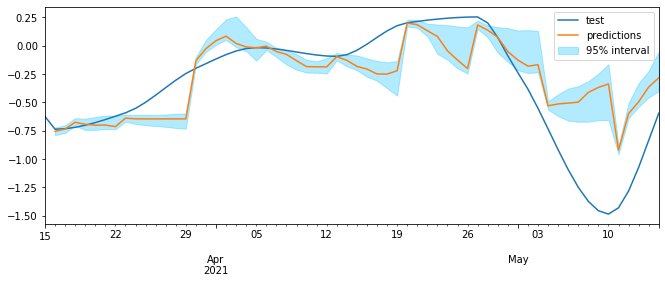

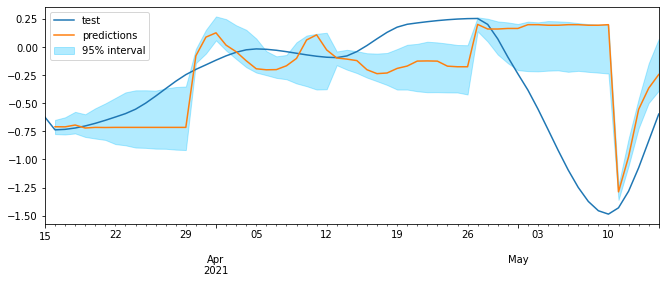

In [ ]:
#Array to store results
mae_xgb_bench_refit_v2 = np.zeros(len(steps))

# Univariate without refit
for i, step in enumerate(steps):
    mae_xgb_bench_refit_v2[i] = evaluate_forecasting(data_chopera_norm,data_test,forecaster,True,target,exogenous_var,step,
                                           lags_grid,param_grid,True,end_validation)



Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [02:19<01:49,  6.87s/it]


loop lags_grid: 100%|██████████████████████████████████████| 7/7 [30:52<00:00, 264.61s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 4, 'n_estimators': 500}
  Backtesting metric: 0.15355086687257558

Forecaster will be fit 61 times. This can take substantial amounts of time. If not feasible, try with `refit = False`. 

Backtest error: 0.09070399151670301
Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:30<00:24,  1.53s/it]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [06:42<00:00, 57.55s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 4, 'n_estimators': 100}
  Backtesting metric: 0.3600390066051575

Backtest error: 0.18460515030481656
Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:21<00:16,  1.04s/it]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [04:34<00:00, 39.25s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 4, 'n_estimators': 100}
  Backtesting metric: 0.5207228853491632

Backtest error: 0.2743947524652486
Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:11<00:09,  1.73it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [02:27<00:00, 21.06s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 5, 'n_estimators': 1000}
  Backtesting metric: 0.46848358486086417

Backtest error: 0.43459478141823654


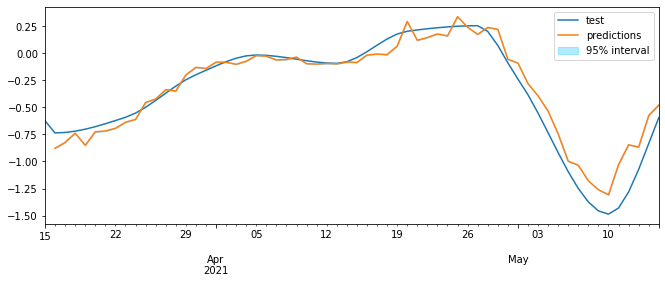

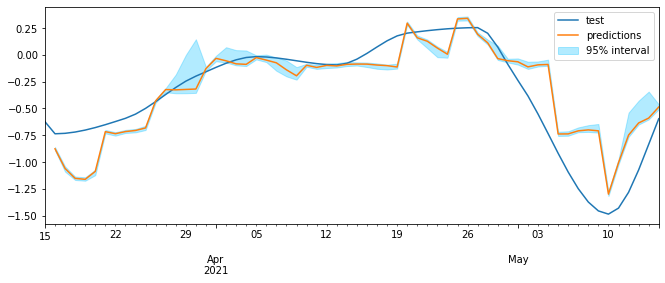

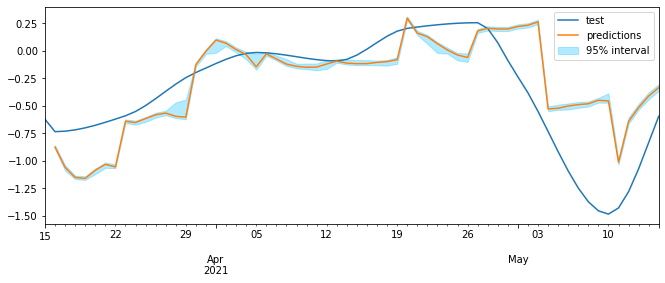

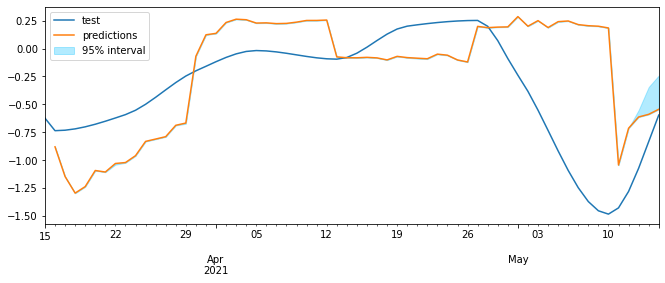

In [ ]:
mae_xgb_refit_v2 = np.zeros(len(steps))

# Multivariate without refit
for i, step in enumerate(steps):
    mae_xgb_refit_v2[i] = evaluate_forecasting(data_chopera_norm,data_test,forecaster,False,target,exogenous_var,step,
                                           lags_grid,param_grid,True,end_validation)

In [ ]:
mae_xgb_bench_refit_v2

array([0.06991319, 0.12764408, 0.23432401, 0.35848338])

In [ ]:
mae_xgb_refit_v2

array([0.09070399, 0.18460515, 0.27439475, 0.43459478])

#### LGBMegressor without contiguous CI

In [ ]:
forecaster = ForecasterAutoreg(
                regressor = LGBMRegressor(random_state=123),
                lags = 24
             )

param_grid = {
    'n_estimators': [100, 500, 1000],
    'max_depth': [2,3,4,5],
    'learning_rate': [0.001,0.01, 0.1]
    }

# Lags used as predictors
lags_grid = [1, 5, 10, 15,[5, 10], [5, 10, 20, 30], [5, 10, 15, 20, 25, 30]]

Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:25<00:00,  3.65s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 4, 'n_estimators': 100}
  Backtesting metric: 0.21819118429187354

Backtest error: 0.09974418363346284
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:20<00:00,  2.86s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 100}
  Backtesting metric: 0.4809250906222866

Backtest error: 0.23900303608521611
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:19<00:00,  2.82s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 100}
  Backtesting metric: 0.44983169978934967

Backtest error: 0.24590306194318254
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:19<00:00,  2.75s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 100}
  Backtesting metric: 0.4517884746225104

Backtest error: 0.32158444536122255


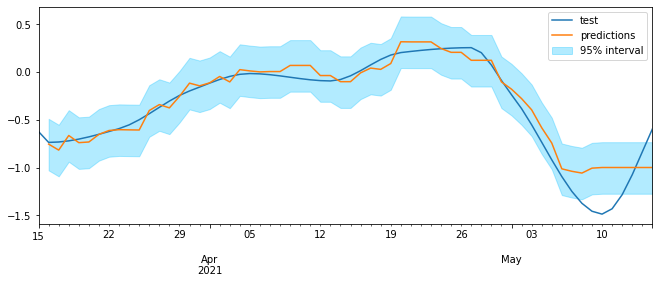

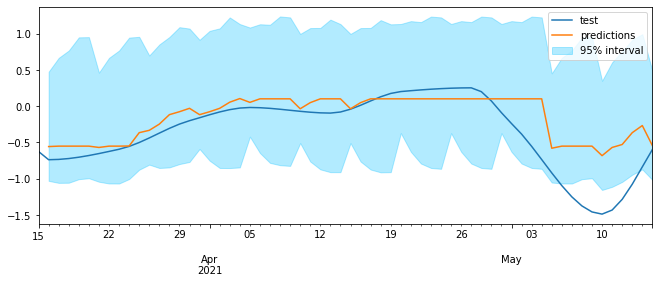

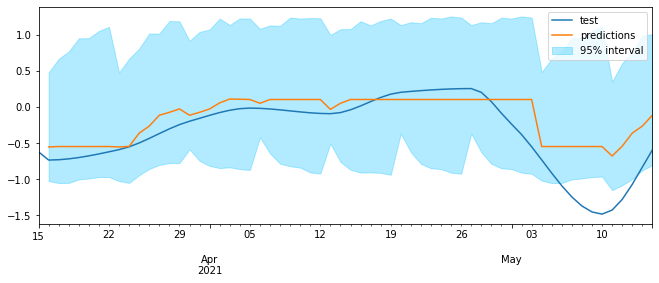

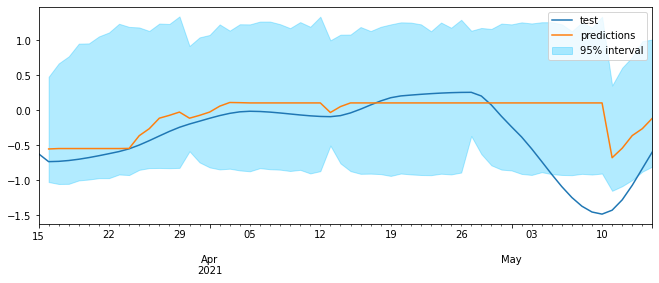

In [ ]:
#Array to store results
mae_lgbm_bench_v2 = np.zeros(len(steps))

# Univariate without refit
for i, step in enumerate(steps):
    mae_lgbm_bench_v2[i] = evaluate_forecasting(data_chopera_norm,data_test,forecaster,True,target,exogenous_var,step,
                                           lags_grid,param_grid,False,end_validation)

Number of models compared: 252


loop param_grid:  58%|█████████████████████               | 21/36 [00:03<00:02,  5.53it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:42<00:00,  6.09s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 2, 'n_estimators': 500}
  Backtesting metric: 0.24005286763693431

Backtest error: 0.12712283088236412
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:24<00:00,  3.51s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 4, 'n_estimators': 100}
  Backtesting metric: 0.47726943202810934

Backtest error: 0.27038528270348483
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:23<00:00,  3.32s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 100}
  Backtesting metric: 0.44983169978934967

Backtest error: 0.24590306194318254
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:22<00:00,  3.17s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 5, 'n_estimators': 100}
  Backtesting metric: 0.44504155918242844

Backtest error: 0.27053966740386126


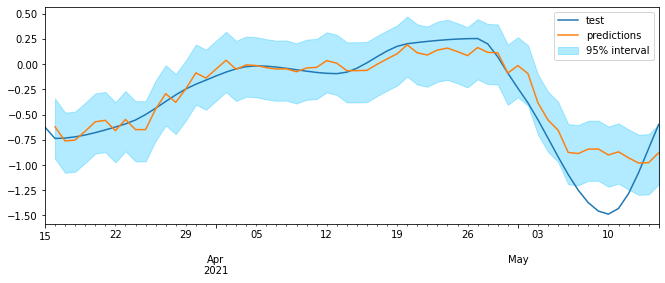

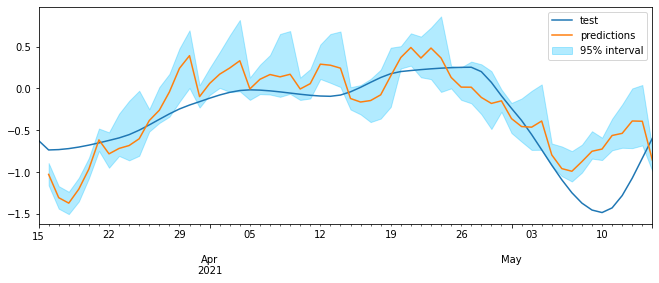

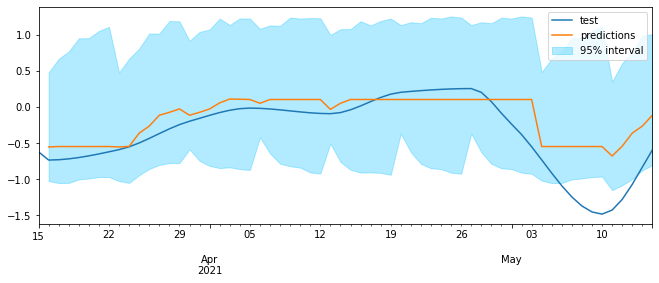

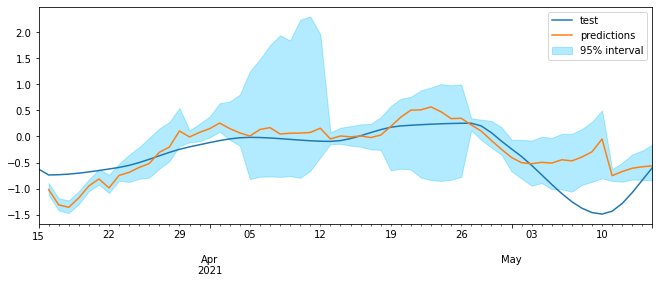

In [ ]:
mae_lgbm_v2 = np.zeros(len(steps))

# Multivariate without refit
for i, step in enumerate(steps):
    mae_lgbm_v2[i] = evaluate_forecasting(data_chopera_norm,data_test,forecaster,False,target,exogenous_var,step,
                                           lags_grid,param_grid,False,end_validation)

In [ ]:
mae_lgbm_bench_v2

array([0.09974418, 0.23900304, 0.24590306, 0.32158445])

In [ ]:
mae_lgbm_v2

array([0.12712283, 0.27038528, 0.24590306, 0.27053967])

Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:25<00:00,  3.66s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 4, 'n_estimators': 100}
  Backtesting metric: 0.21819118429187354

Backtest error: 0.09974418363346284
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:20<00:00,  2.89s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 100}
  Backtesting metric: 0.4809250906222866

Backtest error: 0.23900303608521611
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:20<00:00,  2.87s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 100}
  Backtesting metric: 0.44983169978934967

Backtest error: 0.24590306194318254
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:19<00:00,  2.75s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 100}
  Backtesting metric: 0.4517884746225104

Backtest error: 0.32158444536122255


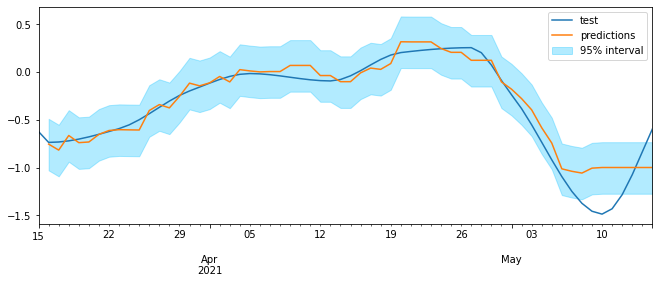

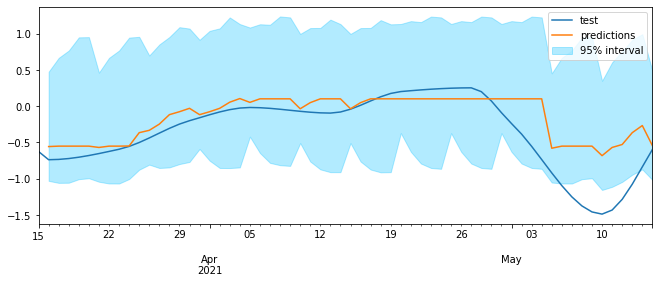

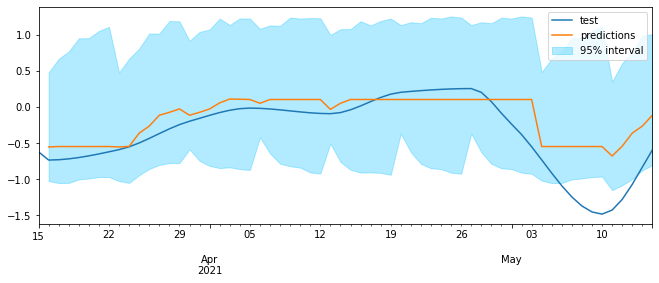

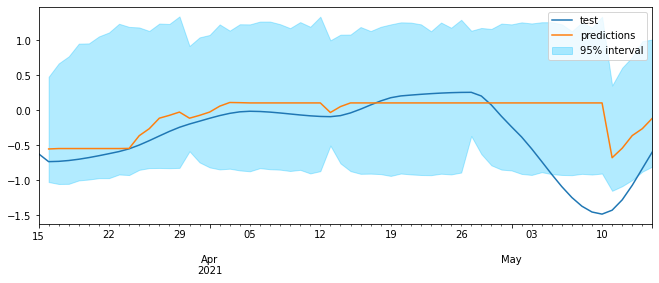

In [ ]:
#Array to store results
mae_lgbm_bench_refit_v2 = np.zeros(len(steps))

# Univariate without refit
for i, step in enumerate(steps):
    mae_lgbm_bench_refit_v2[i] = evaluate_forecasting(data_chopera_norm,data_test,forecaster,True,target,exogenous_var,step,
                                           lags_grid,param_grid,False,end_validation)

Number of models compared: 252


loop param_grid:  58%|█████████████████████               | 21/36 [00:03<00:02,  5.44it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:42<00:00,  6.11s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 2, 'n_estimators': 500}
  Backtesting metric: 0.24005286763693431

Backtest error: 0.12712283088236412
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:24<00:00,  3.52s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 4, 'n_estimators': 100}
  Backtesting metric: 0.47726943202810934

Backtest error: 0.27038528270348483
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:23<00:00,  3.32s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 100}
  Backtesting metric: 0.44983169978934967

Backtest error: 0.24590306194318254
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:26<00:00,  3.73s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 5, 'n_estimators': 100}
  Backtesting metric: 0.44504155918242844

Backtest error: 0.27053966740386126


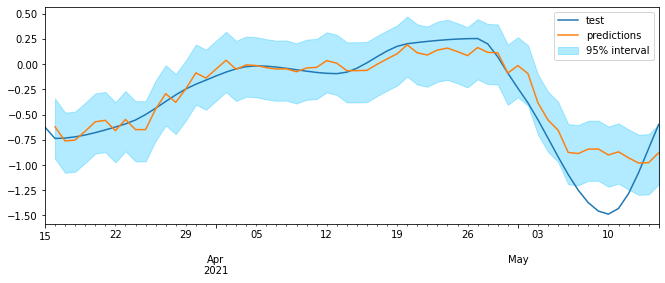

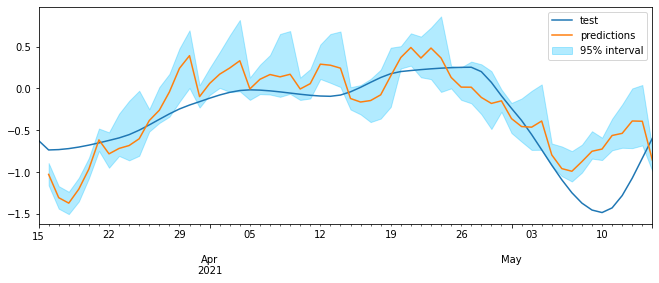

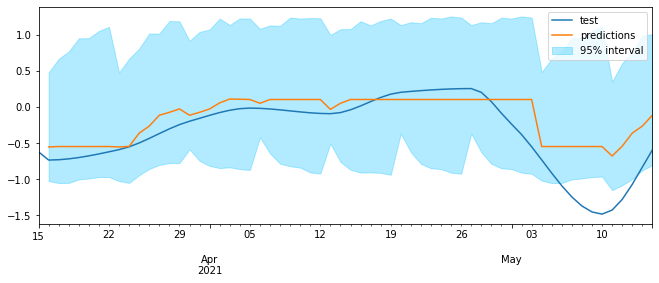

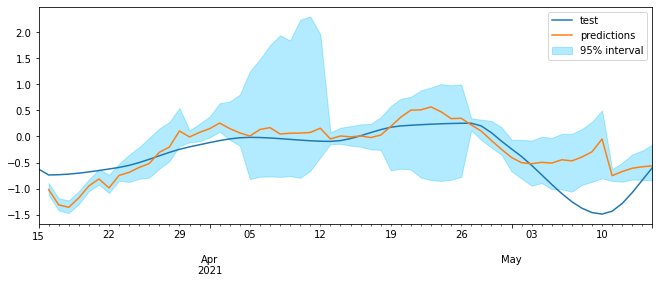

In [ ]:
mae_lgbm_refit_v2 = np.zeros(len(steps))

# Multivariate without refit
for i, step in enumerate(steps):
    mae_lgbm_refit_v2[i] = evaluate_forecasting(data_chopera_norm,data_test,forecaster,False,target,exogenous_var,step,
                                           lags_grid,param_grid,False,end_validation)

In [ ]:
mae_lgbm_bench_refit_v2

array([0.09974418, 0.23900304, 0.24590306, 0.32158445])

In [ ]:
mae_lgbm_refit_v2

array([0.12712283, 0.27038528, 0.24590306, 0.27053967])

#### SVR without contiguous CI

In [ ]:
forecaster = ForecasterAutoreg(
                regressor = SVR(),
                lags = 24
             )

param_grid = {
        'kernel': ('linear','poly'),
        'C':[1e-4,1e-2,1e-1],
        'gamma': [1e-4,1e-2,1e-1],
        'epsilon':[0.001,0.01,0.1]
        }

# Lags used as predictors
lags_grid = [5, 10, 15, [5, 10, 15], [5, 10, 20, 30], [5, 10, 15, 20, 25, 30]]

Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:07<00:00,  1.18s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'C': 0.1, 'epsilon': 0.001, 'gamma': 0.1, 'kernel': 'linear'}
  Backtesting metric: 0.14281989074166815

Backtest error: 0.042925040038891284
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:03<00:00,  1.67it/s]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'C': 0.1, 'epsilon': 0.001, 'gamma': 0.0001, 'kernel': 'linear'}
  Backtesting metric: 0.4095365379420241

Backtest error: 0.18027404234871675
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:03<00:00,  1.89it/s]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'C': 0.01, 'epsilon': 0.1, 'gamma': 0.0001, 'kernel': 'linear'}
  Backtesting metric: 0.6640776090294648

Backtest error: 0.21675569415281665
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:02<00:00,  2.10it/s]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'C': 0.1, 'epsilon': 0.01, 'gamma': 0.01, 'kernel': 'linear'}
  Backtesting metric: 0.5542675785558594

Backtest error: 0.36201776992710716


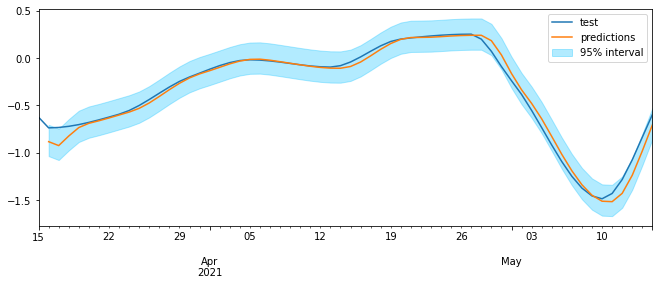

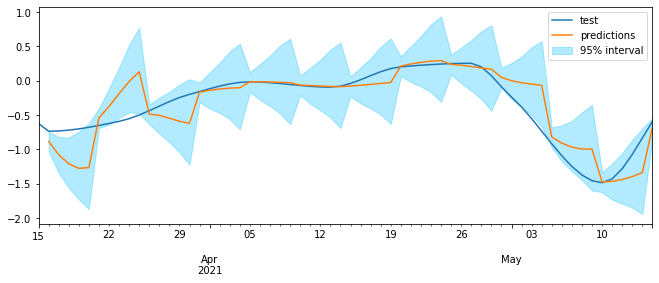

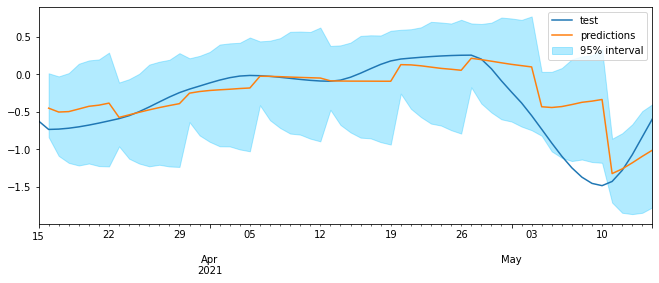

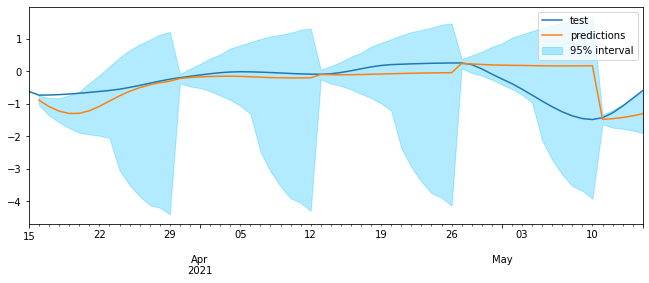

In [ ]:
#Array to store results
mae_svm_bench_v2 = np.zeros(len(steps))

# Univariate without refit
for i, step in enumerate(steps):
    mae_svm_bench_v2[i] = evaluate_forecasting(data_chopera_norm,data_test,forecaster,True,target,exogenous_var,step,
                                           lags_grid,param_grid,False,end_validation)


Number of models compared: 324


loop param_grid: 100%|████████████████████████████████████| 54/54 [00:02<00:00, 18.85it/s]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:17<00:00,  2.98s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'C': 0.1, 'epsilon': 0.001, 'gamma': 0.01, 'kernel': 'linear'}
  Backtesting metric: 0.21668306464075207

Backtest error: 0.09389902222939239
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:06<00:00,  1.02s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'C': 0.1, 'epsilon': 0.1, 'gamma': 0.01, 'kernel': 'linear'}
  Backtesting metric: 0.46233588601476827

Backtest error: 0.3029509504125353
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:05<00:00,  1.20it/s]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'C': 0.1, 'epsilon': 0.1, 'gamma': 0.01, 'kernel': 'linear'}
  Backtesting metric: 0.6421143234973895

Backtest error: 0.38823471179754176
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:03<00:00,  1.51it/s]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'C': 0.01, 'epsilon': 0.01, 'gamma': 0.1, 'kernel': 'linear'}
  Backtesting metric: 0.5918221818395325

Backtest error: 0.4609151835994894


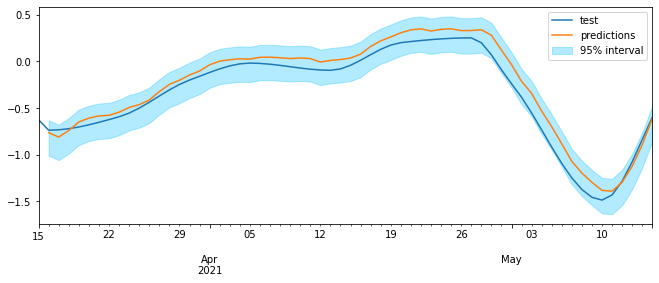

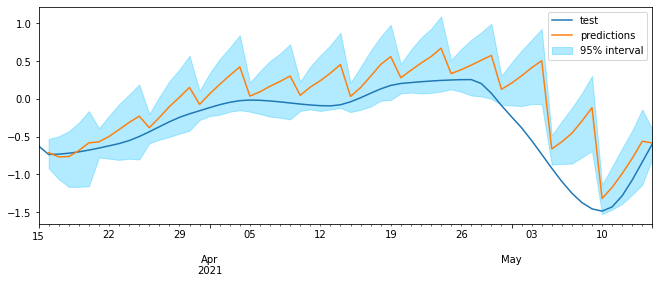

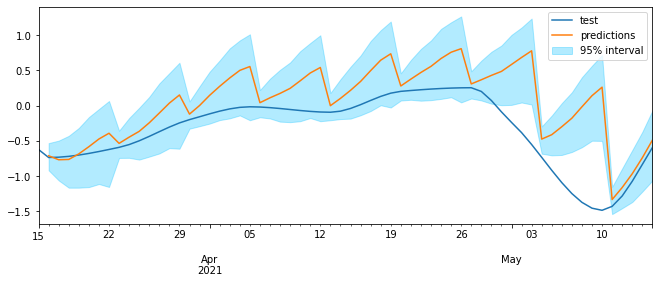

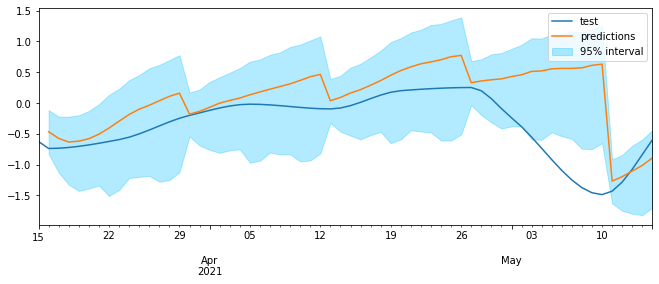

In [ ]:
#Array to store results
mae_svm_v2 = np.zeros(len(steps))

# Univariate without refit
for i, step in enumerate(steps):
    mae_svm_v2[i] = evaluate_forecasting(data_chopera_norm,data_test,forecaster,False,target,exogenous_var,step,
                                           lags_grid,param_grid,False,end_validation)

In [ ]:
mae_svm_bench_v2

array([0.04292504, 0.18027404, 0.21675569, 0.36201777])

In [ ]:
mae_svm_v2

array([0.09389902, 0.30295095, 0.38823471, 0.46091518])

Number of models compared: 324


loop param_grid:   7%|██▋                                  | 4/54 [00:00<00:06,  7.40it/s]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:43<00:00,  7.24s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'C': 0.1, 'epsilon': 0.001, 'gamma': 0.1, 'kernel': 'linear'}
  Backtesting metric: 0.139989353854147

Forecaster will be fit 61 times. This can take substantial amounts of time. If not feasible, try with `refit = False`. 

Backtest error: 0.039828934398427454
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:10<00:00,  1.69s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'C': 0.1, 'epsilon': 0.01, 'gamma': 0.1, 'kernel': 'linear'}
  Backtesting metric: 0.3802710629925516

Backtest error: 0.18551914658531518
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:07<00:00,  1.19s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10] 
  Parameters: {'C': 0.01, 'epsilon': 0.1, 'gamma': 0.1, 'kernel': 'linear'}
  Backtesting metric: 0.6958676578052074

Backtest error: 0.18693752142939013
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:04<00:00,  1.47it/s]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'C': 0.1, 'epsilon': 0.01, 'gamma': 0.0001, 'kernel': 'linear'}
  Backtesting metric: 0.569186969870895

Backtest error: 0.3664672539634546


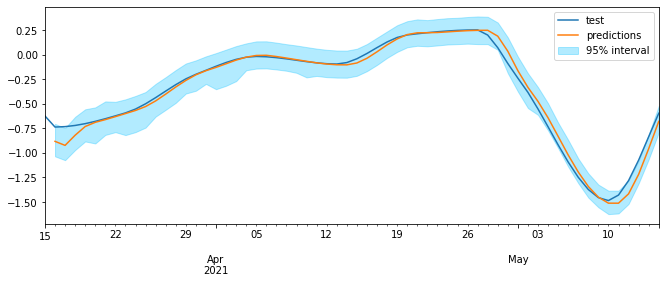

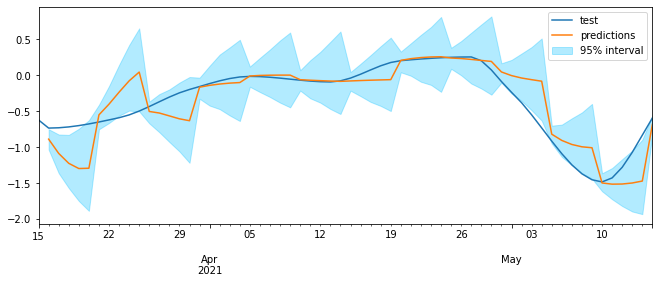

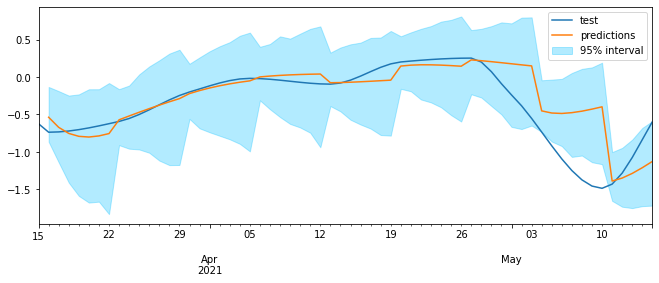

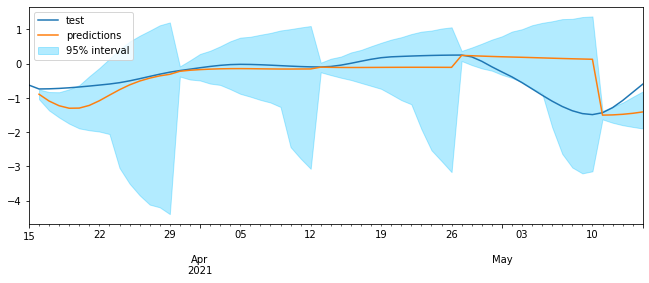

In [ ]:
#Array to store results
mae_svm_bench_refit_v2 = np.zeros(len(steps))

# Univariate without refit
for i, step in enumerate(steps):
    mae_svm_bench_refit_v2[i] = evaluate_forecasting(data_chopera_norm,data_test,forecaster,True,target,exogenous_var,step,
                                           lags_grid,param_grid,True,end_validation)

Number of models compared: 324


loop param_grid:   7%|██▋                                  | 4/54 [00:00<00:09,  5.37it/s]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [01:02<00:00, 10.40s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'C': 0.1, 'epsilon': 0.001, 'gamma': 0.01, 'kernel': 'linear'}
  Backtesting metric: 0.1799000912090893

Forecaster will be fit 61 times. This can take substantial amounts of time. If not feasible, try with `refit = False`. 

Backtest error: 0.05212335880237422
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:14<00:00,  2.42s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'C': 0.1, 'epsilon': 0.1, 'gamma': 0.0001, 'kernel': 'linear'}
  Backtesting metric: 0.4745883271312937

Backtest error: 0.24621551678217776
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:10<00:00,  1.67s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 5 10 15 20 25 30] 
  Parameters: {'C': 0.1, 'epsilon': 0.001, 'gamma': 0.0001, 'kernel': 'linear'}
  Backtesting metric: 0.6705601581790176

Backtest error: 0.5308079963501985
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:05<00:00,  1.07it/s]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'C': 0.01, 'epsilon': 0.1, 'gamma': 0.1, 'kernel': 'linear'}
  Backtesting metric: 0.5872419589932798

Backtest error: 0.3319393908823247


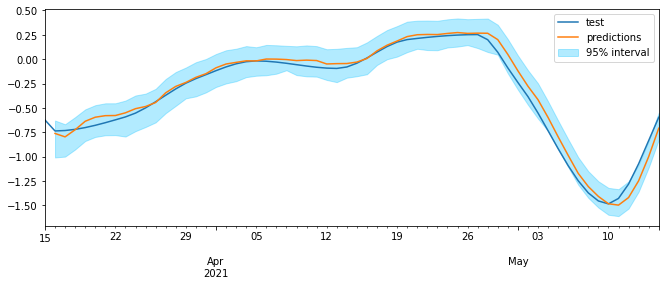

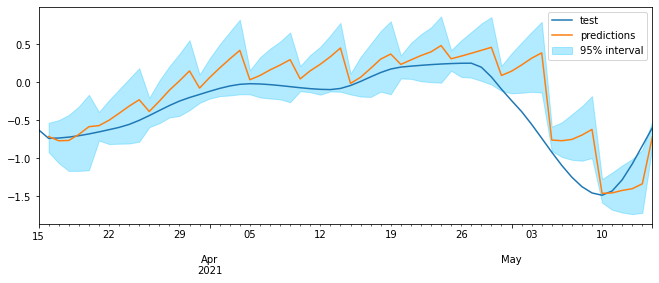

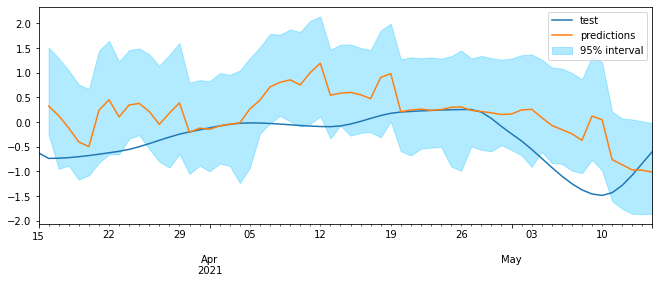

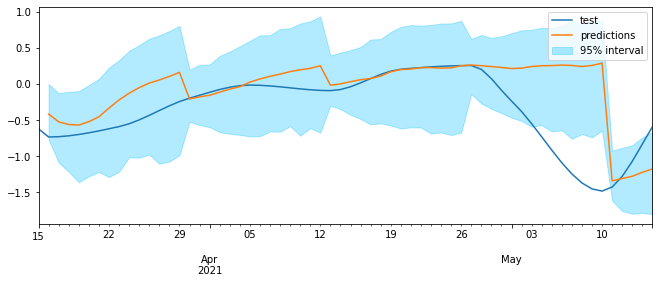

In [ ]:
#Array to store results
mae_svm_refit_v2 = np.zeros(len(steps))

# Univariate without refit
for i, step in enumerate(steps):
    mae_svm_refit_v2[i] = evaluate_forecasting(data_chopera_norm,data_test,forecaster,False,target,exogenous_var,step,
                                           lags_grid,param_grid,True,end_validation)

In [ ]:
mae_svm_bench_refit_v2

array([0.03982893, 0.18551915, 0.18693752, 0.36646725])

In [ ]:
mae_svm_refit_v2

array([0.05212336, 0.24621552, 0.530808  , 0.33193939])

### Virgen de Begoña

In [ ]:
#Drop NA values
data_virgen_de_begoña = data_virgen_de_begoña.dropna()

#Split in train/validation/test
end_train = '2021-02-15'
end_validation = '2021-03-15'

#Normalize data
data_virgen_de_begoña_norm = normalize(data_virgen_de_begoña, 178)

#Subset data
data_train = data_virgen_de_begoña_norm.loc[: end_train, :]
data_val   = data_virgen_de_begoña_norm.loc[end_train:end_validation, :]
data_test  = data_virgen_de_begoña_norm.loc[end_validation:, :]

print(f"Dates train      : {data_train.index.min()} --- {data_train.index.max()}  (n={len(data_train)})")
print(f"Dates validacion : {data_val.index.min()} --- {data_val.index.max()}  (n={len(data_val)})")
print(f"Dates test       : {data_test.index.min()} --- {data_test.index.max()}  (n={len(data_test)})")

data_virgen_de_begoña_norm = data_virgen_de_begoña_norm.drop('closing_virgen_de_begoña',axis=1)
exogenous_var = data_virgen_de_begoña_norm.loc[:, data_virgen_de_begoña_norm.columns != 'ia_virgen_de_begoña'].columns
target = 'ia_virgen_de_begoña'
steps = [1,5,7,14]

Dates train      : 2020-09-28 00:00:00 --- 2021-02-15 00:00:00  (n=141)
Dates validacion : 2021-02-15 00:00:00 --- 2021-03-15 00:00:00  (n=29)
Dates test       : 2021-03-15 00:00:00 --- 2021-05-15 00:00:00  (n=62)


#### XGBRegressor with contiguous CI

In [ ]:
forecaster = ForecasterAutoreg(
                regressor = XGBRegressor(random_state=123),
                lags = 24
             )

param_grid = {
    'n_estimators': [100, 500, 1000],
    'max_depth': [2,3,4,5],
    'learning_rate': [0.001,0.01, 0.1]
    }

# Lags used as predictors
lags_grid = [1, 5, 10, 15,[5, 10], [5, 10, 20, 30], [5, 10, 15, 20, 25, 30]]

Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:05<00:04,  3.92it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [01:10<00:00, 10.01s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 4, 'n_estimators': 1000}
  Backtesting metric: 0.13391069390625426

Backtest error: 0.1484484152826252
Number of models compared: 252


loop param_grid:  58%|█████████████████████               | 21/36 [00:05<00:04,  3.00it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [01:12<00:00, 10.31s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 100}
  Backtesting metric: 0.32096812826571375

Backtest error: 0.8132641715570152
Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:05<00:04,  3.61it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [01:13<00:00, 10.53s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'learning_rate': 0.001, 'max_depth': 5, 'n_estimators': 1000}
  Backtesting metric: 0.43896581195719414

Backtest error: 0.910258953215664
Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:05<00:04,  3.57it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [01:13<00:00, 10.57s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 5, 'n_estimators': 1000}
  Backtesting metric: 0.4971055483189569

Backtest error: 0.5967166017821143


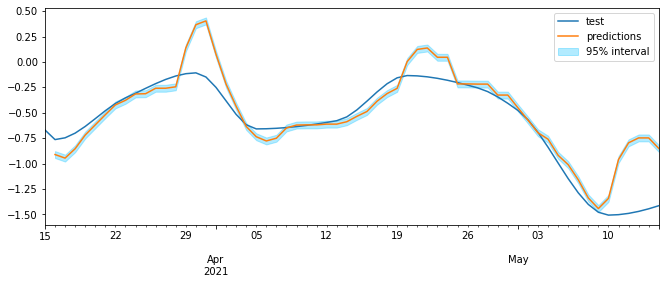

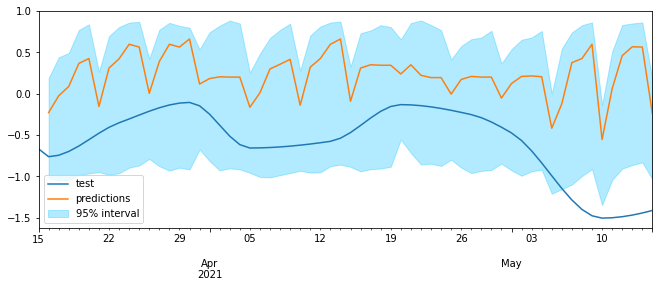

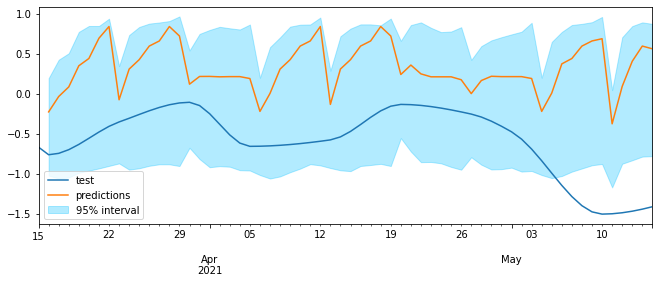

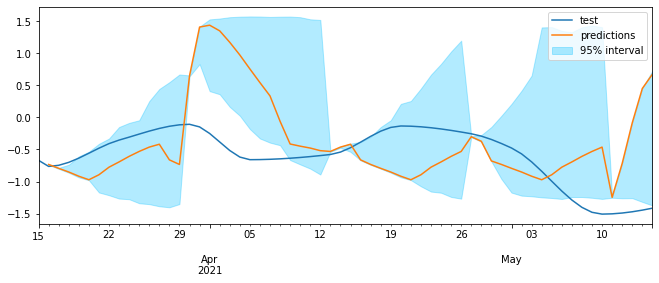

In [ ]:
#Array to store results
mae_xgb_bench = np.zeros(len(steps))

# Univariate without refit
for i, step in enumerate(steps):
    mae_xgb_bench[i] = evaluate_forecasting(data_virgen_de_begoña_norm,data_test,forecaster,True,target,exogenous_var,step,
                                           lags_grid,param_grid,False,end_validation)

Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:07<00:06,  2.58it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [01:40<00:00, 14.41s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500}
  Backtesting metric: 0.1876256369128511

Backtest error: 0.2527323275788309
Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:07<00:05,  2.73it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [01:27<00:00, 12.54s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500}
  Backtesting metric: 0.281627762849946

Backtest error: 0.4480462544284174
Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:06<00:05,  3.00it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [01:26<00:00, 12.29s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 2, 'n_estimators': 1000}
  Backtesting metric: 0.3308726923288754

Backtest error: 0.48291607368495987
Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:06<00:05,  3.00it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [01:24<00:00, 12.14s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500}
  Backtesting metric: 0.3648580869344324

Backtest error: 0.5317356754346534


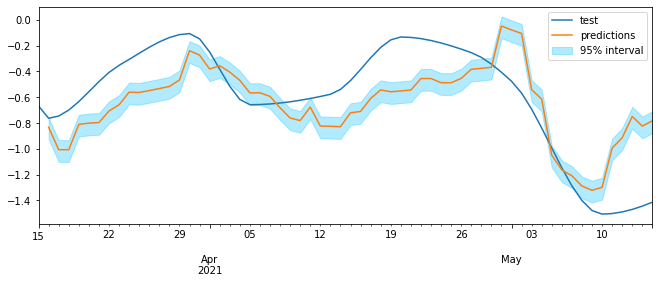

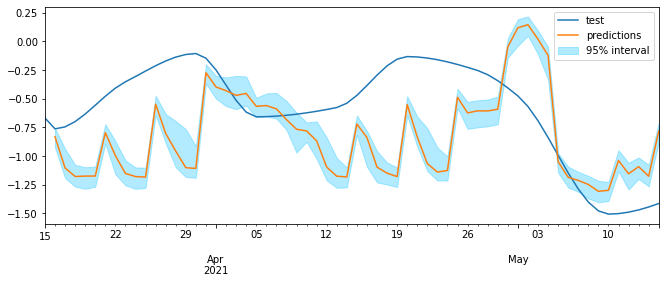

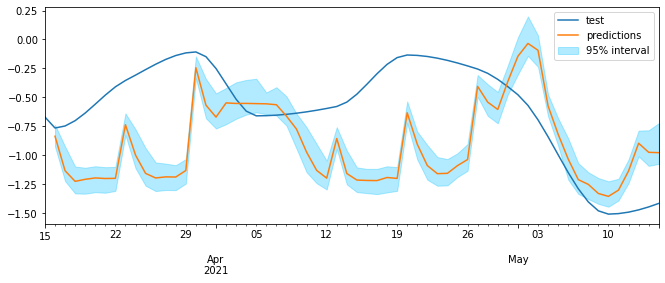

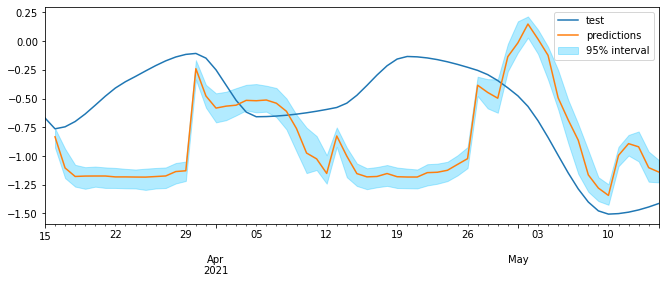

In [ ]:
mae_xgb = np.zeros(len(steps))

# Multivariate without refit
for i, step in enumerate(steps):
    mae_xgb[i] = evaluate_forecasting(data_virgen_de_begoña_norm,data_test,forecaster,False,target,exogenous_var,step,
                                           lags_grid,param_grid,False,end_validation)

In [ ]:
mae_xgb_bench

array([0.14844842, 0.81326417, 0.91025895, 0.5967166 ])

In [ ]:
mae_xgb

array([0.25273233, 0.44804625, 0.48291607, 0.53173568])

Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [01:58<01:33,  5.84s/it]


loop lags_grid: 100%|██████████████████████████████████████| 7/7 [26:06<00:00, 223.80s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 5, 'n_estimators': 500}
  Backtesting metric: 0.12891798230911844

Forecaster will be fit 61 times. This can take substantial amounts of time. If not feasible, try with `refit = False`. 

Backtest error: 0.10949200589909322
Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:27<00:21,  1.33s/it]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [06:08<00:00, 52.60s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 100}
  Backtesting metric: 0.3779071935628023

Backtest error: 0.7790091729890889
Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:18<00:14,  1.09it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [04:11<00:00, 35.89s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 100}
  Backtesting metric: 0.41803829564063133

Backtest error: 0.8451980147686371
Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:10<00:07,  2.03it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [02:13<00:00, 19.13s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 4, 'n_estimators': 100}
  Backtesting metric: 0.4135588881249838

Backtest error: 0.35475779619396647


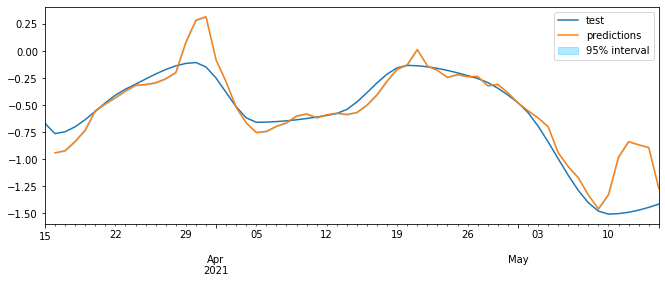

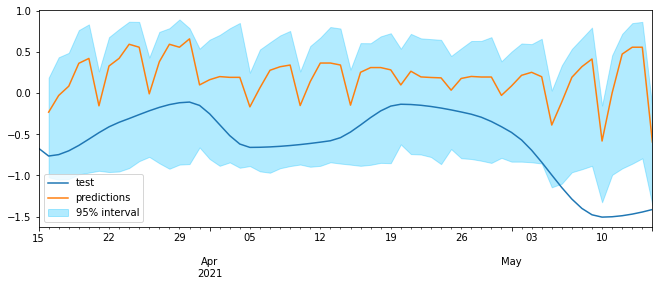

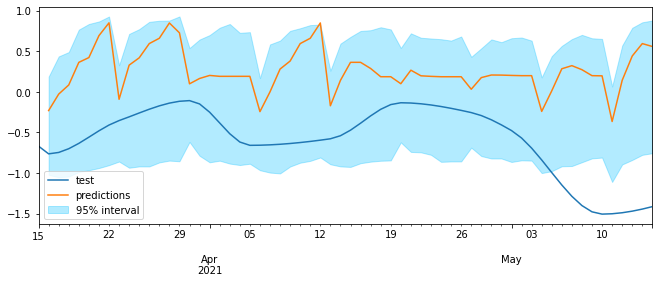

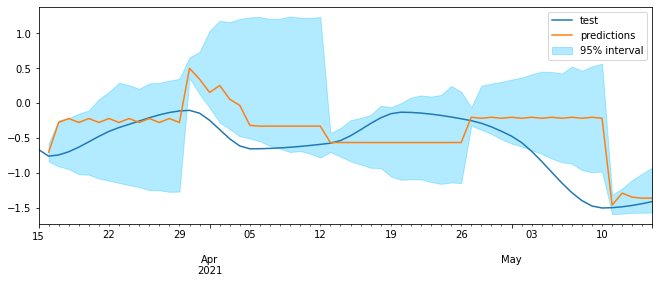

In [ ]:
#Array to store results
mae_xgb_bench_refit = np.zeros(len(steps))

# Univariate without refit
for i, step in enumerate(steps):
    mae_xgb_bench_refit[i] = evaluate_forecasting(data_virgen_de_begoña_norm,data_test,forecaster,True,target,exogenous_var,step,
                                           lags_grid,param_grid,True,end_validation)

Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [02:30<01:59,  7.47s/it]


loop lags_grid: 100%|██████████████████████████████████████| 7/7 [32:12<00:00, 276.07s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 1000}
  Backtesting metric: 0.12073776845653124

Forecaster will be fit 61 times. This can take substantial amounts of time. If not feasible, try with `refit = False`. 

Backtest error: 0.12162073068730152
Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:33<00:26,  1.67s/it]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [07:10<00:00, 61.56s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 4, 'n_estimators': 500}
  Backtesting metric: 0.22412788252862764

Backtest error: 0.21282009554173117
Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:22<00:18,  1.14s/it]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [04:54<00:00, 42.01s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 5 10 20 30] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 100}
  Backtesting metric: 0.26535398179349345

Backtest error: 0.33792784268976667
Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:12<00:09,  1.66it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [02:36<00:00, 22.38s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 5 10] 
  Parameters: {'learning_rate': 0.001, 'max_depth': 2, 'n_estimators': 1000}
  Backtesting metric: 0.3664638657545213

Backtest error: 0.4009741264289615


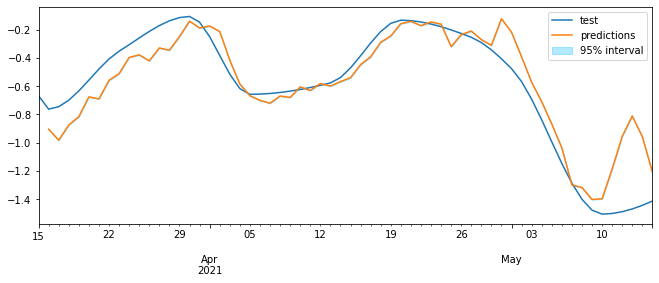

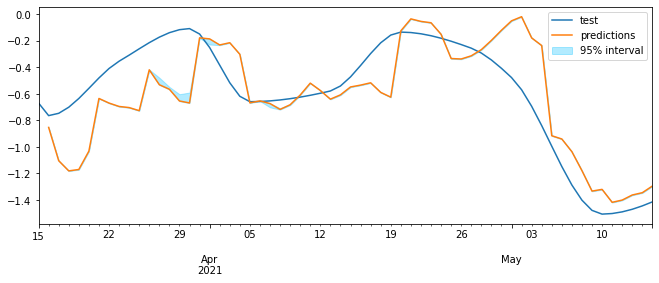

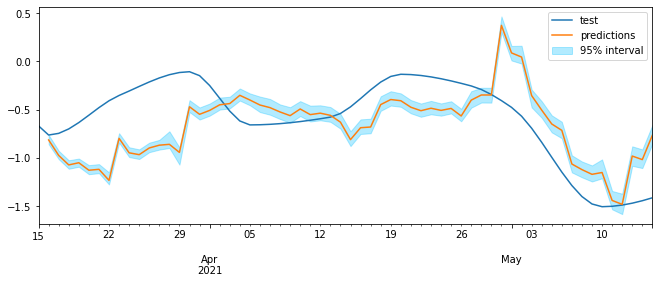

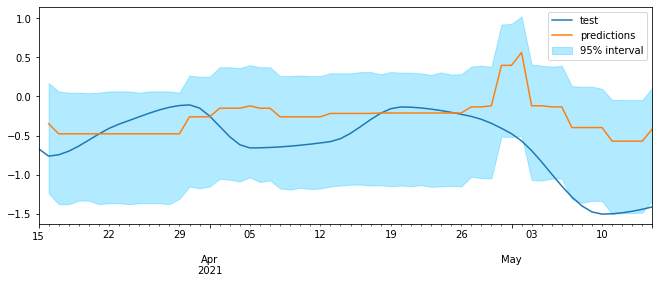

In [ ]:
mae_xgb_refit = np.zeros(len(steps))

# Multivariate without refit
for i, step in enumerate(steps):
    mae_xgb_refit[i] = evaluate_forecasting(data_virgen_de_begoña_norm,data_test,forecaster,False,target,exogenous_var,step,
                                           lags_grid,param_grid,True,end_validation)

In [ ]:
mae_xgb_bench_refit

array([0.10949201, 0.77900917, 0.84519801, 0.3547578 ])

In [ ]:
mae_xgb_refit

array([0.12162073, 0.2128201 , 0.33792784, 0.40097413])

#### LGBMegressor with contiguous CI

In [ ]:
forecaster = ForecasterAutoreg(
                regressor = LGBMRegressor(random_state=123),
                lags = 24
             )

param_grid = {
    'n_estimators': [100, 500, 1000],
    'max_depth': [2,3,4,5],
    'learning_rate': [0.001,0.01, 0.1]
    }

# Lags used as predictors
lags_grid = [1, 5, 10, 15,[5, 10], [5, 10, 20, 30], [5, 10, 15, 20, 25, 30]]

Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:19<00:00,  2.74s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 2, 'n_estimators': 500}
  Backtesting metric: 0.15118224275126632

Backtest error: 0.10883920792232779
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:15<00:00,  2.25s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500}
  Backtesting metric: 0.3100252874583857

Backtest error: 0.27471742863681914
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:16<00:00,  2.36s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 500}
  Backtesting metric: 0.5128328390389125

Backtest error: 0.48026272231544687
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:16<00:00,  2.33s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500}
  Backtesting metric: 0.5085896242950839

Backtest error: 0.7123643104888404


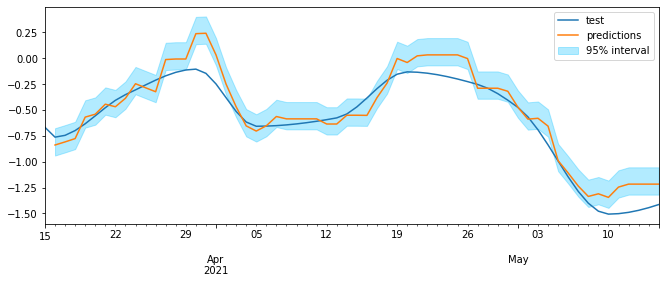

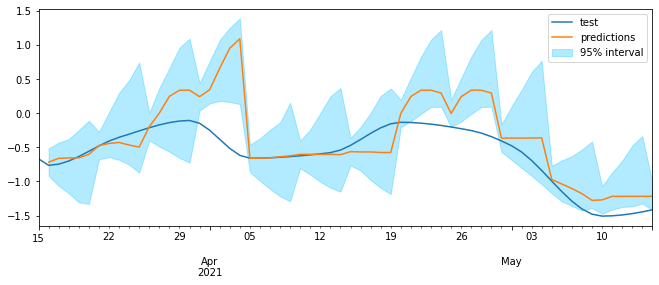

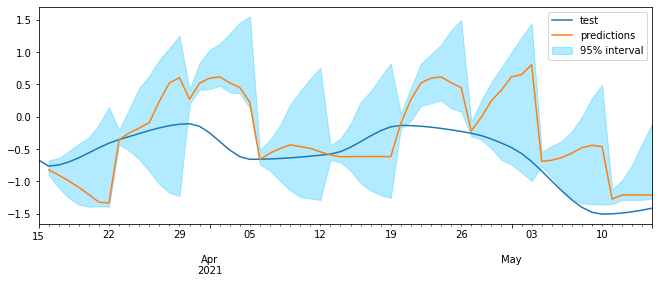

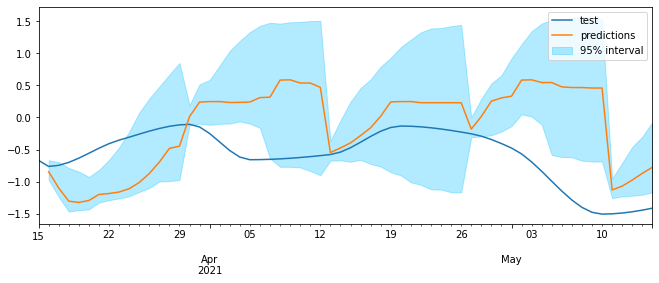

In [ ]:
#Array to store results
mae_lgbm_bench = np.zeros(len(steps))

# Univariate without refit
for i, step in enumerate(steps):
    mae_lgbm_bench[i] = evaluate_forecasting(data_virgen_de_begoña_norm,data_test,forecaster,True,target,exogenous_var,step,
                                           lags_grid,param_grid,False,end_validation)

Number of models compared: 252


loop param_grid:  58%|█████████████████████               | 21/36 [00:03<00:02,  6.08it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:38<00:00,  5.51s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 2, 'n_estimators': 500}
  Backtesting metric: 0.1984292854721507

Backtest error: 0.2781099358787737
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:23<00:00,  3.37s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 5 10] 
  Parameters: {'learning_rate': 0.001, 'max_depth': 2, 'n_estimators': 1000}
  Backtesting metric: 0.24796271045290577

Backtest error: 0.39354772727566745
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:23<00:00,  3.33s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 5 10] 
  Parameters: {'learning_rate': 0.001, 'max_depth': 2, 'n_estimators': 1000}
  Backtesting metric: 0.24796271045290577

Backtest error: 0.39354772727566745
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:21<00:00,  3.11s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 5 10] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 2, 'n_estimators': 100}
  Backtesting metric: 0.2416104848389906

Backtest error: 0.39464884286636664


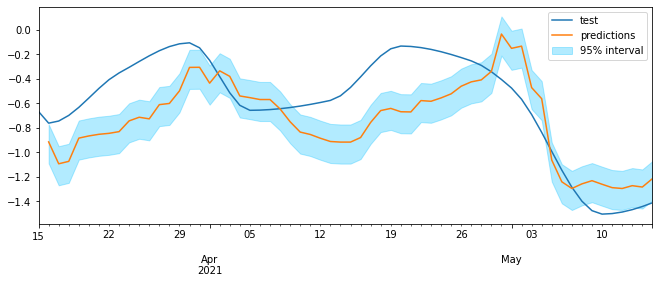

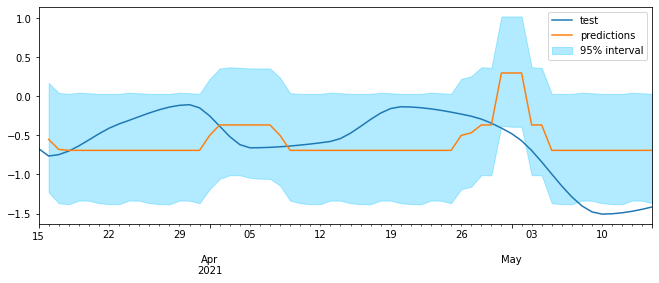

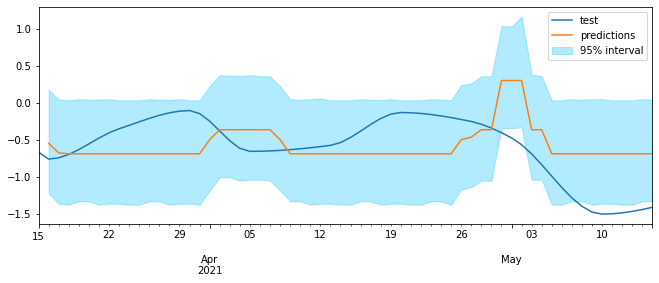

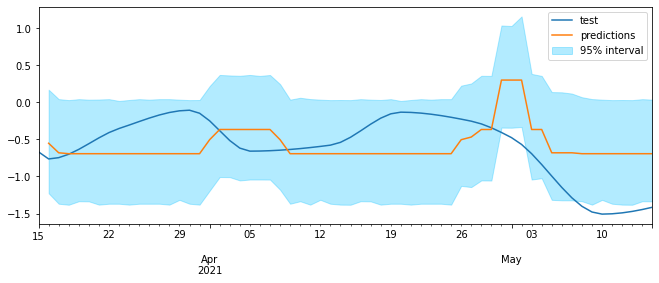

In [ ]:
mae_lgbm = np.zeros(len(steps))

# Multivariate without refit
for i, step in enumerate(steps):
    mae_lgbm[i] = evaluate_forecasting(data_virgen_de_begoña_norm,data_test,forecaster,False,target,exogenous_var,step,
                                           lags_grid,param_grid,False,end_validation)

In [ ]:
mae_lgbm_bench

array([0.10883921, 0.27471743, 0.48026272, 0.71236431])

In [ ]:
mae_lgbm

array([0.27810994, 0.39354773, 0.39354773, 0.39464884])

Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:24<00:00,  3.51s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 2, 'n_estimators': 500}
  Backtesting metric: 0.15118224275126632

Backtest error: 0.10883920792232779
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:19<00:00,  2.76s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500}
  Backtesting metric: 0.3100252874583857

Backtest error: 0.27471742863681914
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:19<00:00,  2.73s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 500}
  Backtesting metric: 0.5128328390389125

Backtest error: 0.48026272231544687
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:19<00:00,  2.73s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500}
  Backtesting metric: 0.5085896242950839

Backtest error: 0.7123643104888404


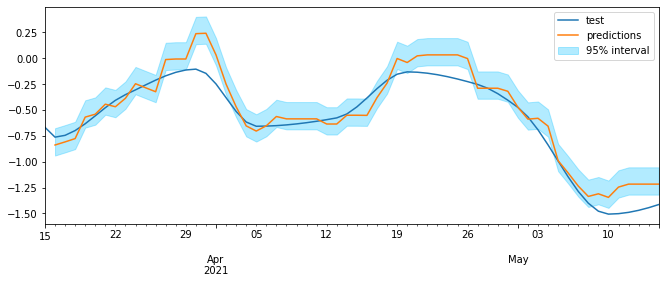

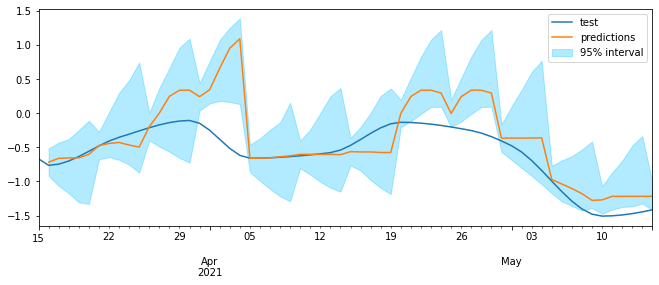

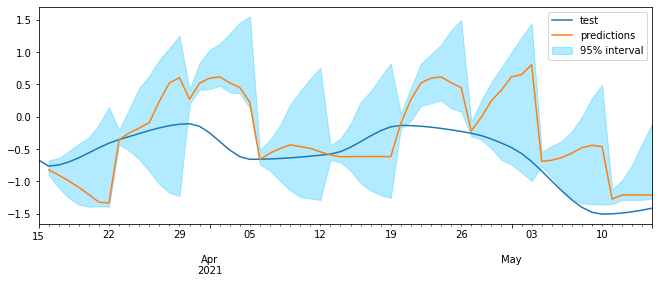

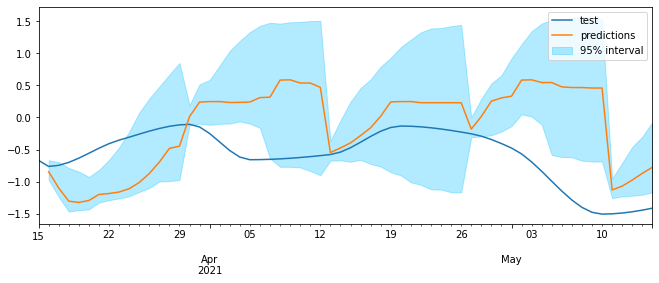

In [ ]:
#Array to store results
mae_lgbm_bench_refit = np.zeros(len(steps))

# Univariate without refit
for i, step in enumerate(steps):
    mae_lgbm_bench_refit[i] = evaluate_forecasting(data_virgen_de_begoña_norm,data_test,forecaster,True,target,exogenous_var,step,
                                           lags_grid,param_grid,False,end_validation)

Number of models compared: 252


loop param_grid:  58%|█████████████████████               | 21/36 [00:03<00:02,  5.58it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:41<00:00,  5.99s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 2, 'n_estimators': 500}
  Backtesting metric: 0.1984292854721507

Backtest error: 0.2781099358787737
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:24<00:00,  3.52s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 5 10] 
  Parameters: {'learning_rate': 0.001, 'max_depth': 2, 'n_estimators': 1000}
  Backtesting metric: 0.24796271045290577

Backtest error: 0.39354772727566745
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:23<00:00,  3.30s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 5 10] 
  Parameters: {'learning_rate': 0.001, 'max_depth': 2, 'n_estimators': 1000}
  Backtesting metric: 0.24796271045290577

Backtest error: 0.39354772727566745
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:22<00:00,  3.16s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 5 10] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 2, 'n_estimators': 100}
  Backtesting metric: 0.2416104848389906

Backtest error: 0.39464884286636664


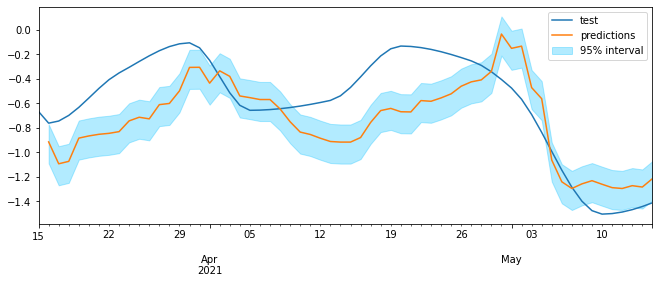

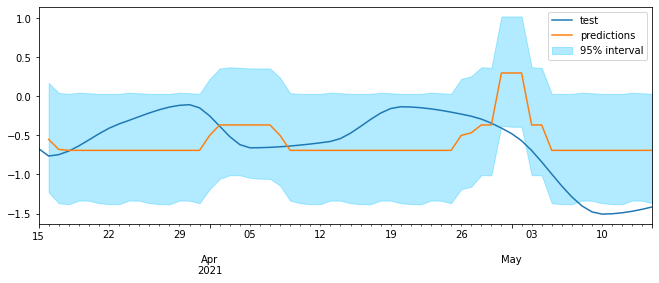

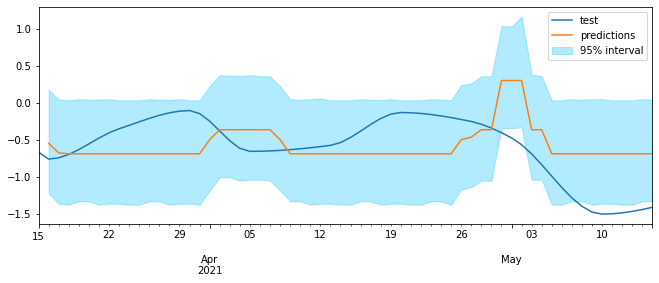

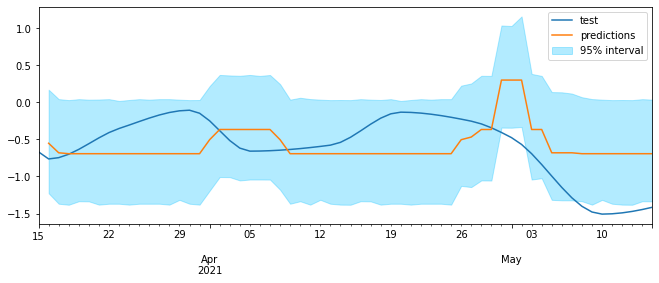

In [ ]:
mae_lgbm_refit = np.zeros(len(steps))

# Multivariate without refit
for i, step in enumerate(steps):
    mae_lgbm_refit[i] = evaluate_forecasting(data_virgen_de_begoña_norm,data_test,forecaster,False,target,exogenous_var,step,
                                           lags_grid,param_grid,False,end_validation)

In [ ]:
mae_lgbm_bench_refit

array([0.10883921, 0.27471743, 0.48026272, 0.71236431])

In [ ]:
mae_lgbm_refit

array([0.10883921, 0.27471743, 0.48026272, 0.71236431])

#### SVR with contiguous CI

In [ ]:
forecaster = ForecasterAutoreg(
                regressor = SVR(),
                lags = 24
             )

param_grid = {
        'kernel': ('linear','poly'),
        'C':[1e-4,1e-2,1e-1],
        'gamma': [1e-4,1e-2,1e-1],
        'epsilon':[0.001,0.01,0.1]
        }

# Lags used as predictors
lags_grid = [5, 10, 15, [5, 10, 15], [5, 10, 20, 30], [5, 10, 15, 20, 25, 30]]

Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:07<00:00,  1.19s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'C': 0.1, 'epsilon': 0.01, 'gamma': 0.1, 'kernel': 'linear'}
  Backtesting metric: 0.1358675933352313

Backtest error: 0.036260849114861535
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:03<00:00,  1.67it/s]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'C': 0.1, 'epsilon': 0.1, 'gamma': 0.1, 'kernel': 'linear'}
  Backtesting metric: 0.3309195471133438

Backtest error: 0.19633035767769913
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:03<00:00,  1.88it/s]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'C': 0.01, 'epsilon': 0.01, 'gamma': 0.1, 'kernel': 'linear'}
  Backtesting metric: 0.5701964006857364

Backtest error: 0.20216632891261999
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:02<00:00,  2.11it/s]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'C': 0.1, 'epsilon': 0.1, 'gamma': 0.1, 'kernel': 'linear'}
  Backtesting metric: 0.5274831674312607

Backtest error: 0.3706923117307302


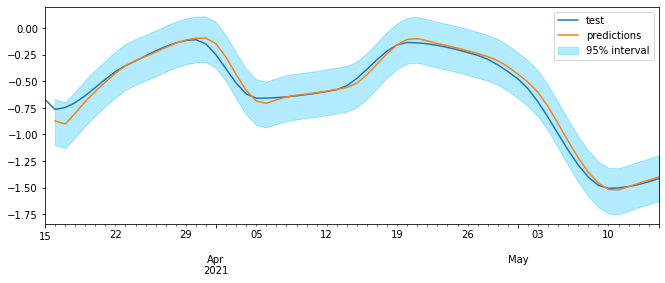

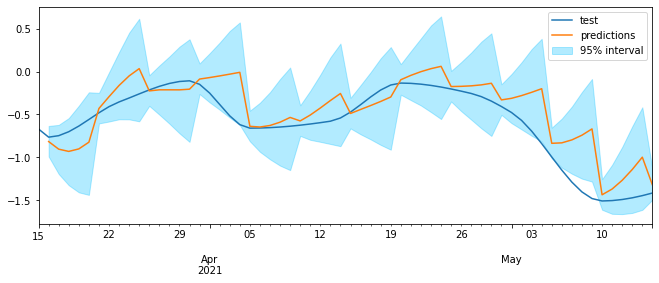

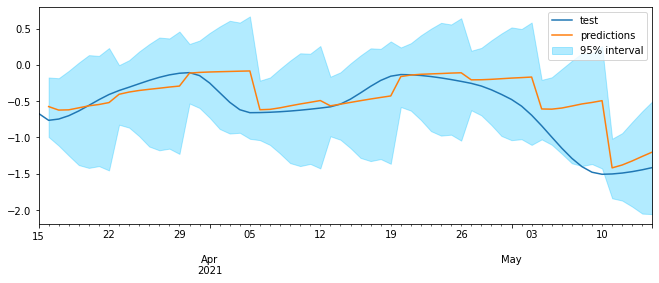

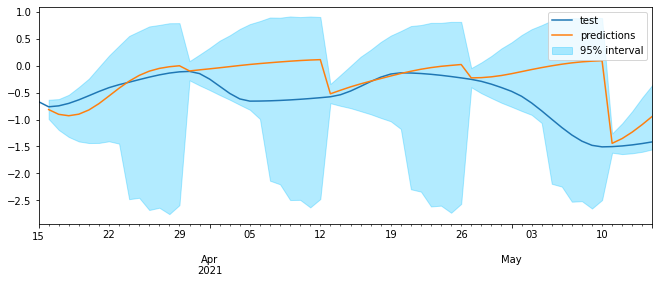

In [ ]:
#Array to store results
mae_svm_bench = np.zeros(len(steps))

# Univariate without refit
for i, step in enumerate(steps):
    mae_svm_bench[i] = evaluate_forecasting(data_virgen_de_begoña_norm,data_test,forecaster,True,target,exogenous_var,step,
                                           lags_grid,param_grid,False,end_validation)

Number of models compared: 324


loop param_grid: 100%|████████████████████████████████████| 54/54 [00:02<00:00, 18.37it/s]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:18<00:00,  3.02s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'C': 0.1, 'epsilon': 0.001, 'gamma': 0.1, 'kernel': 'linear'}
  Backtesting metric: 0.12550001138486774

Backtest error: 0.14404753883612023
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:06<00:00,  1.04s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'C': 0.1, 'epsilon': 0.1, 'gamma': 0.01, 'kernel': 'linear'}
  Backtesting metric: 0.2287801093407269

Backtest error: 0.27189352534998135
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:05<00:00,  1.16it/s]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 5 10 15] 
  Parameters: {'C': 0.1, 'epsilon': 0.1, 'gamma': 0.1, 'kernel': 'linear'}
  Backtesting metric: 0.2330684179369336

Backtest error: 0.3324997608846203
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:04<00:00,  1.46it/s]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 5 10 15] 
  Parameters: {'C': 0.1, 'epsilon': 0.1, 'gamma': 0.01, 'kernel': 'linear'}
  Backtesting metric: 0.2307551231062638

Backtest error: 0.3471960421456106


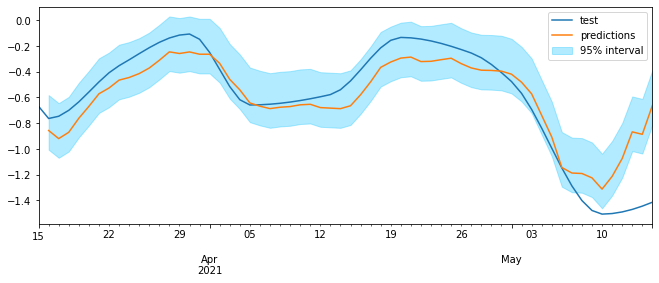

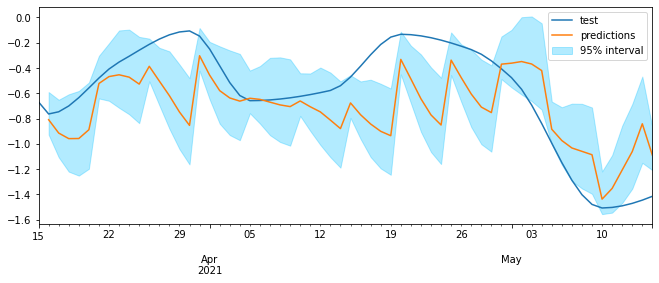

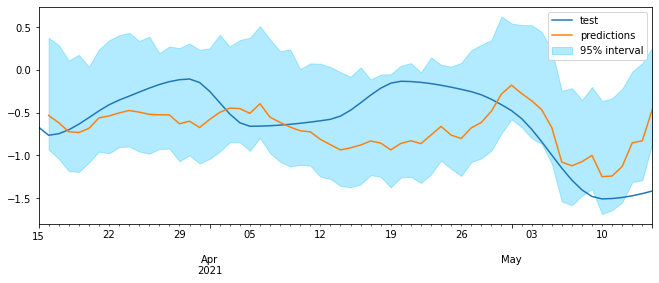

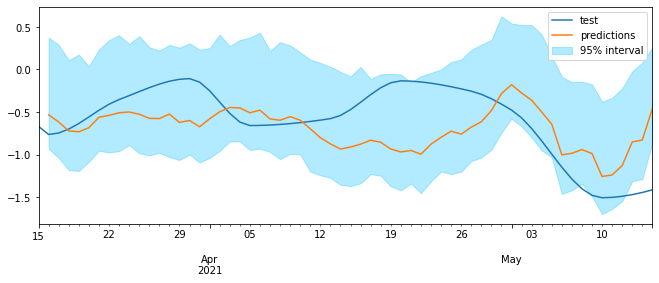

In [ ]:
#Array to store results
mae_svm = np.zeros(len(steps))

# Univariate without refit
for i, step in enumerate(steps):
    mae_svm[i] = evaluate_forecasting(data_virgen_de_begoña_norm,data_test,forecaster,False,target,exogenous_var,step,
                                           lags_grid,param_grid,False,end_validation)

In [ ]:
mae_svm_bench

array([0.03626085, 0.19633036, 0.20216633, 0.37069231])

In [ ]:
mae_svm

array([0.14404754, 0.27189353, 0.33249976, 0.34719604])

Number of models compared: 324


loop param_grid:   7%|██▋                                  | 4/54 [00:00<00:06,  7.38it/s]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:43<00:00,  7.25s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'C': 0.1, 'epsilon': 0.01, 'gamma': 0.01, 'kernel': 'linear'}
  Backtesting metric: 0.13085104535020817

Forecaster will be fit 61 times. This can take substantial amounts of time. If not feasible, try with `refit = False`. 

Backtest error: 0.04030461359268063
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:10<00:00,  1.70s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'C': 0.1, 'epsilon': 0.1, 'gamma': 0.0001, 'kernel': 'linear'}
  Backtesting metric: 0.3253534850759028

Backtest error: 0.19240083209362183
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:07<00:00,  1.19s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'C': 0.01, 'epsilon': 0.1, 'gamma': 0.0001, 'kernel': 'linear'}
  Backtesting metric: 0.575935924990804

Backtest error: 0.1905050308455673
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:04<00:00,  1.45it/s]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'C': 0.01, 'epsilon': 0.001, 'gamma': 0.1, 'kernel': 'linear'}
  Backtesting metric: 0.5223610317659501

Backtest error: 0.33640582873418234


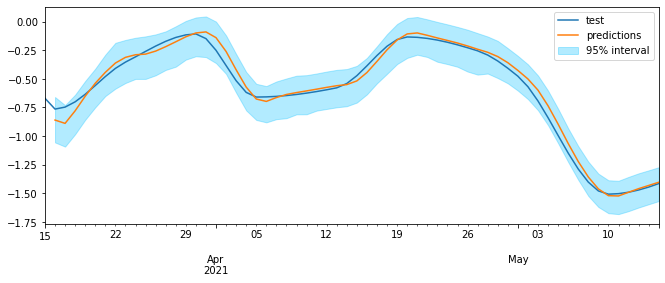

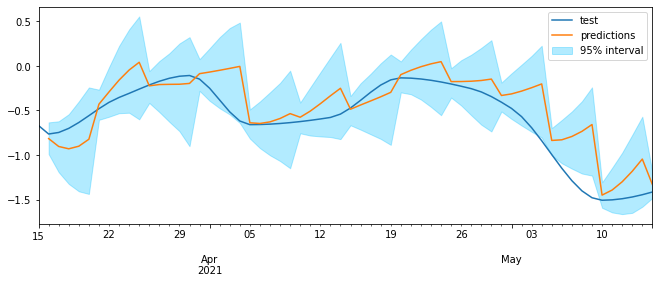

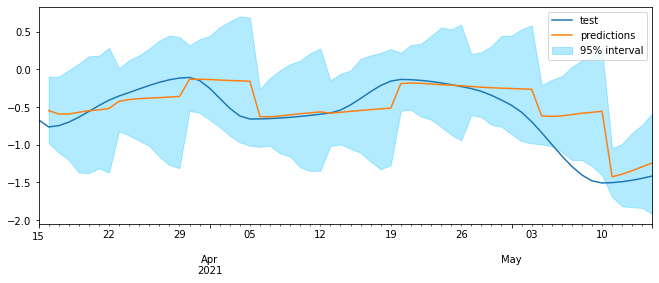

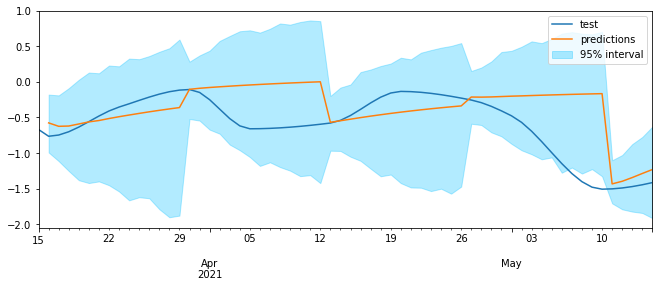

In [ ]:
#Array to store results
mae_svm_bench_refit = np.zeros(len(steps))

# Univariate without refit
for i, step in enumerate(steps):
    mae_svm_bench_refit[i] = evaluate_forecasting(data_virgen_de_begoña_norm,data_test,forecaster,True,target,exogenous_var,step,
                                           lags_grid,param_grid,True,end_validation)

Number of models compared: 324


loop param_grid:   7%|██▋                                  | 4/54 [00:00<00:09,  5.27it/s]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [01:05<00:00, 10.87s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10] 
  Parameters: {'C': 0.1, 'epsilon': 0.1, 'gamma': 0.01, 'kernel': 'linear'}
  Backtesting metric: 0.11101343926528065

Forecaster will be fit 61 times. This can take substantial amounts of time. If not feasible, try with `refit = False`. 

Backtest error: 0.08760944838085652
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:15<00:00,  2.52s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'C': 0.1, 'epsilon': 0.1, 'gamma': 0.1, 'kernel': 'linear'}
  Backtesting metric: 0.22844144746973066

Backtest error: 0.19313361222677558
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:10<00:00,  1.75s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 5 10 20 30] 
  Parameters: {'C': 0.1, 'epsilon': 0.1, 'gamma': 0.01, 'kernel': 'linear'}
  Backtesting metric: 0.24810335219678084

Backtest error: 0.32021998515492106
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:05<00:00,  1.03it/s]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 5 10 15] 
  Parameters: {'C': 0.1, 'epsilon': 0.001, 'gamma': 0.1, 'kernel': 'linear'}
  Backtesting metric: 0.24461806671207934

Backtest error: 0.2771813166390989


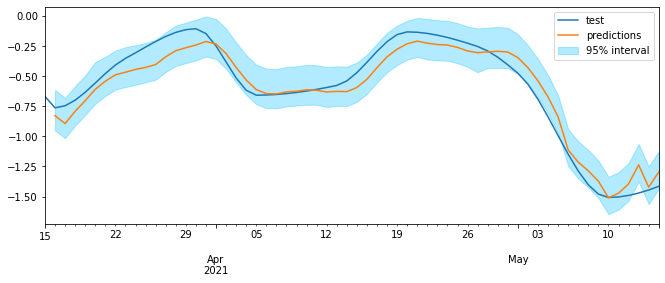

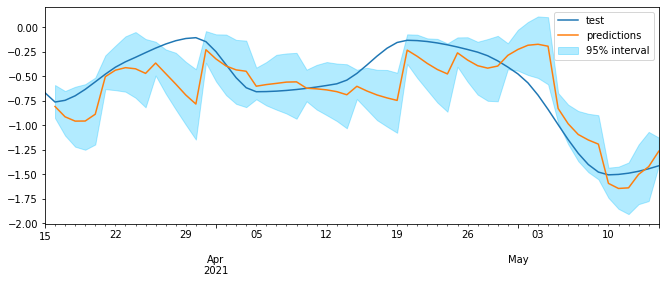

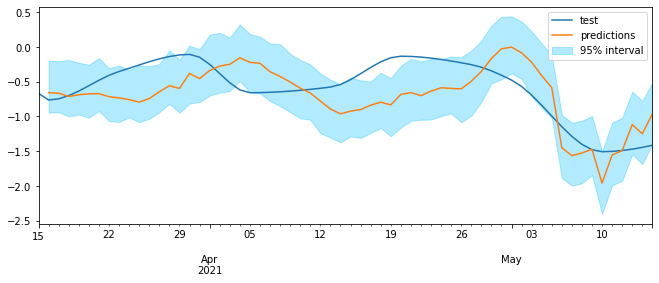

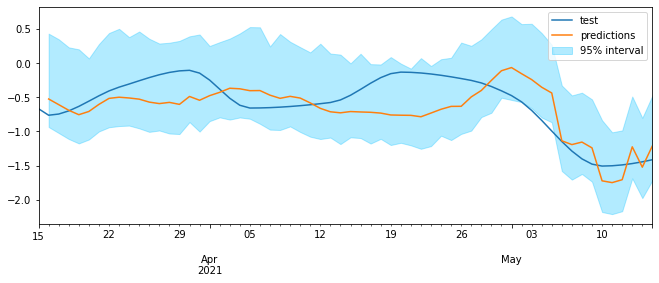

In [ ]:
#Array to store results
mae_svm_refit = np.zeros(len(steps))

# Univariate without refit
for i, step in enumerate(steps):
    mae_svm_refit[i] = evaluate_forecasting(data_virgen_de_begoña_norm,data_test,forecaster,False,target,exogenous_var,step,
                                           lags_grid,param_grid,True,end_validation)

In [ ]:
mae_svm_bench_refit

array([0.04030461, 0.19240083, 0.19050503, 0.33640583])

In [ ]:
mae_svm_bench

array([0.03626085, 0.19633036, 0.20216633, 0.37069231])

#### XGBRegressor without contiguous CI

In [ ]:
data_virgen_de_begoña_norm = data_virgen_de_begoña_norm.drop('ia_fuencarral',axis=1)

In [ ]:
exogenous_var = data_virgen_de_begoña_norm.loc[:,data_virgen_de_begoña_norm.columns != 'ia_virgen_de_begoña'].columns

In [ ]:
forecaster = ForecasterAutoreg(
                regressor = XGBRegressor(random_state=123),
                lags = 24
             )

param_grid = {
    'n_estimators': [100, 500, 1000],
    'max_depth': [2,3,4,5],
    'learning_rate': [0.001,0.01, 0.1]
    }

# Lags used as predictors
lags_grid = [1, 5, 10, 15,[5, 10], [5, 10, 20, 30], [5, 10, 15, 20, 25, 30]]

Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:06<00:04,  3.32it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [01:20<00:00, 11.50s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 4, 'n_estimators': 1000}
  Backtesting metric: 0.13391069390625426

Backtest error: 0.1484484152826252
Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:05<00:04,  3.46it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [01:17<00:00, 11.07s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 100}
  Backtesting metric: 0.32096812826571375

Backtest error: 0.8132641715570152
Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:05<00:04,  3.46it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [01:17<00:00, 11.05s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'learning_rate': 0.001, 'max_depth': 5, 'n_estimators': 1000}
  Backtesting metric: 0.43896581195719414

Backtest error: 0.910258953215664
Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:05<00:04,  3.43it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [01:17<00:00, 11.07s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 5, 'n_estimators': 1000}
  Backtesting metric: 0.4971055483189569

Backtest error: 0.5967166017821143


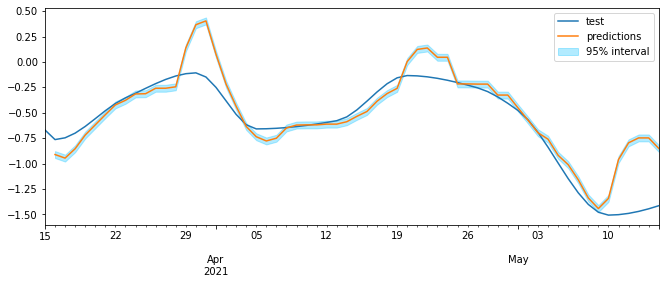

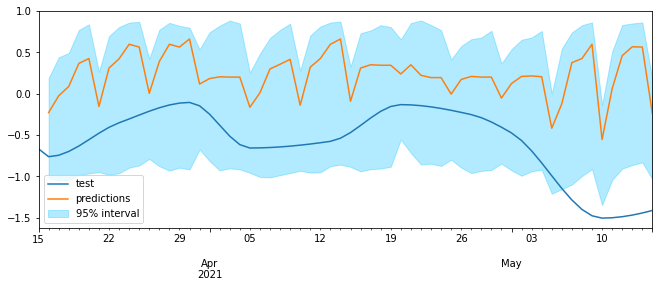

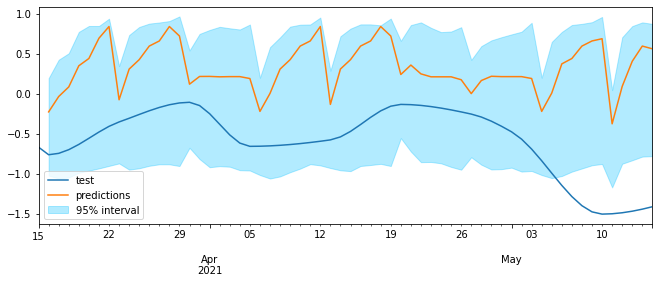

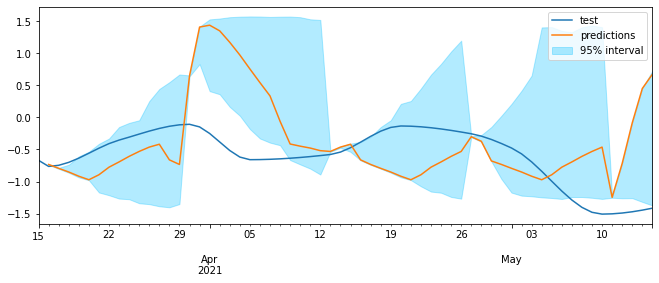

In [ ]:
#Array to store results
mae_xgb_bench_v2 = np.zeros(len(steps))

# Univariate without refit
for i, step in enumerate(steps):
    mae_xgb_bench_v2[i] = evaluate_forecasting(data_virgen_de_begoña_norm,data_test,forecaster,True,target,exogenous_var,step,
                                           lags_grid,param_grid,False,end_validation)

Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:08<00:06,  2.49it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [01:43<00:00, 14.81s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 500}
  Backtesting metric: 0.13508709896422952

Backtest error: 0.14282277153326112
Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:06<00:05,  2.93it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [01:27<00:00, 12.53s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 100}
  Backtesting metric: 0.3386787259889041

Backtest error: 0.8392248908347921
Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:06<00:05,  2.94it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [01:26<00:00, 12.40s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'learning_rate': 0.001, 'max_depth': 4, 'n_estimators': 1000}
  Backtesting metric: 0.4647312950701202

Backtest error: 0.9712197094354196
Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:06<00:05,  3.00it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [01:25<00:00, 12.25s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 2, 'n_estimators': 1000}
  Backtesting metric: 0.4438992652715603

Backtest error: 0.4513833151406547


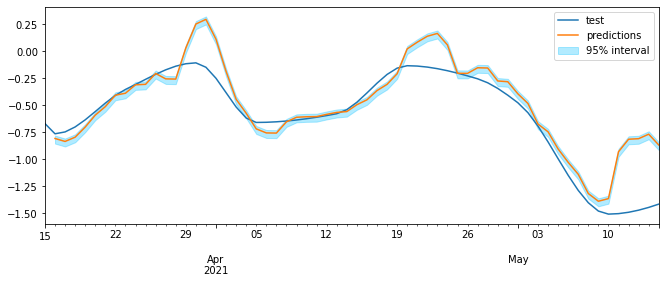

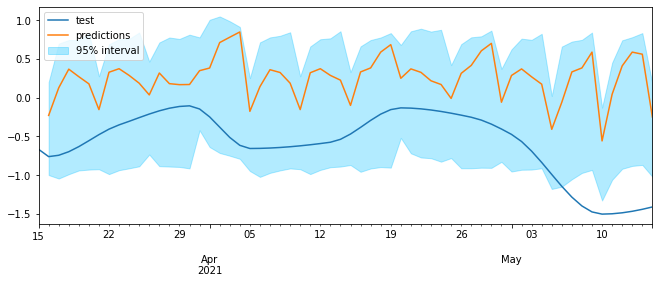

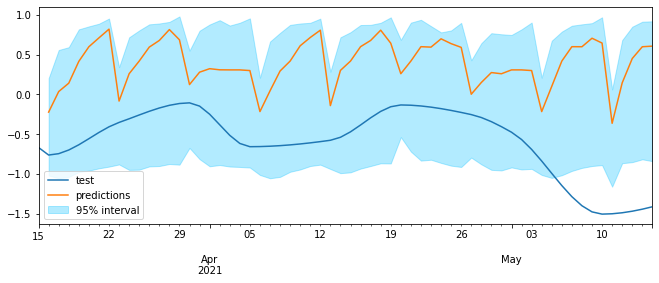

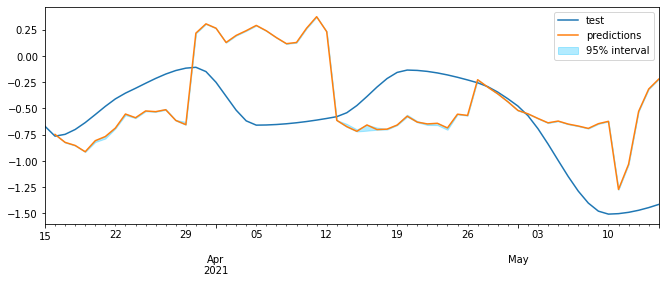

In [ ]:
mae_xgb_v2 = np.zeros(len(steps))

# Multivariate without refit
for i, step in enumerate(steps):
    mae_xgb_v2[i] = evaluate_forecasting(data_virgen_de_begoña_norm,data_test,forecaster,False,target,exogenous_var,step,
                                           lags_grid,param_grid,False,end_validation)

In [ ]:
mae_xgb_bench_v2

array([0.14844842, 0.81326417, 0.91025895, 0.5967166 ])

In [ ]:
mae_xgb_v2

array([0.14282277, 0.83922489, 0.97121971, 0.45138332])

Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [02:02<01:37,  6.07s/it]


loop lags_grid: 100%|██████████████████████████████████████| 7/7 [27:39<00:00, 237.11s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 5, 'n_estimators': 500}
  Backtesting metric: 0.12891798230911844

Forecaster will be fit 61 times. This can take substantial amounts of time. If not feasible, try with `refit = False`. 

Backtest error: 0.10949200589909322
Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:27<00:21,  1.34s/it]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [06:11<00:00, 53.06s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 100}
  Backtesting metric: 0.3779071935628023

Backtest error: 0.7790091729890889
Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:19<00:14,  1.07it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [04:15<00:00, 36.48s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 100}
  Backtesting metric: 0.41803829564063133

Backtest error: 0.8451980147686371
Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:10<00:08,  1.97it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [02:16<00:00, 19.48s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 4, 'n_estimators': 100}
  Backtesting metric: 0.4135588881249838

Backtest error: 0.35475779619396647


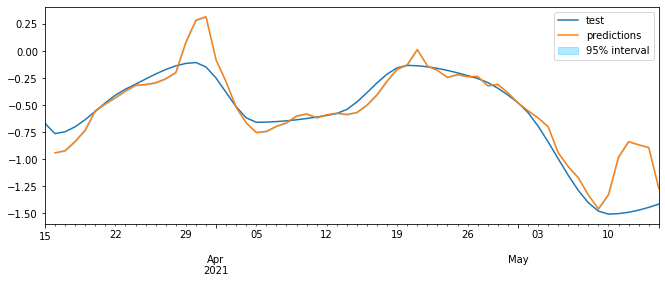

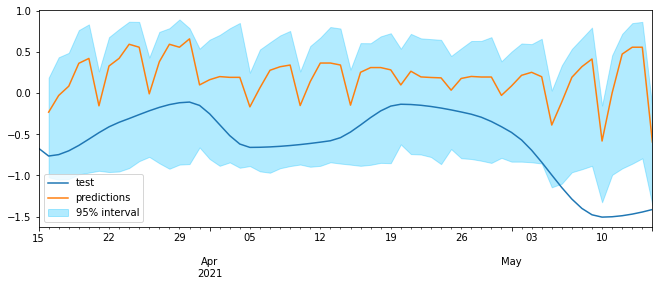

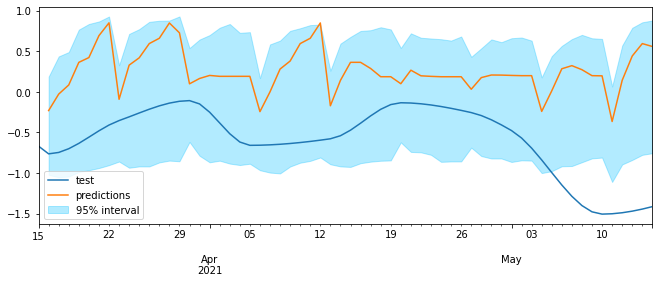

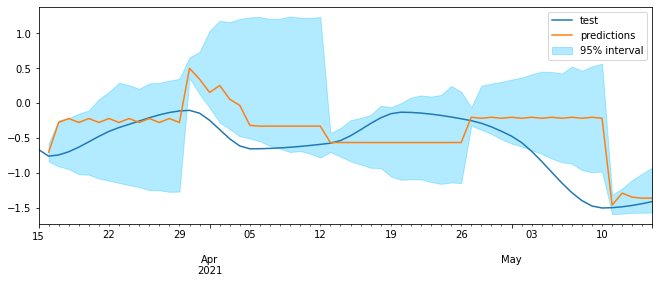

In [ ]:
#Array to store results
mae_xgb_bench_refit_v2 = np.zeros(len(steps))

# Univariate without refit
for i, step in enumerate(steps):
    mae_xgb_bench_refit_v2[i] = evaluate_forecasting(data_virgen_de_begoña_norm,data_test,forecaster,True,target,exogenous_var,step,
                                           lags_grid,param_grid,True,end_validation)

Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [02:30<02:00,  7.55s/it]


loop lags_grid: 100%|██████████████████████████████████████| 7/7 [32:10<00:00, 275.81s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 4, 'n_estimators': 100}
  Backtesting metric: 0.14523221994356167

Forecaster will be fit 61 times. This can take substantial amounts of time. If not feasible, try with `refit = False`. 

Backtest error: 0.09877875474882972
Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:33<00:26,  1.64s/it]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [07:09<00:00, 61.35s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 100}
  Backtesting metric: 0.4122475554895087

Backtest error: 0.7382166400139599
Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:22<00:17,  1.11s/it]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [04:52<00:00, 41.78s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 100}
  Backtesting metric: 0.47468281497030673

Backtest error: 0.7848110505837791
Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:12<00:10,  1.50it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [02:42<00:00, 23.16s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 4, 'n_estimators': 100}
  Backtesting metric: 0.4671014913503247

Backtest error: 0.49671482101430536


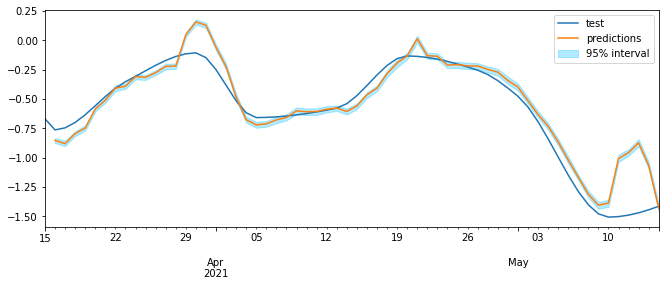

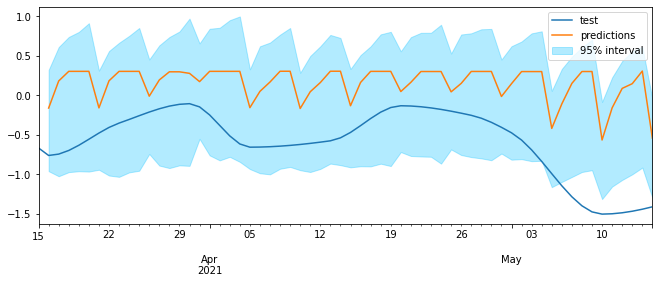

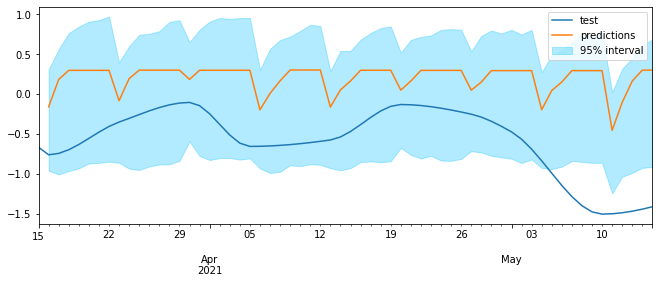

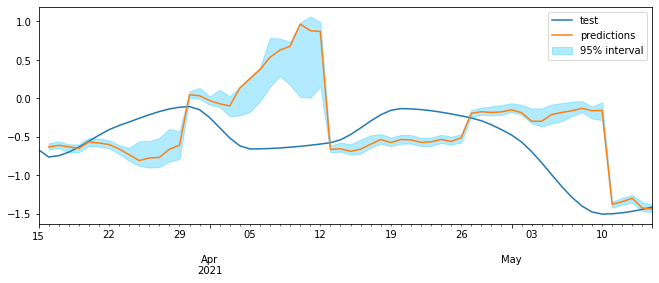

In [ ]:
mae_xgb_refit_v2 = np.zeros(len(steps))

# Multivariate without refit
for i, step in enumerate(steps):
    mae_xgb_refit_v2[i] = evaluate_forecasting(data_virgen_de_begoña_norm,data_test,forecaster,False,target,exogenous_var,step,
                                           lags_grid,param_grid,True,end_validation)

In [ ]:
mae_xgb_bench_refit_v2

array([0.10949201, 0.77900917, 0.84519801, 0.3547578 ])

In [ ]:
mae_xgb_refit_v2

array([0.09877875, 0.73821664, 0.78481105, 0.49671482])

#### LGBMegressor without contiguous CI

In [ ]:
forecaster = ForecasterAutoreg(
                regressor = LGBMRegressor(random_state=123),
                lags = 24
             )

param_grid = {
    'n_estimators': [100, 500, 1000],
    'max_depth': [2,3,4,5],
    'learning_rate': [0.001,0.01, 0.1]
    }

# Lags used as predictors
lags_grid = [1, 5, 10, 15,[5, 10], [5, 10, 20, 30], [5, 10, 15, 20, 25, 30]]

Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:25<00:00,  3.69s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 2, 'n_estimators': 500}
  Backtesting metric: 0.15118224275126632

Backtest error: 0.10883920792232779
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:20<00:00,  2.91s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500}
  Backtesting metric: 0.3100252874583857

Backtest error: 0.27471742863681914
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:19<00:00,  2.84s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 500}
  Backtesting metric: 0.5128328390389125

Backtest error: 0.48026272231544687
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:19<00:00,  2.82s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500}
  Backtesting metric: 0.5085896242950839

Backtest error: 0.7123643104888404


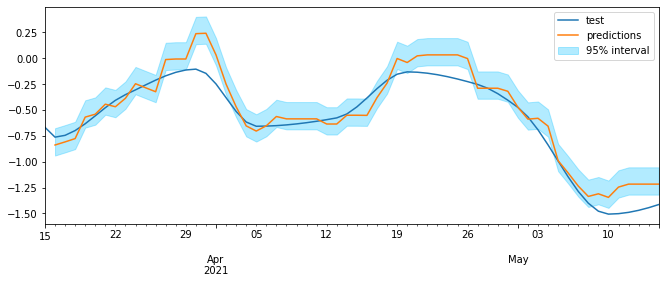

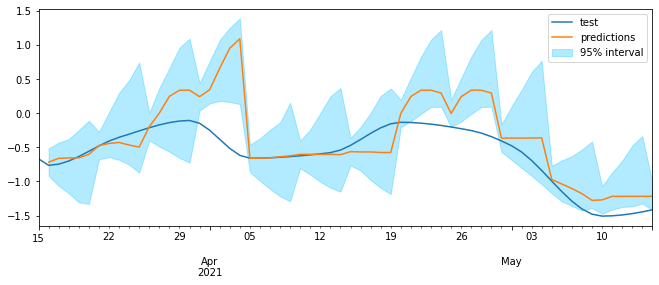

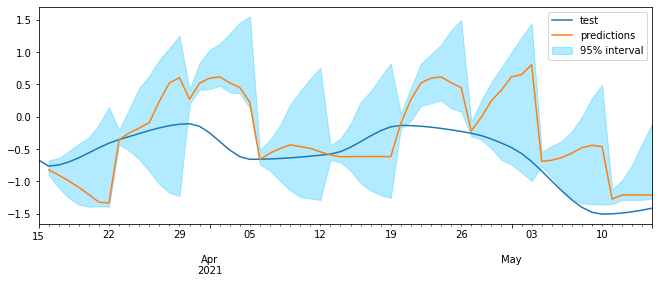

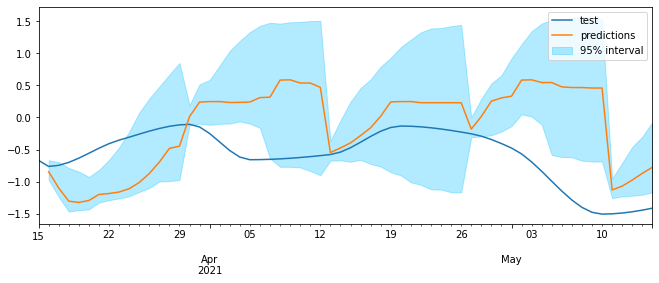

In [ ]:
#Array to store results
mae_lgbm_bench_v2 = np.zeros(len(steps))

# Univariate without refit
for i, step in enumerate(steps):
    mae_lgbm_bench_v2[i] = evaluate_forecasting(data_virgen_de_begoña_norm,data_test,forecaster,True,target,exogenous_var,step,
                                           lags_grid,param_grid,False,end_validation)

Number of models compared: 252


loop param_grid:  58%|█████████████████████               | 21/36 [00:03<00:02,  5.43it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:43<00:00,  6.20s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 4, 'n_estimators': 1000}
  Backtesting metric: 0.17673607567595506

Backtest error: 0.13632632376264456
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:25<00:00,  3.62s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 4, 'n_estimators': 500}
  Backtesting metric: 0.286757883695559

Backtest error: 0.3497807093126329
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:23<00:00,  3.40s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 100}
  Backtesting metric: 0.5248345943856642

Backtest error: 0.4961270239198859
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:22<00:00,  3.20s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 4, 'n_estimators': 1000}
  Backtesting metric: 0.5059822117355846

Backtest error: 0.7318586907881168


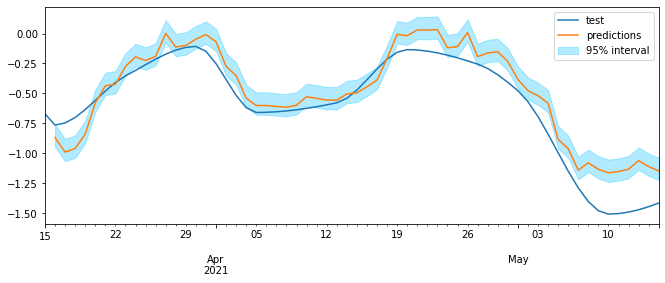

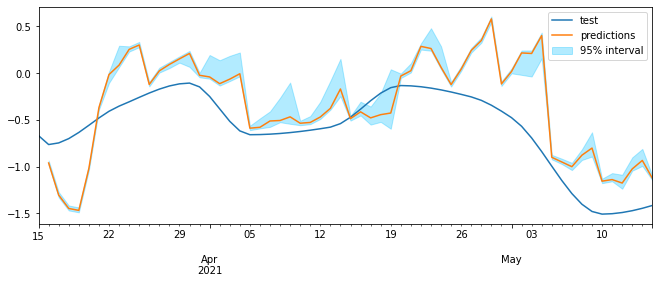

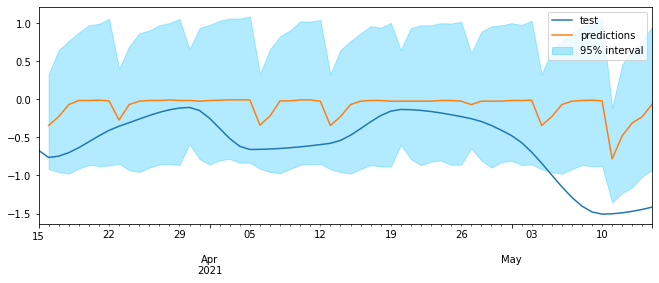

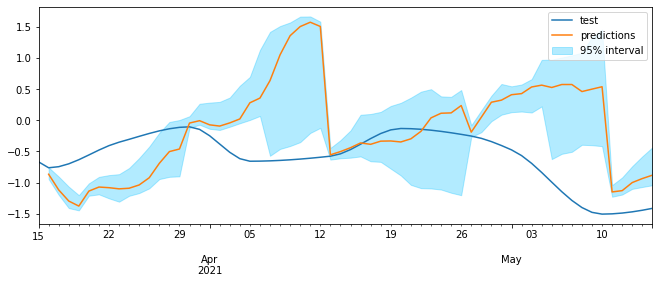

In [ ]:
mae_lgbm_v2 = np.zeros(len(steps))

# Multivariate without refit
for i, step in enumerate(steps):
    mae_lgbm_v2[i] = evaluate_forecasting(data_virgen_de_begoña_norm,data_test,forecaster,False,target,exogenous_var,step,
                                           lags_grid,param_grid,False,end_validation)

In [ ]:
mae_lgbm_bench_v2

array([0.10883921, 0.27471743, 0.48026272, 0.71236431])

In [ ]:
mae_lgbm_v2


array([0.13632632, 0.34978071, 0.49612702, 0.73185869])

Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:25<00:00,  3.70s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 2, 'n_estimators': 500}
  Backtesting metric: 0.15118224275126632

Backtest error: 0.10883920792232779
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:20<00:00,  2.93s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500}
  Backtesting metric: 0.3100252874583857

Backtest error: 0.27471742863681914
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:20<00:00,  2.87s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 500}
  Backtesting metric: 0.5128328390389125

Backtest error: 0.48026272231544687
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:19<00:00,  2.85s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500}
  Backtesting metric: 0.5085896242950839

Backtest error: 0.7123643104888404


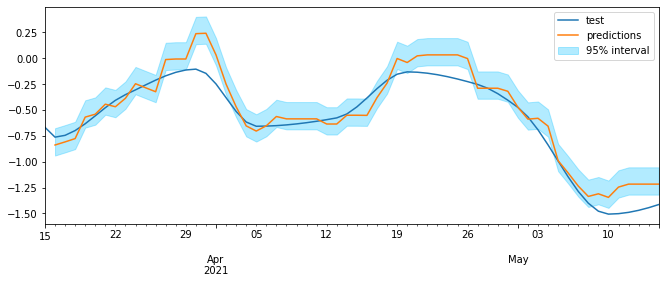

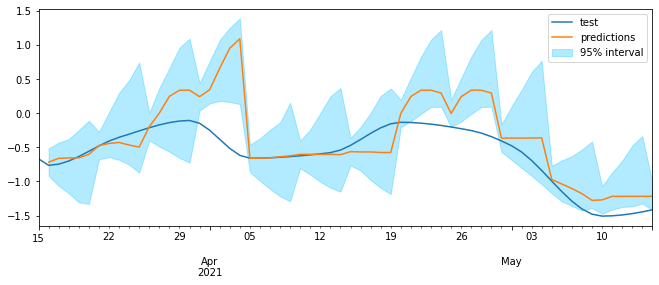

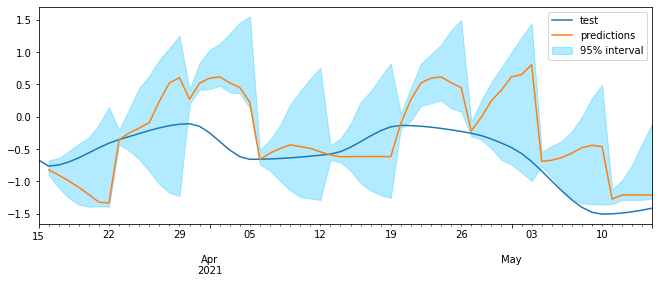

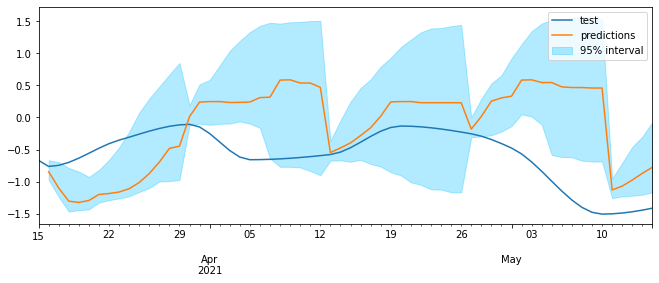

In [ ]:
#Array to store results
mae_lgbm_bench_refit_v2 = np.zeros(len(steps))

# Univariate without refit
for i, step in enumerate(steps):
    mae_lgbm_bench_refit_v2[i] = evaluate_forecasting(data_virgen_de_begoña_norm,data_test,forecaster,True,target,exogenous_var,step,
                                           lags_grid,param_grid,False,end_validation)

Number of models compared: 252


loop param_grid:  56%|████████████████████                | 20/36 [00:03<00:02,  6.04it/s]


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:43<00:00,  6.19s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 4, 'n_estimators': 1000}
  Backtesting metric: 0.17673607567595506

Backtest error: 0.13632632376264456
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:25<00:00,  3.67s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 4, 'n_estimators': 500}
  Backtesting metric: 0.286757883695559

Backtest error: 0.3497807093126329
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:23<00:00,  3.41s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 100}
  Backtesting metric: 0.5248345943856642

Backtest error: 0.4961270239198859
Number of models compared: 252


loop lags_grid: 100%|███████████████████████████████████████| 7/7 [00:22<00:00,  3.20s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'learning_rate': 0.01, 'max_depth': 4, 'n_estimators': 1000}
  Backtesting metric: 0.5059822117355846

Backtest error: 0.7318586907881168


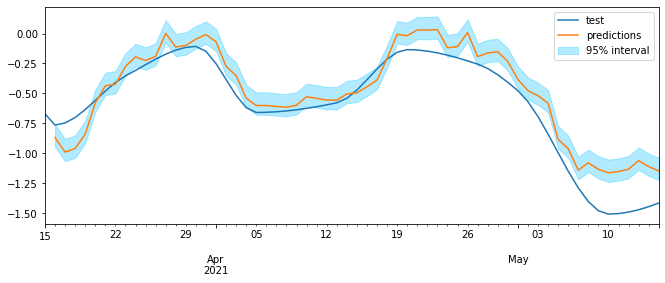

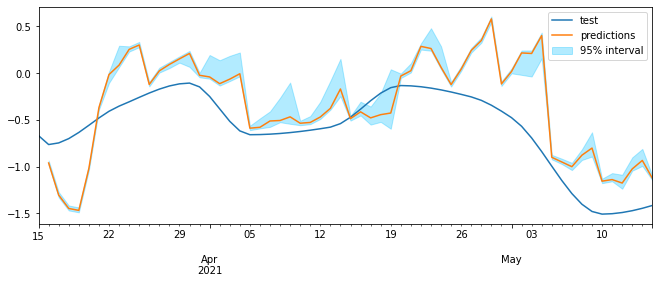

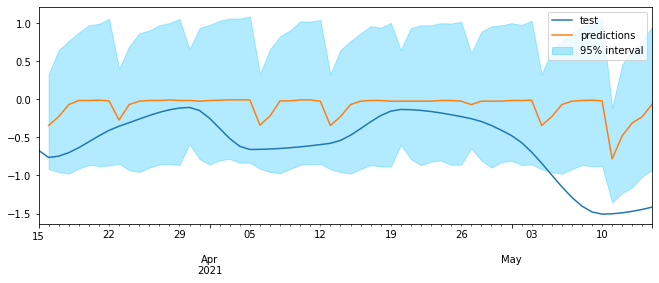

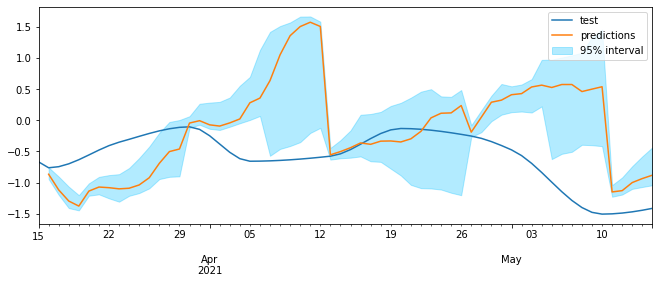

In [ ]:
mae_lgbm_refit_v2 = np.zeros(len(steps))

# Multivariate without refit
for i, step in enumerate(steps):
    mae_lgbm_refit_v2[i] = evaluate_forecasting(data_virgen_de_begoña_norm,data_test,forecaster,False,target,exogenous_var,step,
                                           lags_grid,param_grid,False,end_validation)

In [ ]:
mae_lgbm_bench_refit_v2

array([0.10883921, 0.27471743, 0.48026272, 0.71236431])

In [ ]:
mae_lgbm_refit_v2

array([0.13632632, 0.34978071, 0.49612702, 0.73185869])

#### SVR without contiguous CI

In [ ]:
forecaster = ForecasterAutoreg(
                regressor = SVR(),
                lags = 24
             )

param_grid = {
        'kernel': ('linear','poly'),
        'C':[1e-4,1e-2,1e-1],
        'gamma': [1e-4,1e-2,1e-1],
        'epsilon':[0.001,0.01,0.1]
        }

# Lags used as predictors
lags_grid = [5, 10, 15, [5, 10, 15], [5, 10, 20, 30], [5, 10, 15, 20, 25, 30]]

Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:07<00:00,  1.19s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'C': 0.1, 'epsilon': 0.01, 'gamma': 0.1, 'kernel': 'linear'}
  Backtesting metric: 0.1358675933352313

Backtest error: 0.036260849114861535
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:03<00:00,  1.66it/s]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'C': 0.1, 'epsilon': 0.1, 'gamma': 0.1, 'kernel': 'linear'}
  Backtesting metric: 0.3309195471133438

Backtest error: 0.19633035767769913
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:03<00:00,  1.90it/s]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'C': 0.01, 'epsilon': 0.01, 'gamma': 0.1, 'kernel': 'linear'}
  Backtesting metric: 0.5701964006857364

Backtest error: 0.20216632891261999
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:03<00:00,  1.97it/s]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'C': 0.1, 'epsilon': 0.1, 'gamma': 0.1, 'kernel': 'linear'}
  Backtesting metric: 0.5274831674312607

Backtest error: 0.3706923117307302


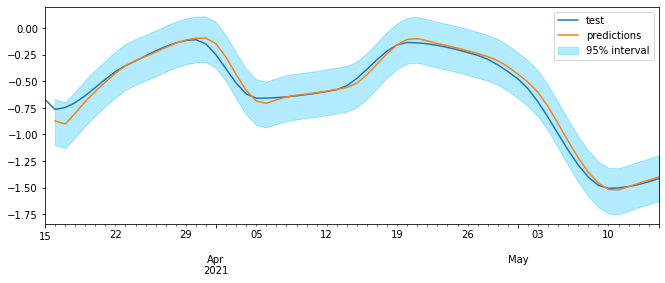

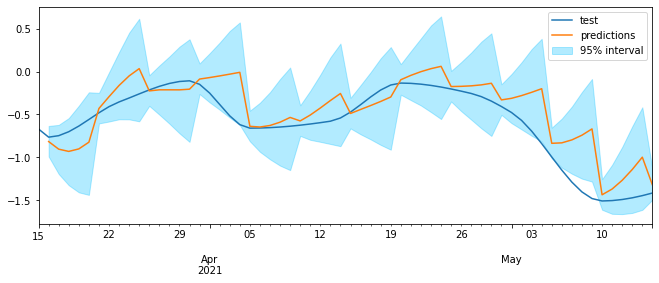

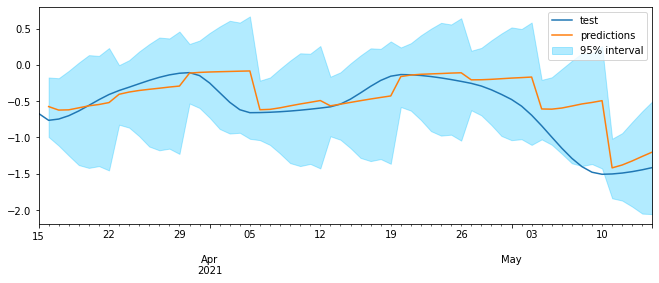

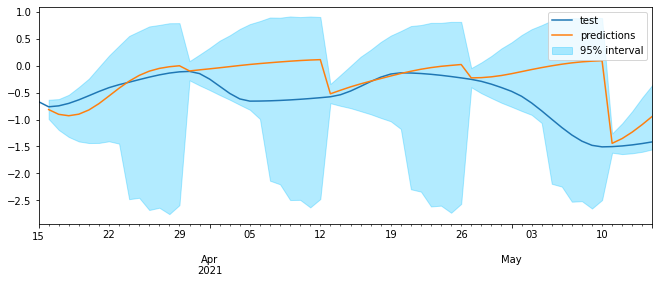

In [ ]:
#Array to store results
mae_svm_bench_v2 = np.zeros(len(steps))

# Univariate without refit
for i, step in enumerate(steps):
    mae_svm_bench_v2[i] = evaluate_forecasting(data_virgen_de_begoña_norm,data_test,forecaster,True,target,exogenous_var,step,
                                           lags_grid,param_grid,False,end_validation)

Number of models compared: 324


loop param_grid: 100%|████████████████████████████████████| 54/54 [00:03<00:00, 17.68it/s]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:18<00:00,  3.11s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'C': 0.1, 'epsilon': 0.01, 'gamma': 0.0001, 'kernel': 'linear'}
  Backtesting metric: 0.14832071936715366

Backtest error: 0.04987762902354902
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:06<00:00,  1.04s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'C': 0.1, 'epsilon': 0.1, 'gamma': 0.1, 'kernel': 'linear'}
  Backtesting metric: 0.3097934330631679

Backtest error: 0.14326134239089458
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:05<00:00,  1.16it/s]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'C': 0.1, 'epsilon': 0.1, 'gamma': 0.1, 'kernel': 'linear'}
  Backtesting metric: 0.5408132720283462

Backtest error: 0.16608644870896574
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:04<00:00,  1.47it/s]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'C': 0.1, 'epsilon': 0.001, 'gamma': 0.1, 'kernel': 'linear'}
  Backtesting metric: 0.4506510703557251

Backtest error: 0.34726135276259895


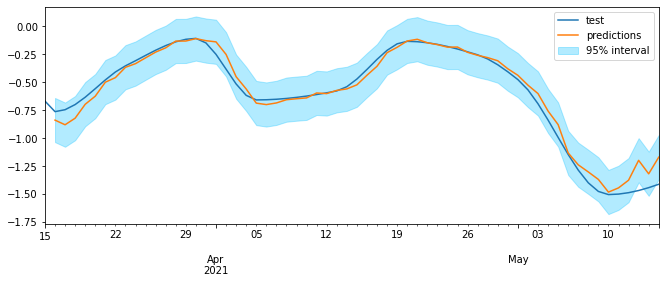

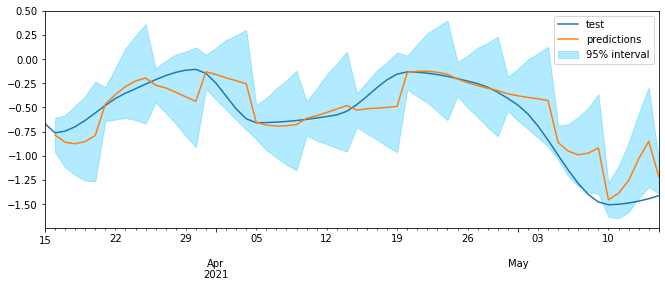

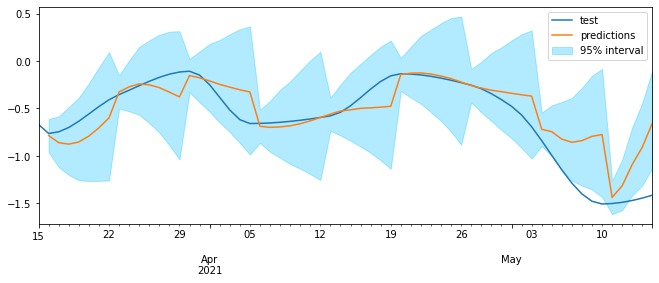

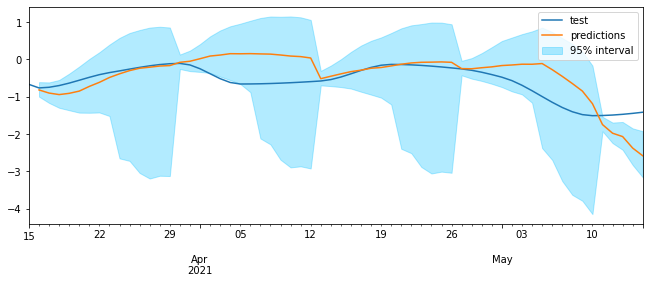

In [ ]:
#Array to store results
mae_svm_v2 = np.zeros(len(steps))

# Univariate without refit
for i, step in enumerate(steps):
    mae_svm_v2[i] = evaluate_forecasting(data_virgen_de_begoña_norm,data_test,forecaster,False,target,exogenous_var,step,
                                           lags_grid,param_grid,False,end_validation)

In [ ]:
mae_svm_bench_v2

array([0.03626085, 0.19633036, 0.20216633, 0.37069231])

In [ ]:
mae_svm_v2

array([0.04987763, 0.14326134, 0.16608645, 0.34726135])

Number of models compared: 324


loop param_grid:   7%|██▋                                  | 4/54 [00:00<00:06,  7.89it/s]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:42<00:00,  7.14s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'C': 0.1, 'epsilon': 0.01, 'gamma': 0.01, 'kernel': 'linear'}
  Backtesting metric: 0.13085104535020817

Forecaster will be fit 61 times. This can take substantial amounts of time. If not feasible, try with `refit = False`. 

Backtest error: 0.04030461359268063
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:10<00:00,  1.67s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'C': 0.1, 'epsilon': 0.1, 'gamma': 0.0001, 'kernel': 'linear'}
  Backtesting metric: 0.3253534850759028

Backtest error: 0.19240083209362183
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:07<00:00,  1.17s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'C': 0.01, 'epsilon': 0.1, 'gamma': 0.0001, 'kernel': 'linear'}
  Backtesting metric: 0.575935924990804

Backtest error: 0.1905050308455673
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:04<00:00,  1.48it/s]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'C': 0.01, 'epsilon': 0.001, 'gamma': 0.1, 'kernel': 'linear'}
  Backtesting metric: 0.5223610317659501

Backtest error: 0.33640582873418234


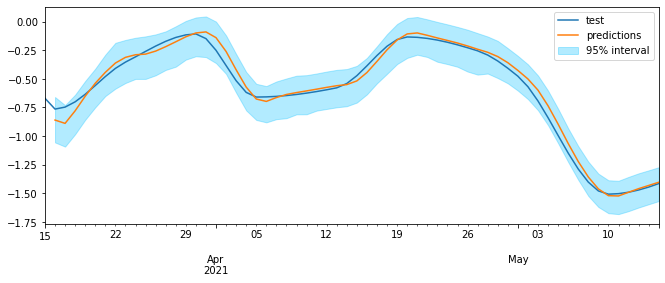

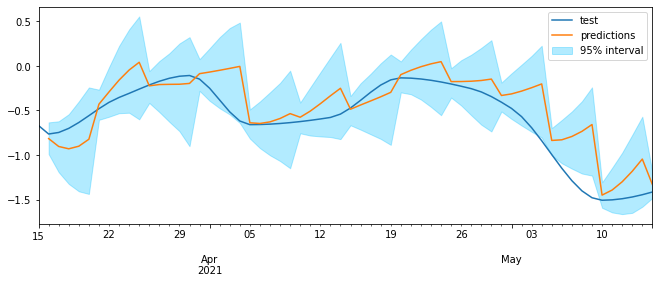

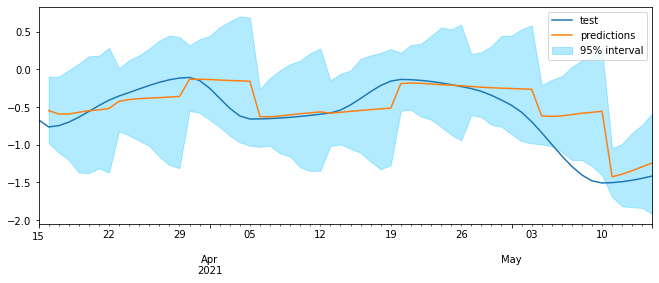

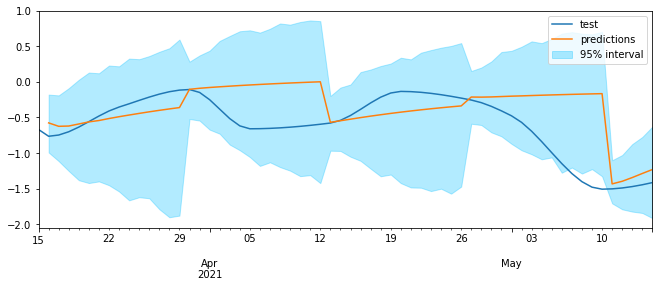

In [ ]:
#Array to store results
mae_svm_bench_refit_v2 = np.zeros(len(steps))

# Univariate without refit
for i, step in enumerate(steps):
    mae_svm_bench_refit_v2[i] = evaluate_forecasting(data_virgen_de_begoña_norm,data_test,forecaster,True,target,exogenous_var,step,
                                           lags_grid,param_grid,True,end_validation)

Number of models compared: 324


loop param_grid:   7%|██▋                                  | 4/54 [00:00<00:09,  5.48it/s]


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [01:03<00:00, 10.61s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5] 
  Parameters: {'C': 0.1, 'epsilon': 0.001, 'gamma': 0.0001, 'kernel': 'linear'}
  Backtesting metric: 0.14572860706060003

Forecaster will be fit 61 times. This can take substantial amounts of time. If not feasible, try with `refit = False`. 

Backtest error: 0.04079693598112037
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:14<00:00,  2.46s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'C': 0.1, 'epsilon': 0.01, 'gamma': 0.1, 'kernel': 'linear'}
  Backtesting metric: 0.33157111373080694

Backtest error: 0.17125610704927338
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:10<00:00,  1.79s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10] 
  Parameters: {'C': 0.1, 'epsilon': 0.1, 'gamma': 0.1, 'kernel': 'poly'}
  Backtesting metric: 0.537939976533695

Backtest error: 3.690280456494357
Number of models compared: 324


loop lags_grid: 100%|███████████████████████████████████████| 6/6 [00:06<00:00,  1.00s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15] 
  Parameters: {'C': 0.1, 'epsilon': 0.01, 'gamma': 0.1, 'kernel': 'linear'}
  Backtesting metric: 0.4551108413563079

Backtest error: 0.3078954027669235


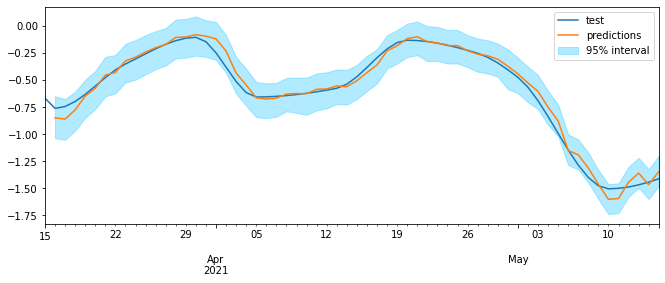

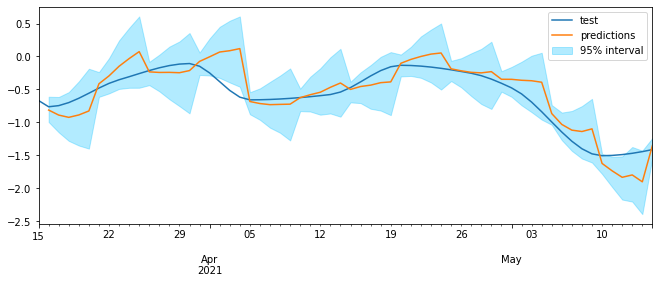

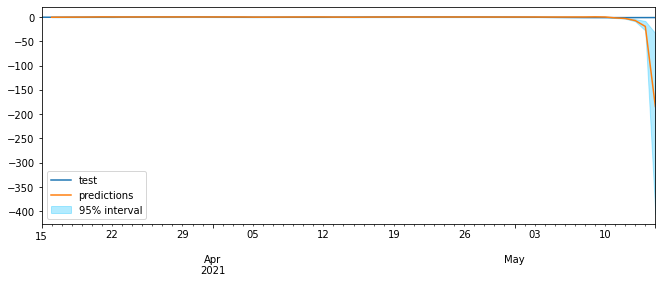

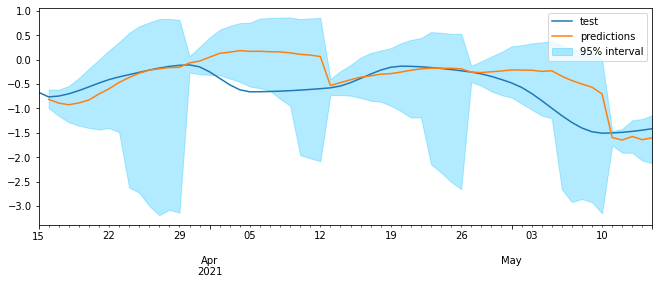

In [ ]:
#Array to store results
mae_svm_refit_v2 = np.zeros(len(steps))

# Univariate without refit
for i, step in enumerate(steps):
    mae_svm_refit_v2[i] = evaluate_forecasting(data_virgen_de_begoña_norm,data_test,forecaster,False,target,exogenous_var,step,
                                           lags_grid,param_grid,True,end_validation)

In [ ]:
mae_svm_bench_refit_v2

array([0.04030461, 0.19240083, 0.19050503, 0.33640583])

In [ ]:
mae_svm_refit_v2

array([0.04079694, 0.17125611, 3.69028046, 0.3078954 ])